In [1]:
import tensorflow as tf
import os
import numpy as np
import matplotlib.pyplot as plt
import time
import cv2
from tensorflow.keras import layers
from keras.models import Model, Sequential
from tensorflow.keras.applications import VGG19
from keras.layers import Dense, Conv2D, Flatten, BatchNormalization, LeakyReLU
from keras.layers import Conv2DTranspose, Dropout, ReLU, Input, Concatenate, ZeroPadding2D
from keras.optimizers import Adam
from keras.utils import plot_model
# from tensorflow.keras.preprocessing.image import ImageDataGenerator
import tensorflow_addons as tfa

/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.24.3
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"
/opt/conda/lib/python3.10/site-packages/tensorflow_addons/utils/tfa_eol_msg.py:23: UserWarning: 

TensorFlow Addons (TFA) has ended development and introduction of new features.
TFA has entered a minimal maintenance and release mode until a planned end of life in May 2024.
Please modify downstream libraries to take dependencies from other repositories in our TensorFlow community (e.g. Keras, Keras-CV, and Keras-NLP). 

For more information see: https://github.com/tensorflow/addons/issues/2807 

  warnings.warn(


In [2]:
import tensorflow as tf

physical_devices = tf.config.list_physical_devices('GPU')
if len(physical_devices) == 0:
    print("No GPU devices found. Make sure your GPU is properly installed and configured.")
else:
    tf.config.experimental.set_memory_growth(physical_devices[0], True)
    print("GPU configured successfully.")

GPU configured successfully.


In [3]:
import tensorflow as tf

# Check available GPUs
gpus = tf.config.experimental.list_physical_devices('GPU')
if gpus:
    # Restrict TensorFlow to only allocate GPU memory growth
    try:
        tf.config.experimental.set_memory_growth(gpus[0], True)
        print("GPU memory growth set to True")
    except RuntimeError as e:
        print(e)

GPU memory growth set to True


In [4]:
import tensorflow as tf

# Check if TensorFlow can access GPU
num_gpus = len(tf.config.experimental.list_physical_devices('GPU'))

if num_gpus > 0:
    print("Num GPUs Available: ", num_gpus)
    print("TensorFlow is using GPU.")
else:
    print("No GPU available. TensorFlow is using CPU.")

Num GPUs Available:  1
TensorFlow is using GPU.


In [5]:
def load(image_file):
    image = tf.io.read_file(image_file)
    image = tf.image.decode_jpeg(image, channels=3)
    image = tf.cast(image,tf.float32)
    return image

In [6]:
path = "/kaggle/input/monumentimagenotaugmented"
x = load(os.path.join(path, 'train/monumentimage_10000.jpg'))
print(x.shape)

(1365, 2048, 3)


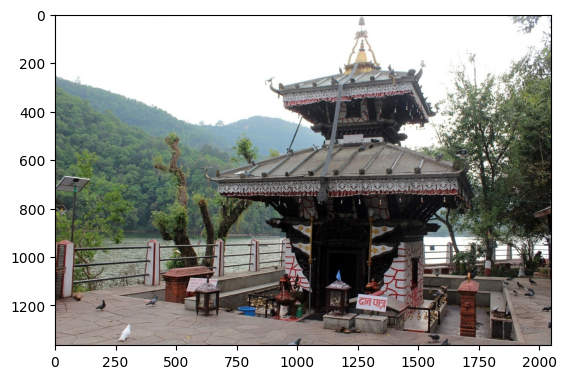

In [7]:
plt.imshow(x/255.0)

In [8]:
def normalize(real_image):
    real_image = (real_image / 255)
    return real_image

In [9]:
def random_crop(real_image):
    cropped_image = tf.image.random_crop(real_image, size = [256, 256, 3])
    return cropped_image

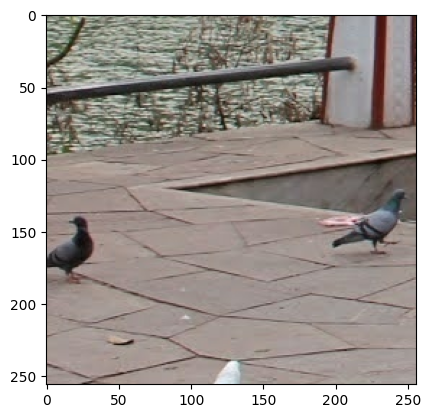

In [10]:
x_aug = random_crop(x)
plt.imshow(x_aug/255.0)

In [11]:
def resize(real_image):
    real_image = tf.image.resize(real_image, [256, 256], method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)
    return real_image

In [12]:
def rotate_image(image, angles, interpolation='BILINEAR'):
    """
    Rotate an image tensor by specified angles.

    Args:
    - image: Input image tensor with shape (batch_size, height, width, channels).
    - angles: Tensor of rotation angles in radians for each image in the batch.
    - interpolation: Interpolation method ('BILINEAR' or 'NEAREST').

    Returns:
    - Rotated image tensor.
    """
    batch_size, height, width, channels = tf.unstack(tf.shape(image))

    # Coordinates of the center of the image
    center_x = tf.cast(width, tf.float32) / 2.0
    center_y = tf.cast(height, tf.float32) / 2.0

    # Define transformation matrix
    rotation_matrix = tf.reshape(tf.stack([tf.cos(angles), -tf.sin(angles), center_x * (1 - tf.cos(angles)) + center_y * tf.sin(angles),
                                           tf.sin(angles), tf.cos(angles), -center_x * tf.sin(angles) + center_y * (1 - tf.cos(angles)),
                                           0.0, 0.0, 1.0], axis=1), shape=(-1, 3, 3))

    # Apply rotation to each pixel
    rotated_image = tfa.image.transform(image, rotation_matrix, interpolation)

    return rotated_image


In [13]:
def random_jitter(real_image):
    if tf.random.uniform(()) > 0.5:
        real_image = tf.image.flip_left_right(real_image)
    return real_image

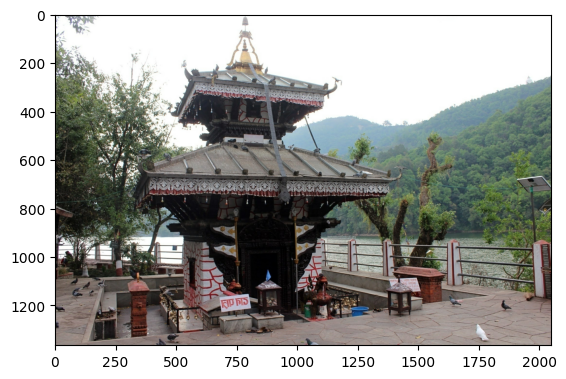

In [14]:
x_jitter = random_jitter(x)
plt.imshow(x_jitter/255.0)

In [15]:
def resize_with_aspect_ratio(image, constant_size):
        # Get image dimensions
        height, width = tf.shape(image)[0], tf.shape(image)[1]

        # Calculate aspect ratio
        aspect_ratio = tf.cast(width, tf.float32) / tf.cast(height, tf.float32)

        # Determine new dimensions based on constant size
        new_height = tf.cond(aspect_ratio >= 1.0,
                             lambda: constant_size,
                             lambda: tf.cast(constant_size / aspect_ratio, tf.int32))
        new_width = tf.cond(aspect_ratio >= 1.0,
                            lambda: tf.cast(constant_size * aspect_ratio, tf.int32),
                            lambda: constant_size)

        # Resize the image
        resized_image = tf.image.resize(image, [new_height, new_width])

        return resized_image

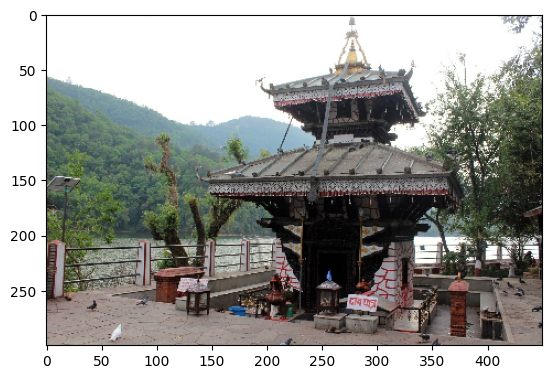

In [16]:
plt.imshow(resize_with_aspect_ratio(x,300)/255)

In [17]:
def load_train_images(image_path):
    real_image = load(image_path)
    real_image = resize_with_aspect_ratio(real_image, 500)
#     real_image = tf.image.resize(real_image, [256, 256], method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)
    real_image = tf.image.random_brightness(real_image, 0.2)
    real_image = random_crop(real_image)
    # Define the rotation angle in radians
    rotation_angle = tf.constant(20.0 * (3.141592653589793 / 180.0), dtype=tf.float32)

    # Apply the rotation using tfa.image.rotate
    real_image = tfa.image.rotate(real_image, angles=rotation_angle)

#     # Example usage
#     angles = tf.placeholder(dtype=tf.float32, shape=(None,))
#     # Specify the rotation range in degrees
#     rotation_range = 15  # Adjust this value as needed
#     # Convert the rotation range to radians
#     rotation_range_rad = rotation_range * (np.pi / 180.0)
#     # Generate random rotation angles for each image in the batch
#     random_angles = tf.random.uniform(shape=(tf.shape(image)[0],), minval=-rotation_range_rad, maxval=rotation_range_rad)
#     # Apply custom rotation to the image with bilinear interpolation
#     real_image = rotate_image(real_image, random_angles, interpolation='BILINEAR')
    #     real_image = rotate(real_image)
    real_image = random_jitter(real_image)
    real_image = normalize(real_image)
    yuv_image = tf.image.rgb_to_yuv(real_image)
    # Separate LAB into L and AB components
    Y_channel = tf.expand_dims(yuv_image[:, :, 0], axis=-1)  # L channel
    UV_channels = yuv_image[:, :, 1:]  # AB channels
    #here L_channel becomes input i.e light/luminance of pixel and AB_channels become target
    return Y_channel, real_image

In [18]:
def load_test_image(image_path):
    real_image = load(image_path)
    real_image = resize_with_aspect_ratio(real_image, 256)
#     real_image = tf.image.resize(real_image, [256, 256], method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)
#     real_image = tf.image.random_brightness(real_image, 0.2)
    real_image = random_crop(real_image)
    real_image = normalize(real_image)
    yuv_image = tf.image.rgb_to_yuv(real_image)
    # Separate LAB into L and AB components
    Y_channel = tf.expand_dims(yuv_image[:, :, 0], axis=-1)  # L channel
    UV_channels = yuv_image[:, :, 1:]  # AB channels
    #here L_channel becomes input i.e light/luminance of pixel and AB_channels become target
    return Y_channel, real_image

In [19]:
IMAGE_SIZE = 256
BATCH_SIZE = 16

In [20]:
# create input pipeline
train_dataset = tf.data.Dataset.list_files(path + "/train/*")
train_dataset = train_dataset.map(load_train_images)
train_dataset = train_dataset.shuffle(10).batch(BATCH_SIZE)
train_dataset

<_BatchDataset element_spec=(TensorSpec(shape=(None, 256, 256, 1), dtype=tf.float32, name=None), TensorSpec(shape=(None, 256, 256, 3), dtype=tf.float32, name=None))>

In [21]:
validation_dataset = tf.data.Dataset.list_files(path + '/val/*')
validation_dataset = validation_dataset.map(load_test_image)
validation_dataset = validation_dataset.batch(BATCH_SIZE)
validation_dataset

<_BatchDataset element_spec=(TensorSpec(shape=(None, 256, 256, 1), dtype=tf.float32, name=None), TensorSpec(shape=(None, 256, 256, 3), dtype=tf.float32, name=None))>

In [22]:
# test_dataset = tf.data.Dataset.list_files(path + 'test/*.jpg')
# test_dataset = test_dataset.map(load_test_image)
# test_dataset = test_dataset.batch(1)
# test_dataset

In [23]:
# downsample block
def downsample(filters, size,dropout=False, batchnorm = True):
    init = tf.random_normal_initializer(0.,0.02)
    result = Sequential()
    result.add(Conv2D(filters, size, strides = 2, padding = "same", kernel_initializer = init, use_bias = False))
    if batchnorm == True:
        result.add(BatchNormalization())
    if dropout == True :
        result.add(Dropout(0.3))
    result.add(LeakyReLU())
    return result
down_model = downsample(3,4)
down_result = down_model(tf.expand_dims(x, axis = 0))
print(down_result.shape)

(1, 683, 1024, 3)


In [24]:
# upsample block
def upsample(filters, size, dropout = False):
    init = tf.random_normal_initializer(0, 0.02)
    result = Sequential()
    result.add(Conv2DTranspose(filters, size, strides = 2, padding = "same", kernel_initializer = init, use_bias = False))
    result.add(BatchNormalization())
    if dropout == True:
        result.add(Dropout(0.3))
    result.add(ReLU())
    return result
up_model = upsample(3,4)
up_result = up_model(down_result)
print(up_result.shape)

(1, 1366, 2048, 3)


In [25]:
def generator(input_shape = (256,256,1), output_channels = 2):
    inputs = Input(shape = input_shape)
    down_stack = [
        downsample(32, 4, batchnorm=False),
        downsample(64, 4),
        downsample(128, 4),
        downsample(256, 4, dropout = True),
        downsample(512, 4, dropout = True)
    ]


    up_stack = [
        upsample(512, 4, dropout=True),
        upsample(256, 4, dropout=True),
        upsample(128, 4, dropout=True),
        upsample(64, 4),
        upsample(32, 4),
    ]
    init = tf.random_normal_initializer(0., 0.02)
    last = Conv2DTranspose(3, 4, strides = 2, padding = "same", kernel_initializer = init, activation ="tanh")
    x = inputs
    skips = []
    for down in down_stack:
        x = down(x)
        skips.append(x)
    skips = reversed(skips[:-1])

    for up, skip in zip(up_stack, skips):
        x = up(x)
        x = Concatenate()([x, skip])

    x = last(x)
    return Model(inputs = inputs, outputs = x)

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 256, 256, 1)]        0         []                            
                                                                                                  
 sequential_2 (Sequential)   (None, 128, 128, 32)         512       ['input_1[0][0]']             
                                                                                                  
 sequential_3 (Sequential)   (None, 64, 64, 64)           33024     ['sequential_2[0][0]']        
                                                                                                  
 sequential_4 (Sequential)   (None, 32, 32, 128)          131584    ['sequential_3[0][0]']        
                                                                                              

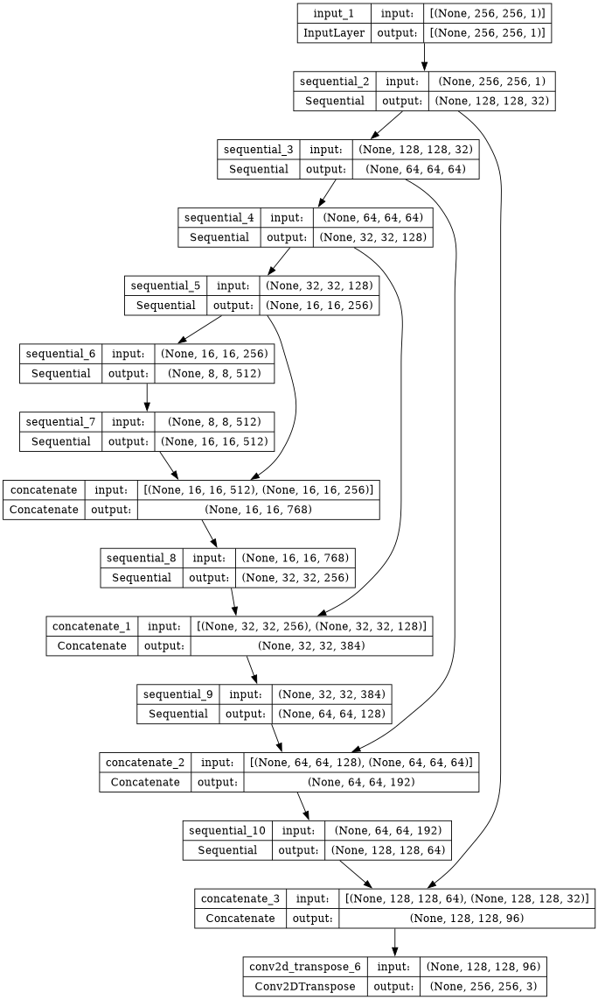

In [26]:
gen = generator()
gen.summary()
plot_model(gen, show_shapes=True, dpi = 64)

In [27]:
# gen.load_weights('/kaggle/input/imagenetmodelweights/gen_weight.keras')

In [28]:
def discriminator():
    init = tf.random_normal_initializer(0., 0.02)

    inp = Input(shape = [IMAGE_SIZE, IMAGE_SIZE, 1], name = "input_image")
    tar = Input(shape = [IMAGE_SIZE, IMAGE_SIZE, 3], name = "target_image")
    x = Concatenate()([inp, tar])
    down1 = downsample(64,4,False)(x)
    down2 = downsample(128, 4)(down1)
    down3 = downsample(256, 4)(down2)

    zero_pad1 = ZeroPadding2D()(down3)
    conv = Conv2D(256, 4, strides = 1, kernel_initializer = init, use_bias = False)(zero_pad1)
    leaky_relu = LeakyReLU()(conv)
    zero_pad2 = ZeroPadding2D()(leaky_relu)
    last = Conv2D(1, 4, strides = 1, kernel_initializer=init)(zero_pad2)
    return Model(inputs = [inp, tar], outputs = last)

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_image (InputLayer)    [(None, 256, 256, 1)]        0         []                            
                                                                                                  
 target_image (InputLayer)   [(None, 256, 256, 3)]        0         []                            
                                                                                                  
 concatenate_4 (Concatenate  (None, 256, 256, 4)          0         ['input_image[0][0]',         
 )                                                                   'target_image[0][0]']        
                                                                                                  
 sequential_12 (Sequential)  (None, 128, 128, 64)         4352      ['concatenate_4[0][0]'] 

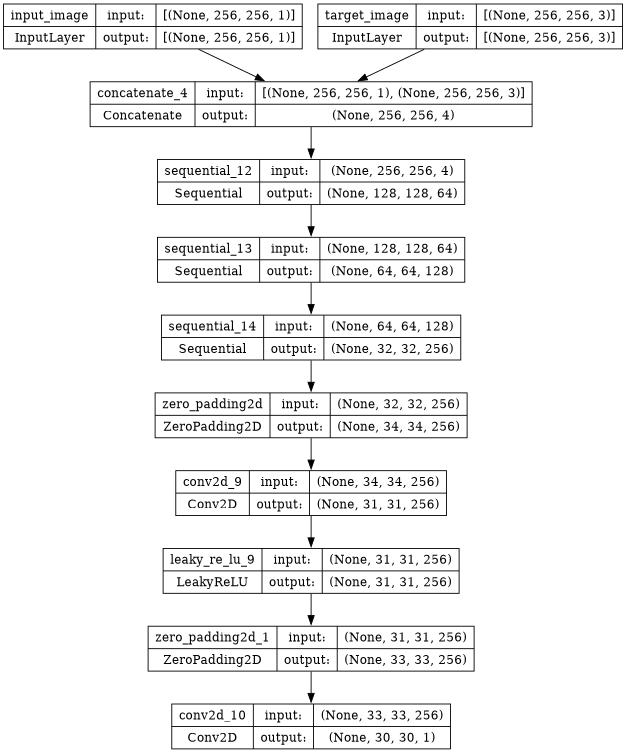

In [29]:
disc = discriminator()
disc.summary()
plot_model(disc, show_shapes=True, dpi = 64)

In [30]:
# disc.load_weights('/kaggle/input/imagenetmodelweights/disc_weight.keras')

In [31]:
# Function to create YUV image from Y, U, and V channels and then convert to rgb
def create_rgb_image(y_channel, uv_channel):
    # Assuming YUV format where Y, U, and V channels are separate
    # y_channel = np.array(y_channel)
    # uv_channel = np.array(uv_channel)
    u_channel, v_channel = tf.split(uv_channel, num_or_size_splits=2, axis=-1)

    # Combine Y, U, and V channels into a YUV image
    rgb_image = tf.image.yuv_to_rgb(tf.concat([y_channel, u_channel, v_channel], axis=-1))
    return rgb_image


In [32]:
LAMBDA = 150

In [33]:
# Define the perceptual loss function
def perceptual_loss(y_true, y_pred):
    vgg = VGG19(include_top=False, weights='imagenet', input_shape=(None, None, 3))
    vgg.trainable = False
    for layer in vgg.layers:
        layer.trainable = False
    model = Model(inputs=vgg.input, outputs=vgg.get_layer('block5_conv4').output)
    model.trainable = False

    y_true_features = model(y_true)
    y_pred_features = model(y_pred)

    return tf.reduce_mean(tf.square(y_true_features - y_pred_features))

In [34]:
def generator_loss(disc_generated_output,input_, gen_output, target):
    gan_loss = loss_function(tf.ones_like(disc_generated_output), disc_generated_output)
    l1_loss = tf.reduce_mean(tf.abs(target - gen_output))
    p_loss = perceptual_loss(gen_output, target)
    total_gen_loss = gan_loss + (LAMBDA * l1_loss) + 150*p_loss
    return total_gen_loss, gan_loss, l1_loss, p_loss

In [35]:
from keras.losses import BinaryCrossentropy
loss_function = BinaryCrossentropy(from_logits=True)

In [36]:
def discriminator_loss(disc_real_output, disc_generated_output):
    real_loss = loss_function(tf.ones_like(disc_real_output), disc_real_output)
    generated_loss = loss_function(tf.zeros_like(disc_generated_output), disc_generated_output)
    total_disc_loss = real_loss + generated_loss
    return total_disc_loss, real_loss, generated_loss

In [37]:
generator_optimizer = Adam(lr= 2e-4, beta_1=0.5)
discriminator_optimizer = Adam(lr = 2e-4, beta_1=0.5)

In [38]:
epochs = 250

In [39]:
# import tensorflow as tf
# from tensorflow.keras.applications import VGG19
# from tensorflow.keras.models import Model

# # Load the VGG19 model
# vgg = VGG19(weights='imagenet', include_top=False)

# # Select the layers you want to use for the LPIPS score
# selected_layers = ['block1_conv1', 'block2_conv1', 'block3_conv1']

# # Create a model that outputs the selected layers
# outputs = [vgg.get_layer(name).output for name in selected_layers]
# model = Model(inputs=vgg.input, outputs=outputs)

# # Make sure the VGG model is not trainable
# model.trainable = False

# def lpips_score(image1, image2):
#     # Get the features for both images
#     image1_features = model(image1)
#     image2_features = model(image2)

#     # Initialize the score
#     score = 0

#     # For each feature layer...
#     for f1, f2 in zip(image1_features, image2_features):
#         # ... compute the mean squared error between the features
#         mse = tf.reduce_mean((f1 - f2)**2)
#         # ... and add it to the score
#         score += mse

#     return score

In [40]:
# from tensorflow.keras.applications.inception_v3 import InceptionV3
# from scipy.linalg import sqrtm

# # Load the pre-trained InceptionV3 model (weights will be downloaded if not present)
# pretrained_model = InceptionV3(weights='imagenet', include_top=True, pooling='avg')

# # Optionally, you can freeze the layers to prevent training
# for layer in pretrained_model.layers:
#     layer.trainable = False


# # Create a new model to extract features from an intermediate layer
# inception_model = tf.keras.Model(inputs=pretrained_model.input, outputs=pretrained_model.get_layer('avg_pool').input)
# def calculate_fid_score(images1, images2, inception_model):
#     # Ensure the batch dimension is removed for individual image predictions
#     images1 = np.squeeze(images1, axis=0)
#     images2 = np.squeeze(images2, axis=0)
    
#     # Resize images to the required size for the Inception model
#     images1 = tf.image.resize(images1, size=(299, 299))
#     images2 = tf.image.resize(images2, size=(299, 299))
    
#     # Extract features using the Inception model
#     features1 = inception_model.predict(np.expand_dims(images1, axis=0))
#     features2 = inception_model.predict(np.expand_dims(images2, axis=0))

#     # Remove batch dimension from features
#     features1 = np.squeeze(features1, axis=0)
#     features2 = np.squeeze(features2, axis=0)
#     #print(features1.shape)
#     # Calculate mean and covariance of feature representations
#     mean1 = np.mean(features1, axis=(0, 1, 2))
#     mean2 = np.mean(features2, axis=(0, 1, 2))
#     #print(features1.shape)
#     cov1 = np.cov(features1.transpose(2, 0, 1).reshape(features1.shape[-1], -1), rowvar=False)
#     cov2 = np.cov(features2.transpose(2, 0, 1).reshape(features2.shape[-1], -1), rowvar=False)
#     #print(cov2.shape)

#     # Calculate the squared Euclidean distance between means
#     sum_squared_diff = np.sum((mean1 - mean2)**2)

#     # Calculate the trace of the product of covariances
#     cov_sqrt = sqrtm(np.dot(cov1, cov2))
#     trace_cov_product = np.trace(cov1 + cov2 - 2 * cov_sqrt)

#     # Calculate FID score
#     fid_score = np.real(sum_squared_diff + trace_cov_product)
    
#     return fid_score

In [41]:
@tf.function
def train_step(input_image, target, epoch, training_discriminator):
    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        gen_output = gen(input_image, training=True)
        disc_real_output = disc([input_image, target], training=True)
        disc_generated_output = disc([input_image, gen_output], training=True)
        gen_total_loss, gen_gan_loss, gen_l1_loss, gen_p_loss = generator_loss(disc_generated_output,input_image, gen_output, target)
        disc_loss, disc_real_loss, disc_generated_loss = discriminator_loss(disc_real_output, disc_generated_output)
#         rgb_target = create_rgb_image(input_image, target)
#         rgb_generated = create_rgb_image(input_image, gen_output)
        ssim_values = tf.image.ssim(target, gen_output, max_val=1.0)
        psnr_values = tf.image.psnr(target, gen_output, max_val=1.0)
#         lpips_values = lpips_score(rgb_target, rgb_generated)

        if epoch > 8:
            if training_discriminator:
                discriminator_gradients = disc_tape.gradient(disc_loss, disc.trainable_variables)
                discriminator_optimizer.apply_gradients(zip(discriminator_gradients, disc.trainable_variables))
            else:
                generator_gradients = gen_tape.gradient(gen_total_loss, gen.trainable_variables)
                generator_optimizer.apply_gradients(zip(generator_gradients, gen.trainable_variables))
        else:
            generator_gradients = gen_tape.gradient(gen_total_loss, gen.trainable_variables)
            discriminator_gradients = disc_tape.gradient(disc_loss, disc.trainable_variables)
            generator_optimizer.apply_gradients(zip(generator_gradients, gen.trainable_variables))
            discriminator_optimizer.apply_gradients(zip(discriminator_gradients, disc.trainable_variables))

        return gen_total_loss, gen_gan_loss, gen_l1_loss,gen_p_loss, disc_loss,disc_real_loss, disc_generated_loss, ssim_values, psnr_values, tf.constant([0])

In [42]:
@tf.function
def validation_step(input_image, target):
    # Generate output using the generator
    gen_output = gen(input_image)

    # Calculate losses without updating gradients
    disc_real_output = disc([input_image, target])
    disc_generated_output = disc([input_image, gen_output])

    gen_total_loss, gen_gan_loss, gen_l1_loss, gen_p_loss = generator_loss(disc_generated_output,input_image, gen_output, target)
    disc_loss,disc_real_loss, disc_generated_loss = discriminator_loss(disc_real_output, disc_generated_output)
#     rgb_target = create_rgb_image(input_image, target)
#     rgb_generated = create_rgb_image(input_image, gen_output)
    ssim_values = tf.image.ssim(target, gen_output, max_val=1.0)
    psnr_values = tf.image.psnr(target, gen_output, max_val=1.0)
#     lpips_values = lpips_score(rgb_target, rgb_generated)
    #accuracy = calculate_accuracy(disc_generated_output, disc_real_output)
    return gen_total_loss, gen_gan_loss, gen_l1_loss,gen_p_loss, disc_loss,disc_real_loss, disc_generated_loss, ssim_values, psnr_values, tf.constant([0])

In [43]:
# @tf.function
# def test_step(input_image, target):
#     # Generate output using the generator
#     gen_output = gen(input_image)

#     # Calculate losses without updating gradients
#     disc_real_output = disc([input_image, target])
#     disc_generated_output = disc([input_image, gen_output])

#     gen_total_loss, gen_gan_loss, gen_l1_loss, gen_p_loss = generator_loss(disc_generated_output,input_image, gen_output, target)
#     disc_loss,disc_real_loss, disc_generated_loss = discriminator_loss(disc_real_output, disc_generated_output)
#     rgb_target = create_rgb_image(input_image, target)
#     rgb_generated = create_rgb_image(input_image, gen_output)
#     ssim_values = tf.image.ssim(rgb_target, rgb_generated, max_val=1.0)
#     psnr_values = tf.image.psnr(rgb_target, rgb_generated, max_val=1.0)
#     lpips_values = lpips_score(rgb_target, rgb_generated)
#     fid_values = calculate_fid_score(rgb_target, rgb_generated, inception_model)
#     #accuracy = calculate_accuracy(disc_generated_output, disc_real_output)
#     return gen_total_loss, gen_gan_loss, gen_l1_loss,gen_p_loss, disc_loss,disc_real_loss, disc_generated_loss, ssim_values, psnr_values, lpips_values, fid_values


In [44]:
os.mkdir('/kaggle/working/gen_output/')

In [45]:
def display_one_random_test_image(input_, target, gen_model, epoch):
    print("Displaying one random test image...")
    img_array = np.array(input_)
    generated_output_test = gen_model(input_)
    ssim = tf.image.ssim(generated_output_test,target, max_val=1.0)
    psnr = tf.image.psnr(generated_output_test,target, max_val=1.0)  
#     lpips = lpips_score(tf.reshape(create_rgb_image(input_, target), (1,256,256,3)), tf.reshape(create_rgb_image(input_,generated_output_test), (1,256,256,3)))
#     p_loss = perceptual_loss(create_rgb_image(input_, target), create_rgb_image(input_, generated_output_test))
#     fid_score = calculate_fid_score(tf.reshape(create_rgb_image(input_, target), (1,256,256,3)), tf.reshape(create_rgb_image(input_,generated_output_test), (1,256,256,3)), inception_model)
    # print(input_.shape)
    input_ = np.squeeze(input_, axis=0)
    # print(type(input_), type(target))
    # print(input_.shape, input_)
    # input_.reshape((256,256))
    plt.figure(figsize=(16, 16))
    plt.subplot(1, 4, 1)
    plt.title('Input Testing Image')
    plt.imshow(input_, cmap='gray', vmax = 1, vmin = 0)  # Assuming images are normalized to [0, 1]
    plt.axis('off')
    # # print(target.shape)
    target = np.squeeze(target, axis=0)
    # # print(target.shape)
#     target_img = create_rgb_image(input_, target).numpy()
    # # print(type(target_img))
    # target
    # # print(target_img.shape, target_img)
    plt.subplot(1, 4, 2)
    plt.title('Target Testing Image')
    plt.imshow(target)  # Assuming images are normalized to [0, 1]
    plt.axis('off')
    # # Convert PIL Image to NumPy array
    # img_array = np.array(input_)
    # # Add batch dimension
    # # print(img_array.shape)
    # img_array = np.expand_dims(img_array, axis=0)
    # # print(img_array.shape)
    # generated_output_test = gen_model(img_array)
    # # print(generated_output_test.shape)
    # # Squeeze the singleton dimension
    generated_output_test = np.squeeze(generated_output_test, axis=0)
    # # print(generated_output_test.shape)
#     generated_img = create_rgb_image(input_, generated_output_test).numpy()
    # # print(generated_img.shape, generated_img)
    plt.subplot(1, 4, 3)
    plt.title(f'Generated Output -- epoch {epoch}')
    plt.imshow(generated_output_test)  # Assuming images are normalized to [-1, 1]
    plt.axis('off')
    plt.savefig(f'/kaggle/working/gen_output/epoch_{epoch}.png')
    plt.show()
    print('SSIM Score: {}'.format(ssim))
    print('PSNR Score: {}'.format(psnr))
#     print('LPIPS Score: {}'.format(lpips))
#     print('Perceptual Loss: {}'.format(p_loss))
#     print('FID Score: {}'.format(fid_score))

In [46]:
def display_random_test_image(gen_model, image_path, epoch):
    
    real_image = load(image_path)
    real_image = resize(real_image)
    real_image = normalize(real_image)
    yuv_image = tf.image.rgb_to_yuv(real_image)
    # Separate LAB into L and AB components
    Y_channel = tf.expand_dims(yuv_image[:, :, 0], axis=-1)  # L channel
    UV_channels = yuv_image[:, :, 1:] 

    # Display the image
    display_one_random_test_image(tf.reshape(Y_channel, (1,256,256,1)),tf.reshape(real_image,(1,256,256,3)), gen_model, epoch)


Displaying one random test image...


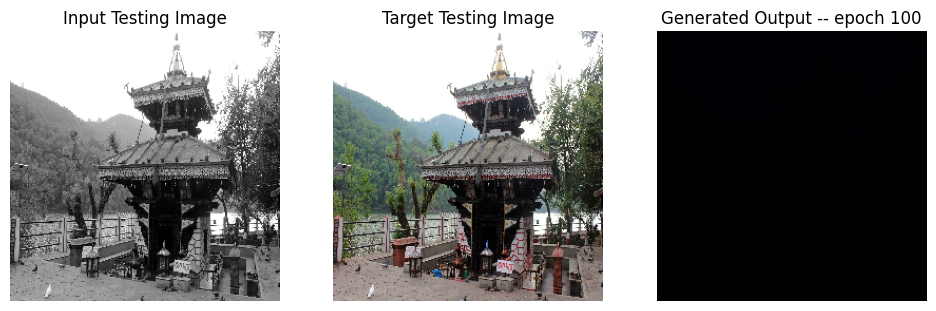

SSIM Score: [0.00066924]
PSNR Score: [4.1482143]


In [47]:
display_random_test_image(gen, '/kaggle/input/monumentimagenotaugmented/train/monumentimage_10000.jpg',100)

In [48]:
import random

each_epoch_train_generator_losses = []
each_epoch_train_generator_gan_losses = []
each_epoch_train_generator_l1_losses = []
each_epoch_train_generator_l2_losses = []
each_epoch_train_generator_perceptual_losses = []
each_epoch_train_discriminator_losses = []
each_epoch_train_discriminator_real_losses = []
each_epoch_train_discriminator_generated_losses = []
each_epoch_train_ssim = []
each_epoch_train_psnr = []
each_epoch_train_lpips = []
each_epoch_test_lpips = []
each_epoch_test_psnr = []
each_epoch_test_ssim = []
each_epoch_test_generator_losses = []
each_epoch_test_generator_gan_losses = []
each_epoch_test_generator_l1_losses = []
each_epoch_test_generator_l2_losses = []
each_epoch_test_generator_perceptual_losses = []
each_epoch_test_discriminator_losses = []
each_epoch_test_discriminator_real_losses = []
each_epoch_test_discriminator_generated_losses = []
train_generator_losses = []
train_generator_gan_losses = []
train_generator_l1_losses = []
train_generator_l2_losses = []
train_generator_perceptual_losses = []
train_discriminator_losses = []
train_discriminator_real_losses = []
train_discriminator_generated_losses = []
test_generator_losses = []
test_generator_gan_losses = []
test_generator_l1_losses = []
test_generator_l2_losses = []
test_generator_perceptual_losses = []
test_discriminator_losses = []
test_discriminator_real_losses = []
test_discriminator_generated_losses =[]
training_ssim = []
training_psnr = []
training_lpips = []
testing_ssim = []
testing_psnr = []
testing_lpips = []
each_epoch_all_records = []
all_records = []
def fit(train_ds, epochs, test_ds, gen_model):

    # Declare global lists
    global each_epoch_train_generator_losses, each_epoch_train_generator_gan_losses, each_epoch_train_generator_l1_losses, each_epoch_train_generator_l2_losses, each_epoch_train_generator_perceptual_losses, each_epoch_train_discriminator_losses,each_epoch_train_discriminator_real_losses, each_epoch_train_discriminator_generated_losses, each_epoch_train_ssim, each_epoch_train_psnr
    global each_epoch_test_psnr, each_epoch_test_ssim, each_epoch_test_generator_losses, each_epoch_test_generator_gan_losses, each_epoch_test_generator_l1_losses, each_epoch_test_generator_l2_losses, each_epoch_test_generator_perceptual_losses, each_epoch_test_discriminator_losses, each_epoch_test_discriminator_real_losses, each_epoch_test_discriminator_generated_losses
    global train_generator_losses, train_generator_gan_losses, train_generator_l1_losses, train_generator_l2_losses, train_generator_perceptual_losses, train_discriminator_losses, train_discriminator_real_losses, train_discriminator_generated_losses, test_generator_losses, test_generator_l2_losses, test_generator_gan_losses, test_generator_l1_losses, test_generator_perceptual_losses, test_discriminator_losses, test_discriminator_real_losses, test_discriminator_generated_losses
    global training_ssim, training_psnr, testing_ssim, testing_psnr, each_epoch_all_records, all_records, LAMBDA, each_epoch_train_lpips, each_epoch_test_lpips, training_lpips, testing_lpips


    # Initialize counters and flags
    consecutive_epochs_high_loss = 0
    training_discriminator = True
    stop_training = False
    min_learning_rate = 1e-7  # Set your desired minimum learning rate
    time_start = time.time()
    
    for ep in range(epochs):
        epoch = ep 
        start = time.time()
        train_count = 0
        test_count = 0

        print(f"Epoch {epoch}")

        for n, (input_, target) in train_ds.enumerate():
            if epoch > 10:
                train_gen_loss, train_gen_gan_loss, train_gen_l1_loss,train_gen_perceptual_loss, train_disc_loss, train_disc_real_loss, train_disc_generated_loss, train_ssim, train_psnr, train_lpips = train_step(input_, target, epoch, training_discriminator=training_discriminator)

            else:
                # If epoch is less than or equal to 10, train both generator and discriminator
                train_gen_loss, train_gen_gan_loss, train_gen_l1_loss, train_gen_perceptual_loss, train_disc_loss, train_disc_real_loss, train_disc_generated_loss, train_ssim, train_psnr, train_lpips  = train_step(input_, target, epoch, training_discriminator=None)

            each_epoch_train_generator_losses.append(train_gen_loss)
            each_epoch_train_generator_gan_losses.append(train_gen_gan_loss)
            each_epoch_train_generator_l1_losses.append(train_gen_l1_loss)
#             each_epoch_train_generator_l2_losses.append(train_gen_l2_loss)
            each_epoch_train_generator_perceptual_losses.append(train_gen_perceptual_loss)
            each_epoch_train_discriminator_losses.append(train_disc_loss)
            each_epoch_train_discriminator_real_losses.append(train_disc_real_loss)
            each_epoch_train_discriminator_generated_losses.append(train_disc_generated_loss)
            each_epoch_train_ssim.append(tf.reduce_mean(train_ssim.numpy()))
            each_epoch_train_psnr.append(tf.reduce_mean(train_psnr.numpy()))
            each_epoch_train_lpips.append(tf.reduce_mean(train_lpips.numpy()))
#             print(train_count)
            train_count += 1
#             print(n)
        #each_epoch_train_generator_losses = np.array(each_epoch_train_generator_losses)
        #print(each_epoch_train_discriminator_losses.shape())
        #print(each_epoch_train_generator_losses.shape())
        #print(each_epoch_train_ssim())
        print("Training Details")
        print("Generator-- total_loss:{:.5f} gan_loss:{:.5f} l1_loss:{:.5f} perceptual_loss:{:.5f} Discriminator-- total_loss:{:.5f} real_loss:{:.5f} generated_loss:{:.5f} --- SSIM {:.5f} PSNR {:.5f} LPIPS {:.5f}".format(np.mean(each_epoch_train_generator_losses),np.mean(each_epoch_train_generator_gan_losses), np.mean(each_epoch_train_generator_l1_losses),np.mean(each_epoch_train_generator_perceptual_losses), np.mean(each_epoch_train_discriminator_losses), np.mean(each_epoch_train_discriminator_generated_losses), np.mean(each_epoch_train_discriminator_real_losses), np.mean(each_epoch_train_ssim), np.mean(each_epoch_train_psnr), np.mean(each_epoch_train_lpips)))
        print("Time taken for epoch {} is {} sec".format(epoch + 1, time.time() - start))
        print(f"Number of iteration {train_count}")

        train_generator_losses.append(np.mean(each_epoch_train_generator_losses))
        train_generator_gan_losses.append(np.mean(each_epoch_train_generator_gan_losses))
        train_generator_l1_losses.append(np.mean(each_epoch_train_generator_l1_losses))
#         train_generator_l2_losses.append(np.mean(each_epoch_train_generator_l2_losses))
        train_generator_perceptual_losses.append(np.mean(each_epoch_train_generator_perceptual_losses))
        train_discriminator_losses.append(np.mean(each_epoch_train_discriminator_losses))
        train_discriminator_real_losses.append(np.mean(each_epoch_train_discriminator_real_losses))
        train_discriminator_generated_losses.append(np.mean(each_epoch_train_discriminator_generated_losses))
        training_ssim.append(np.mean(each_epoch_train_ssim))
        training_psnr.append(np.mean(each_epoch_train_psnr))
        training_lpips.append(np.mean(each_epoch_train_lpips))

        # Test
        for n, (input_, target) in test_ds.enumerate():
            test_gen_loss, test_gen_gan_loss, test_gen_l1_loss, test_gen_perceptual_loss, test_disc_loss, test_disc_real_loss, test_disc_generated_loss, test_ssim, test_psnr, test_lpips = validation_step(input_, target)
            test_count += 1

            each_epoch_test_generator_losses.append(test_gen_loss)
            each_epoch_test_generator_gan_losses.append(test_gen_gan_loss)
            each_epoch_test_generator_l1_losses.append(test_gen_l1_loss)
#             each_epoch_test_generator_l2_losses.append(test_gen_l2_loss)
            each_epoch_test_generator_perceptual_losses.append(test_gen_perceptual_loss)
            each_epoch_test_discriminator_losses.append(test_disc_loss)
            each_epoch_test_discriminator_real_losses.append(test_disc_real_loss)
            each_epoch_test_discriminator_generated_losses.append(test_disc_generated_loss)
            each_epoch_test_ssim.append(tf.reduce_mean(test_ssim.numpy()))
            each_epoch_test_psnr.append(tf.reduce_mean(test_psnr.numpy()))
            each_epoch_test_lpips.append(tf.reduce_mean(test_lpips.numpy()))
    
        print("Validation Details")
        print("Generator-- total_loss:{:.5f} gan_loss:{:.5f} l1_loss:{:.5f}  perceptual_loss:{:.5f} Discriminator-- total_loss:{:.5f} real_loss:{:.5f} generated_loss:{:.5f} --- SSIM {:.5f} PSNR {:.5f} LPIPS {:.5f}".format(np.mean(each_epoch_test_generator_losses),np.mean(each_epoch_test_generator_gan_losses), np.mean(each_epoch_test_generator_l1_losses), np.mean(each_epoch_test_generator_perceptual_losses),np.mean(each_epoch_test_discriminator_losses), np.mean(each_epoch_test_discriminator_generated_losses), np.mean(each_epoch_test_discriminator_real_losses), np.mean(each_epoch_test_ssim), np.mean(each_epoch_test_psnr), np.mean(each_epoch_test_lpips)))
        print("Time taken for epoch {} is {} sec".format(epoch+1, time.time() - start))
        print(f"Number of iteration {test_count}")
#         LAMBDA = LAMBDA * 1.006
        test_generator_losses.append(np.mean(each_epoch_test_generator_losses))
        test_generator_gan_losses.append(np.mean(each_epoch_test_generator_gan_losses))
        test_generator_l1_losses.append(np.mean(each_epoch_test_generator_l1_losses))
#         test_generator_l2_losses.append(np.mean(each_epoch_test_generator_l2_losses))
        test_generator_perceptual_losses.append(np.mean(each_epoch_test_generator_perceptual_losses))
        test_discriminator_losses.append(np.mean(each_epoch_test_discriminator_losses))
        test_discriminator_real_losses.append(np.mean(each_epoch_test_discriminator_real_losses))
        test_discriminator_generated_losses.append(np.mean(each_epoch_test_discriminator_generated_losses))
        testing_ssim.append(np.mean(each_epoch_test_ssim))
        testing_psnr.append(np.mean(each_epoch_test_psnr))
        testing_lpips.append(np.mean(each_epoch_test_lpips))

        each_epoch_all_records.append([np.mean(each_epoch_train_generator_losses),np.mean(each_epoch_train_generator_gan_losses), np.mean(each_epoch_train_generator_l1_losses),np.mean(each_epoch_train_generator_perceptual_losses), np.mean(each_epoch_train_discriminator_losses), np.mean(each_epoch_train_discriminator_generated_losses), np.mean(each_epoch_train_discriminator_real_losses), np.mean(each_epoch_train_ssim), np.mean(each_epoch_train_psnr), np.mean(each_epoch_test_generator_losses),np.mean(each_epoch_test_generator_gan_losses), np.mean(each_epoch_test_generator_l1_losses),np.mean(each_epoch_test_generator_perceptual_losses),np.mean(each_epoch_test_discriminator_losses), np.mean(each_epoch_test_discriminator_generated_losses), np.mean(each_epoch_test_discriminator_real_losses), np.mean(each_epoch_test_ssim), np.mean(each_epoch_test_psnr)])
        all_records.append(each_epoch_all_records)
        # emptying for next epoch
        each_epoch_test_ssim = []
        each_epoch_test_generator_losses = []
        each_epoch_test_generator_gan_losses = []
        each_epoch_test_generator_l1_losses = []
#         each_epoch_test_generator_l2_losses = []
        each_epoch_test_generator_perceptual_losses = []
        each_epoch_test_discriminator_losses = []
        each_epoch_test_discriminator_real_losses = []
        each_epoch_test_discriminator_generated_losses = []
        each_epoch_test_psnr = []
        each_epoch_test_lpips = []
        each_epoch_all_records = []
        #emptyling list for next iteration
        each_epoch_train_generator_losses = []
        each_epoch_train_generator_gan_losses = []
        each_epoch_train_generator_l1_losses = []
#         each_epoch_train_generator_l2_losses = []
        each_epoch_train_generator_perceptual_losses = []
        each_epoch_train_discriminator_losses = []
        each_epoch_train_discriminator_real_losses = []
        each_epoch_train_discriminator_generated_losses = []
        each_epoch_train_ssim = []
        each_epoch_train_psnr = []
        each_epoch_train_lpips = []
        if time.time() - time_start > 41000:
            stop_training = True
#         if epoch == 0 or epoch % 3 == 0:
            # Function to display one random test image
            # def display_random_test_image(images, labels, gen_model):
            #     # Randomly select an index
            #     random_test_image_idx = random.randint(0, len(images) - 1)

            #     # Extract input and target from the selected index
            #     random_test_input = images[random_test_image_idx]
            #     random_test_target = labels[random_test_image_idx]

            #     # Display the image
            #     display_one_random_test_image(random_test_input, random_test_target, gen_model)

            # Example usage
        display_random_test_image(gen, '/kaggle/input/monumentimagenotaugmented/val/monumentimage_10204.jpg', epoch+1)
        # Check if the difference between two consecutive epochs for the last 5 epochs is less than 1
        if ep > 10:
            # Check 1f the difference between two consecutive epochs for the last S epochs is less than 1 or 0.3
            last_epochs_losses = train_discriminator_losses[-5:] if training_discriminator else train_generator_losses[-5:]
            if all(((last_epochs_losses[i] - last_epochs_losses[i - 1])) < 0.01 if training_discriminator else ((last_epochs_losses[1] - last_epochs_losses[i - 1])) < 0.05 for i in range(1, 5)):
                consecutive_epochs_high_loss += 1
            else:
                consecutive_epochs_high_loss = 0
        
        
#         LAMBDA = LAMBDA*1.003
            # If the condition is met for 4 consecutive epochs, reduce the learning rate
        if consecutive_epochs_high_loss == 4:
            if training_discriminator:
                current_lr = generator_optimizer. learning_rate.numpy()
                new_lr = max (current_lr * 0.45, min_learning_rate)
                if new_lr > min_learning_rate:
                    generator_optimizer.learning_rate.assign(new_lr)
                    print (f"Reduced generator learning rate to {new_lr} at epoch {epoch + 1}")
                    # Switch training focus
                    training_discriminator = not training_discriminator
                else:
                    print(f"Generator learning rate already at the minimum. Stopping training.")
                    stop_training = True
            else:
                current_lr = discriminator_optimizer.learning_rate.numpy()
                new_lr = max (current_lr * 0.3, min_learning_rate)
                if new_lr > min_learning_rate:
                    discriminator_optimizer.learning_rate.assign(new_lr)
                    print(f"Reduced discriminator learning rate to {new_lr} at epoch {epoch + 1}.")
                    # Switch training focus
                    training_discriminator = not training_discriminator
                else:
                    print(f"Discriminator learning rate already at the minimum. Stopping training.")
                    stop_training = True

                consecutive_epochs_high_loss = 0
        # Check the flag variable
        if stop_training:
            break

In [49]:
tf.config.run_functions_eagerly(True)

Epoch 0
80134624/80134624 [==============================] - 0s 0us/step
Training Details
Generator-- total_loss:13.13097 gan_loss:1.11194 l1_loss:0.06680 perceptual_loss:0.01333 Discriminator-- total_loss:1.30691 real_loss:0.63568 generated_loss:0.67123 --- SSIM 0.75880 PSNR 21.17520 LPIPS 0.00000
Time taken for epoch 1 is 636.805349111557 sec
Number of iteration 525
Validation Details
Generator-- total_loss:18.57832 gan_loss:0.60070 l1_loss:0.10231  perceptual_loss:0.01754 Discriminator-- total_loss:1.96706 real_loss:0.94265 generated_loss:1.02441 --- SSIM 0.75956 PSNR 17.85789 LPIPS 0.00000
Time taken for epoch 1 is 685.1920306682587 sec
Number of iteration 70
Displaying one random test image...


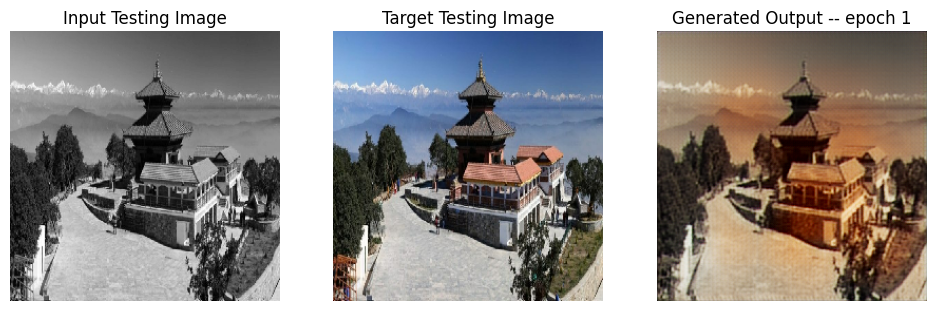

SSIM Score: [0.76748174]
PSNR Score: [15.790257]
Epoch 1
Training Details
Generator-- total_loss:10.50161 gan_loss:1.06734 l1_loss:0.05528 perceptual_loss:0.00761 Discriminator-- total_loss:1.42835 real_loss:0.71031 generated_loss:0.71804 --- SSIM 0.87291 PSNR 22.53305 LPIPS 0.00000
Time taken for epoch 2 is 625.7838332653046 sec
Number of iteration 525
Validation Details
Generator-- total_loss:30.87509 gan_loss:6.82419 l1_loss:0.14421  perceptual_loss:0.01613 Discriminator-- total_loss:3.22167 real_loss:0.07671 generated_loss:3.14495 --- SSIM 0.71890 PSNR 14.88021 LPIPS 0.00000
Time taken for epoch 2 is 670.7300090789795 sec
Number of iteration 70
Displaying one random test image...


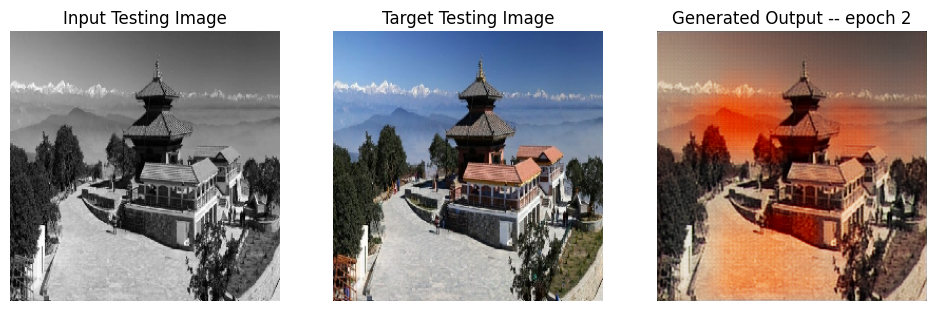

SSIM Score: [0.75162]
PSNR Score: [13.861597]
Epoch 2
Training Details
Generator-- total_loss:10.14036 gan_loss:1.05720 l1_loss:0.05350 perceptual_loss:0.00705 Discriminator-- total_loss:1.19281 real_loss:0.57821 generated_loss:0.61460 --- SSIM 0.89542 PSNR 22.78889 LPIPS 0.00000
Time taken for epoch 3 is 622.5209138393402 sec
Number of iteration 525
Validation Details
Generator-- total_loss:13.42059 gan_loss:0.40533 l1_loss:0.07463  perceptual_loss:0.01214 Discriminator-- total_loss:2.09436 real_loss:1.59992 generated_loss:0.49444 --- SSIM 0.86298 PSNR 20.44883 LPIPS 0.00000
Time taken for epoch 3 is 668.2456965446472 sec
Number of iteration 70
Displaying one random test image...


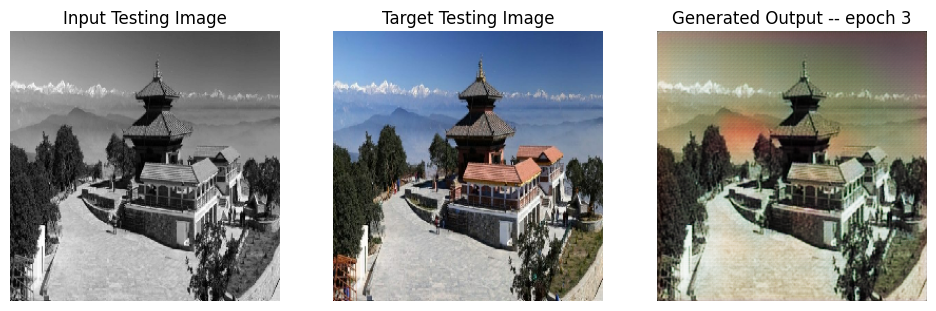

SSIM Score: [0.8617386]
PSNR Score: [18.058027]
Epoch 3
Training Details
Generator-- total_loss:9.95650 gan_loss:1.06880 l1_loss:0.05237 perceptual_loss:0.00688 Discriminator-- total_loss:1.21936 real_loss:0.58990 generated_loss:0.62945 --- SSIM 0.90934 PSNR 22.96446 LPIPS 0.00000
Time taken for epoch 4 is 624.3463997840881 sec
Number of iteration 525
Validation Details
Generator-- total_loss:15.84585 gan_loss:0.51287 l1_loss:0.09050  perceptual_loss:0.01172 Discriminator-- total_loss:1.41874 real_loss:1.04416 generated_loss:0.37457 --- SSIM 0.86951 PSNR 18.14839 LPIPS 0.00000
Time taken for epoch 4 is 669.3138227462769 sec
Number of iteration 70
Displaying one random test image...


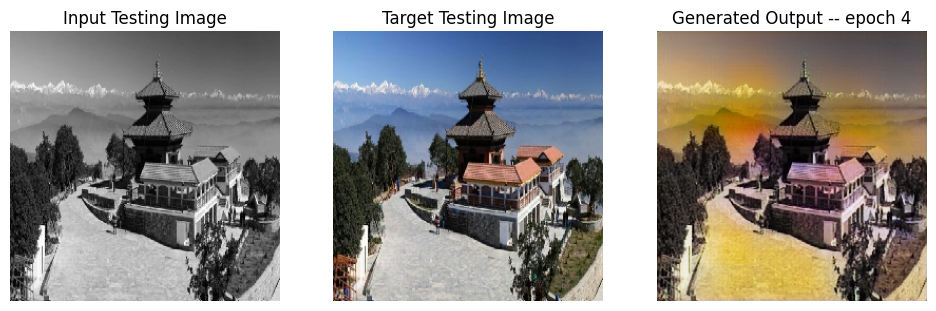

SSIM Score: [0.8653135]
PSNR Score: [14.99134]
Epoch 4
Training Details
Generator-- total_loss:9.84013 gan_loss:1.05470 l1_loss:0.05174 perceptual_loss:0.00683 Discriminator-- total_loss:1.20146 real_loss:0.58027 generated_loss:0.62119 --- SSIM 0.91594 PSNR 23.02395 LPIPS 0.00000
Time taken for epoch 5 is 623.7477927207947 sec
Number of iteration 525
Validation Details
Generator-- total_loss:12.06138 gan_loss:0.24592 l1_loss:0.06796  perceptual_loss:0.01081 Discriminator-- total_loss:2.26505 real_loss:2.02263 generated_loss:0.24242 --- SSIM 0.87327 PSNR 20.94988 LPIPS 0.00000
Time taken for epoch 5 is 668.6634211540222 sec
Number of iteration 70
Displaying one random test image...


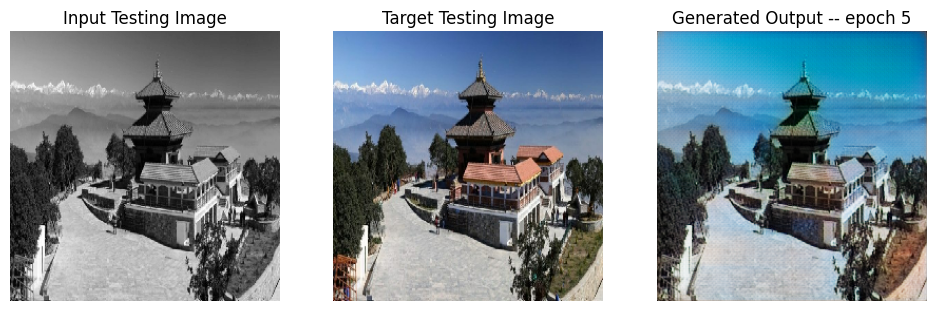

SSIM Score: [0.84454376]
PSNR Score: [19.161118]
Epoch 5
Training Details
Generator-- total_loss:9.57438 gan_loss:1.06147 l1_loss:0.05010 perceptual_loss:0.00665 Discriminator-- total_loss:1.22881 real_loss:0.59803 generated_loss:0.63078 --- SSIM 0.92313 PSNR 23.23426 LPIPS 0.00000
Time taken for epoch 6 is 628.0332114696503 sec
Number of iteration 525
Validation Details
Generator-- total_loss:13.33261 gan_loss:1.79654 l1_loss:0.06577  perceptual_loss:0.01113 Discriminator-- total_loss:1.95052 real_loss:0.26645 generated_loss:1.68407 --- SSIM 0.90546 PSNR 21.51043 LPIPS 0.00000
Time taken for epoch 6 is 673.0776374340057 sec
Number of iteration 70
Displaying one random test image...


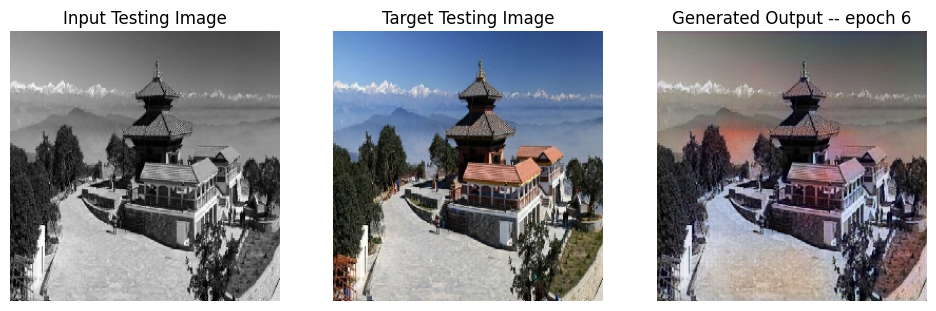

SSIM Score: [0.92494994]
PSNR Score: [19.435411]
Epoch 6
Training Details
Generator-- total_loss:9.52360 gan_loss:1.05999 l1_loss:0.04978 perceptual_loss:0.00664 Discriminator-- total_loss:1.22350 real_loss:0.59529 generated_loss:0.62821 --- SSIM 0.92503 PSNR 23.28385 LPIPS 0.00000
Time taken for epoch 7 is 623.3905820846558 sec
Number of iteration 525
Validation Details
Generator-- total_loss:14.37444 gan_loss:0.73875 l1_loss:0.07968  perceptual_loss:0.01122 Discriminator-- total_loss:1.63962 real_loss:0.74717 generated_loss:0.89245 --- SSIM 0.90332 PSNR 19.80174 LPIPS 0.00000
Time taken for epoch 7 is 668.4671292304993 sec
Number of iteration 70
Displaying one random test image...


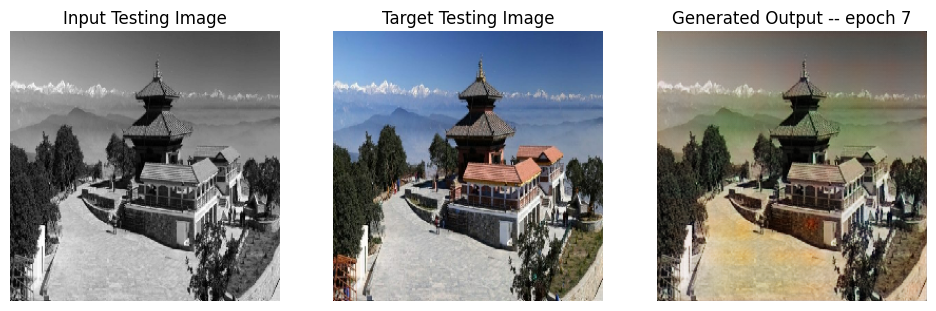

SSIM Score: [0.93188286]
PSNR Score: [18.597576]
Epoch 7
Training Details
Generator-- total_loss:9.25542 gan_loss:1.29724 l1_loss:0.04669 perceptual_loss:0.00636 Discriminator-- total_loss:1.93318 real_loss:0.96681 generated_loss:0.96637 --- SSIM 0.93361 PSNR 23.88277 LPIPS 0.00000
Time taken for epoch 8 is 624.1818273067474 sec
Number of iteration 525
Validation Details
Generator-- total_loss:9.90945 gan_loss:0.67969 l1_loss:0.05253  perceptual_loss:0.00900 Discriminator-- total_loss:1.42402 real_loss:0.86320 generated_loss:0.56083 --- SSIM 0.92908 PSNR 22.99858 LPIPS 0.00000
Time taken for epoch 8 is 669.4410374164581 sec
Number of iteration 70
Displaying one random test image...


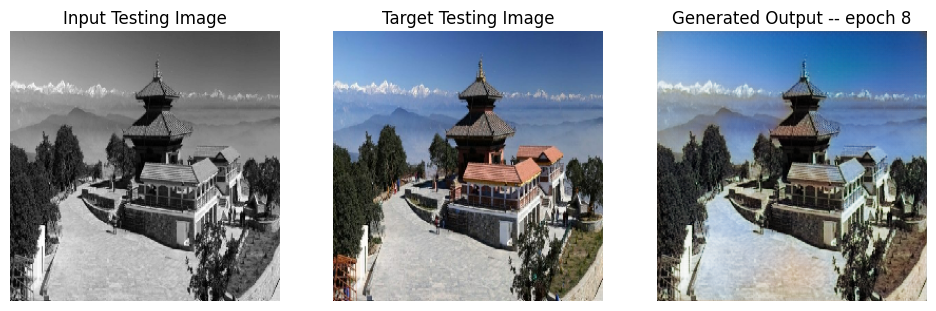

SSIM Score: [0.9459545]
PSNR Score: [24.553654]
Epoch 8
Training Details
Generator-- total_loss:9.05258 gan_loss:0.99033 l1_loss:0.04741 perceptual_loss:0.00634 Discriminator-- total_loss:1.22700 real_loss:0.59516 generated_loss:0.63185 --- SSIM 0.93263 PSNR 23.65990 LPIPS 0.00000
Time taken for epoch 9 is 627.2043571472168 sec
Number of iteration 525
Validation Details
Generator-- total_loss:14.67117 gan_loss:0.42583 l1_loss:0.08219  perceptual_loss:0.01278 Discriminator-- total_loss:2.09374 real_loss:1.63122 generated_loss:0.46252 --- SSIM 0.89006 PSNR 19.26102 LPIPS 0.00000
Time taken for epoch 9 is 673.4355010986328 sec
Number of iteration 70
Displaying one random test image...


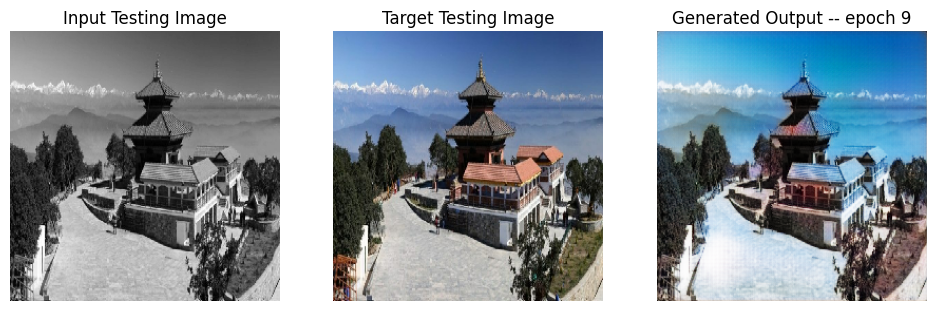

SSIM Score: [0.8923118]
PSNR Score: [18.85247]
Epoch 9
Training Details
Generator-- total_loss:8.62735 gan_loss:1.00346 l1_loss:0.04478 perceptual_loss:0.00605 Discriminator-- total_loss:1.19113 real_loss:0.63326 generated_loss:0.55787 --- SSIM 0.94068 PSNR 24.31409 LPIPS 0.00000
Time taken for epoch 10 is 568.1563920974731 sec
Number of iteration 525
Validation Details
Generator-- total_loss:14.66559 gan_loss:0.53897 l1_loss:0.08419  perceptual_loss:0.00999 Discriminator-- total_loss:1.87552 real_loss:1.13373 generated_loss:0.74179 --- SSIM 0.91565 PSNR 19.22869 LPIPS 0.00000
Time taken for epoch 10 is 614.381331205368 sec
Number of iteration 70
Displaying one random test image...


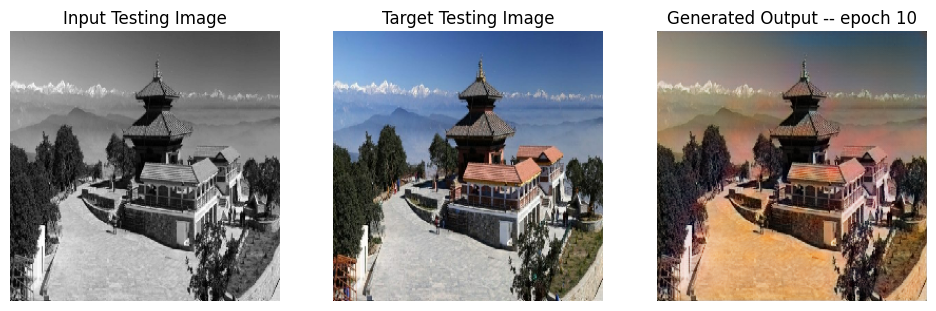

SSIM Score: [0.9238531]
PSNR Score: [17.327135]
Epoch 10
Training Details
Generator-- total_loss:8.51106 gan_loss:0.98421 l1_loss:0.04418 perceptual_loss:0.00600 Discriminator-- total_loss:1.20563 real_loss:0.64000 generated_loss:0.56563 --- SSIM 0.94167 PSNR 24.43362 LPIPS 0.00000
Time taken for epoch 11 is 567.0967869758606 sec
Number of iteration 525
Validation Details
Generator-- total_loss:13.20058 gan_loss:0.36466 l1_loss:0.07555  perceptual_loss:0.01002 Discriminator-- total_loss:2.22735 real_loss:1.53270 generated_loss:0.69466 --- SSIM 0.92556 PSNR 20.72105 LPIPS 0.00000
Time taken for epoch 11 is 612.6769382953644 sec
Number of iteration 70
Displaying one random test image...


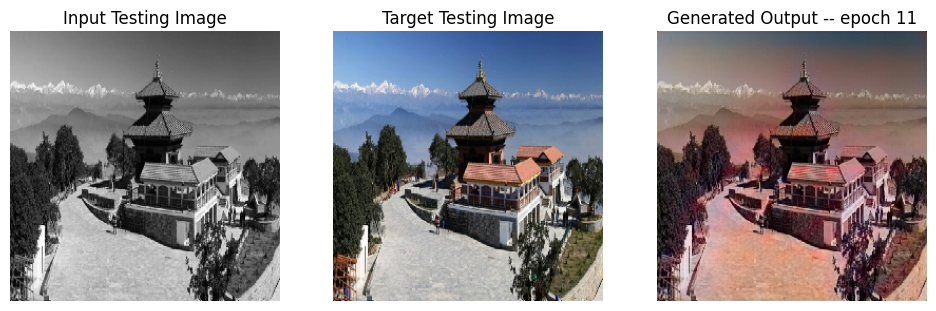

SSIM Score: [0.9227097]
PSNR Score: [17.512863]
Epoch 11
Training Details
Generator-- total_loss:13.45408 gan_loss:5.06512 l1_loss:0.04979 perceptual_loss:0.00614 Discriminator-- total_loss:0.21890 real_loss:0.11002 generated_loss:0.10888 --- SSIM 0.93310 PSNR 23.60730 LPIPS 0.00000
Time taken for epoch 12 is 427.74529814720154 sec
Number of iteration 525
Validation Details
Generator-- total_loss:10.14243 gan_loss:0.21161 l1_loss:0.05744  perceptual_loss:0.00877 Discriminator-- total_loss:2.51723 real_loss:2.39733 generated_loss:0.11991 --- SSIM 0.92825 PSNR 22.65289 LPIPS 0.00000
Time taken for epoch 12 is 474.5261073112488 sec
Number of iteration 70
Displaying one random test image...


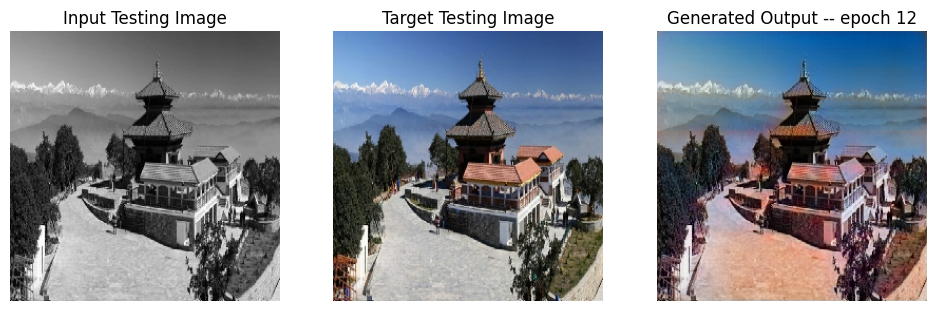

SSIM Score: [0.929775]
PSNR Score: [22.101856]
Epoch 12
Training Details
Generator-- total_loss:15.71474 gan_loss:7.32848 l1_loss:0.04976 perceptual_loss:0.00615 Discriminator-- total_loss:0.08737 real_loss:0.04265 generated_loss:0.04472 --- SSIM 0.93364 PSNR 23.61632 LPIPS 0.00000
Time taken for epoch 13 is 422.7563600540161 sec
Number of iteration 525
Validation Details
Generator-- total_loss:10.20365 gan_loss:0.21204 l1_loss:0.05790  perceptual_loss:0.00871 Discriminator-- total_loss:2.70451 real_loss:2.61115 generated_loss:0.09336 --- SSIM 0.92793 PSNR 22.60499 LPIPS 0.00000
Time taken for epoch 13 is 468.68363094329834 sec
Number of iteration 70
Displaying one random test image...


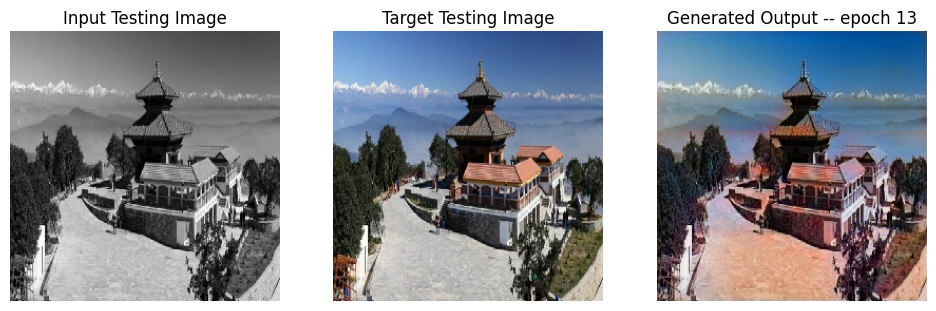

SSIM Score: [0.9287794]
PSNR Score: [21.975285]
Epoch 13
Training Details
Generator-- total_loss:16.34639 gan_loss:7.96274 l1_loss:0.04976 perceptual_loss:0.00613 Discriminator-- total_loss:0.02579 real_loss:0.01276 generated_loss:0.01303 --- SSIM 0.93353 PSNR 23.62528 LPIPS 0.00000
Time taken for epoch 14 is 424.03388476371765 sec
Number of iteration 525
Validation Details
Generator-- total_loss:10.02371 gan_loss:0.04358 l1_loss:0.05775  perceptual_loss:0.00879 Discriminator-- total_loss:4.81384 real_loss:4.77980 generated_loss:0.03403 --- SSIM 0.92826 PSNR 22.62927 LPIPS 0.00000
Time taken for epoch 14 is 469.00839018821716 sec
Number of iteration 70
Displaying one random test image...


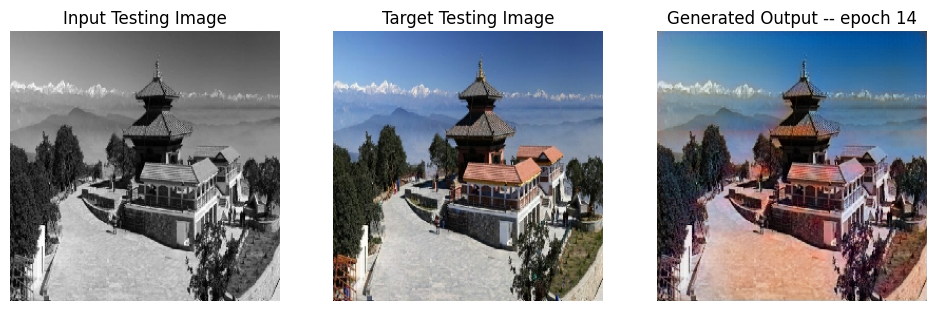

SSIM Score: [0.9301899]
PSNR Score: [22.096819]
Epoch 14
Training Details
Generator-- total_loss:17.29755 gan_loss:8.96860 l1_loss:0.04941 perceptual_loss:0.00612 Discriminator-- total_loss:0.09897 real_loss:0.04808 generated_loss:0.05090 --- SSIM 0.93327 PSNR 23.65439 LPIPS 0.00000
Time taken for epoch 15 is 421.46232557296753 sec
Number of iteration 525
Validation Details
Generator-- total_loss:9.95958 gan_loss:0.06373 l1_loss:0.05720  perceptual_loss:0.00877 Discriminator-- total_loss:4.04271 real_loss:4.01120 generated_loss:0.03152 --- SSIM 0.92832 PSNR 22.69195 LPIPS 0.00000
Time taken for epoch 15 is 466.71337890625 sec
Number of iteration 70
Displaying one random test image...


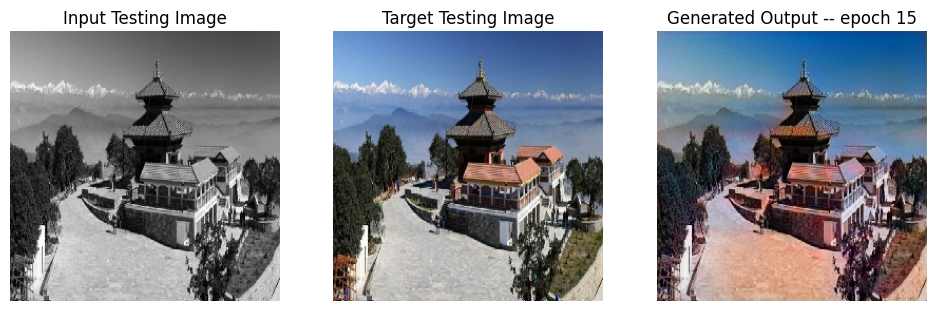

SSIM Score: [0.92990226]
PSNR Score: [22.162815]
Epoch 15
Training Details
Generator-- total_loss:17.98520 gan_loss:9.58628 l1_loss:0.04988 perceptual_loss:0.00611 Discriminator-- total_loss:0.03488 real_loss:0.01647 generated_loss:0.01841 --- SSIM 0.93369 PSNR 23.59159 LPIPS 0.00000
Time taken for epoch 16 is 422.5485854148865 sec
Number of iteration 525
Validation Details
Generator-- total_loss:9.99218 gan_loss:0.03253 l1_loss:0.05760  perceptual_loss:0.00880 Discriminator-- total_loss:5.03627 real_loss:5.00941 generated_loss:0.02685 --- SSIM 0.92801 PSNR 22.63990 LPIPS 0.00000
Time taken for epoch 16 is 467.8483507633209 sec
Number of iteration 70
Displaying one random test image...


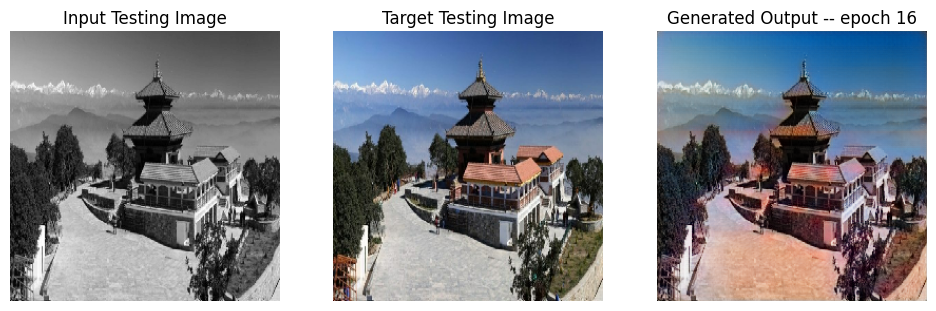

SSIM Score: [0.92959446]
PSNR Score: [22.071487]
Epoch 16
Training Details
Generator-- total_loss:14.17196 gan_loss:5.80501 l1_loss:0.04966 perceptual_loss:0.00612 Discriminator-- total_loss:1.00584 real_loss:0.53294 generated_loss:0.47291 --- SSIM 0.93344 PSNR 23.63585 LPIPS 0.00000
Time taken for epoch 17 is 422.91347646713257 sec
Number of iteration 525
Validation Details
Generator-- total_loss:10.04893 gan_loss:0.06605 l1_loss:0.05775  perceptual_loss:0.00881 Discriminator-- total_loss:3.86625 real_loss:3.83737 generated_loss:0.02887 --- SSIM 0.92818 PSNR 22.63216 LPIPS 0.00000
Time taken for epoch 17 is 467.5026295185089 sec
Number of iteration 70
Displaying one random test image...


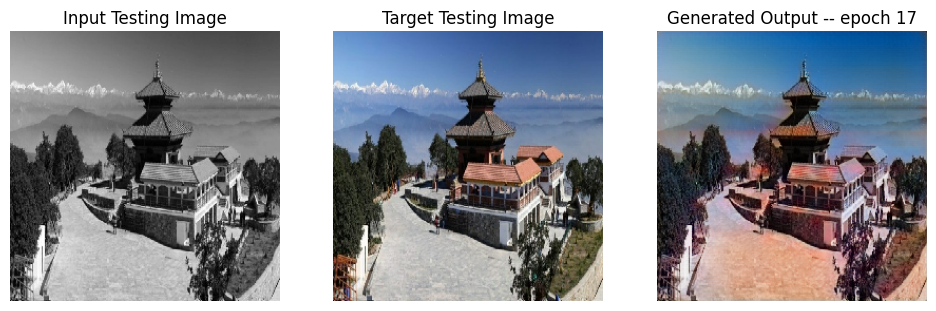

SSIM Score: [0.92945486]
PSNR Score: [22.038948]
Epoch 17
Training Details
Generator-- total_loss:16.46460 gan_loss:8.10453 l1_loss:0.04959 perceptual_loss:0.00614 Discriminator-- total_loss:0.04036 real_loss:0.01767 generated_loss:0.02270 --- SSIM 0.93346 PSNR 23.63411 LPIPS 0.00000
Time taken for epoch 18 is 424.4781160354614 sec
Number of iteration 525
Validation Details
Generator-- total_loss:10.02635 gan_loss:0.10073 l1_loss:0.05744  perceptual_loss:0.00873 Discriminator-- total_loss:3.41176 real_loss:3.33480 generated_loss:0.07696 --- SSIM 0.92828 PSNR 22.66043 LPIPS 0.00000
Time taken for epoch 18 is 469.7343626022339 sec
Number of iteration 70
Displaying one random test image...


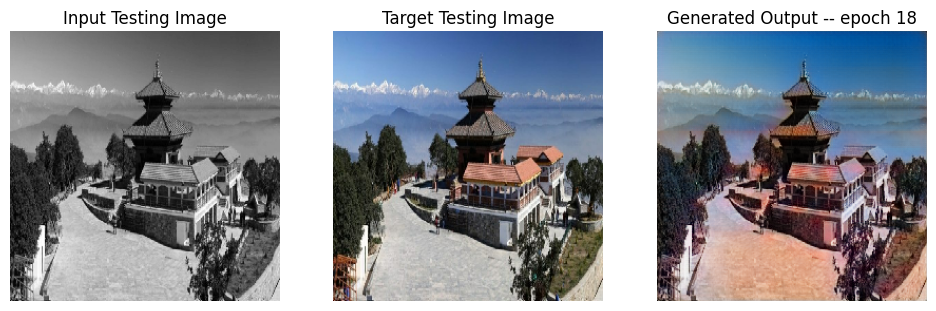

SSIM Score: [0.92891055]
PSNR Score: [22.042908]
Epoch 18
Training Details
Generator-- total_loss:18.17983 gan_loss:9.77878 l1_loss:0.04984 perceptual_loss:0.00616 Discriminator-- total_loss:0.00410 real_loss:0.00196 generated_loss:0.00214 --- SSIM 0.93308 PSNR 23.59575 LPIPS 0.00000
Time taken for epoch 19 is 418.79606461524963 sec
Number of iteration 525
Validation Details
Generator-- total_loss:9.95084 gan_loss:0.02338 l1_loss:0.05744  perceptual_loss:0.00874 Discriminator-- total_loss:4.98410 real_loss:4.95256 generated_loss:0.03154 --- SSIM 0.92831 PSNR 22.65586 LPIPS 0.00000
Time taken for epoch 19 is 463.49566197395325 sec
Number of iteration 70
Displaying one random test image...


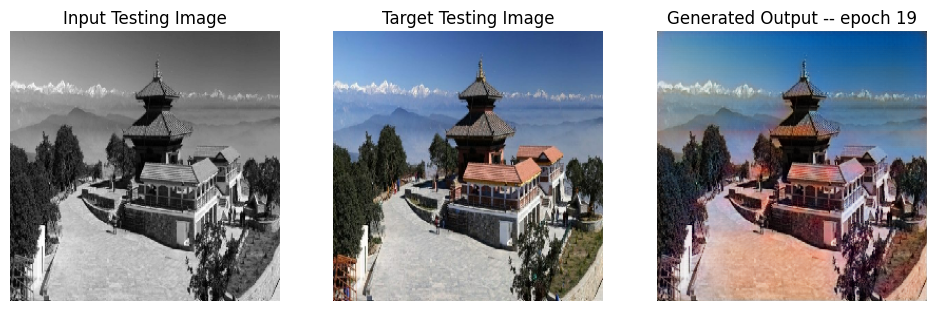

SSIM Score: [0.9297082]
PSNR Score: [22.081211]
Epoch 19
Training Details
Generator-- total_loss:17.46441 gan_loss:9.11215 l1_loss:0.04954 perceptual_loss:0.00614 Discriminator-- total_loss:0.07528 real_loss:0.04112 generated_loss:0.03416 --- SSIM 0.93359 PSNR 23.62369 LPIPS 0.00000
Time taken for epoch 20 is 421.61679553985596 sec
Number of iteration 525
Validation Details
Generator-- total_loss:9.97929 gan_loss:0.03837 l1_loss:0.05751  perceptual_loss:0.00877 Discriminator-- total_loss:4.35395 real_loss:4.32380 generated_loss:0.03016 --- SSIM 0.92822 PSNR 22.64420 LPIPS 0.00000
Time taken for epoch 20 is 467.31455397605896 sec
Number of iteration 70
Displaying one random test image...


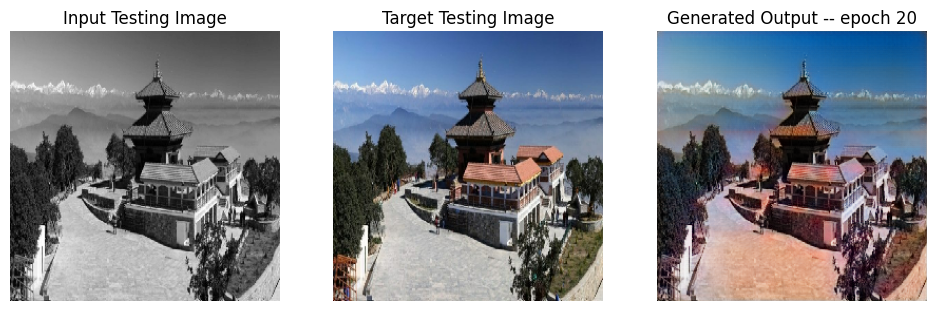

SSIM Score: [0.9295254]
PSNR Score: [22.084965]
Epoch 20
Training Details
Generator-- total_loss:18.21946 gan_loss:9.82160 l1_loss:0.04986 perceptual_loss:0.00612 Discriminator-- total_loss:0.01094 real_loss:0.00511 generated_loss:0.00583 --- SSIM 0.93292 PSNR 23.58387 LPIPS 0.00000
Time taken for epoch 21 is 422.0700807571411 sec
Number of iteration 525
Validation Details
Generator-- total_loss:10.07650 gan_loss:0.16031 l1_loss:0.05733  perceptual_loss:0.00878 Discriminator-- total_loss:7.79071 real_loss:7.74828 generated_loss:0.04243 --- SSIM 0.92816 PSNR 22.66802 LPIPS 0.00000
Time taken for epoch 21 is 467.1452102661133 sec
Number of iteration 70
Displaying one random test image...


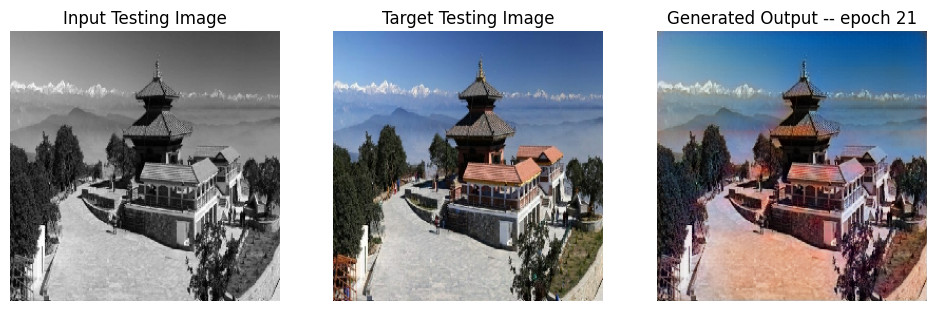

SSIM Score: [0.9299478]
PSNR Score: [22.134888]
Epoch 21
Training Details
Generator-- total_loss:18.81939 gan_loss:10.46002 l1_loss:0.04960 perceptual_loss:0.00613 Discriminator-- total_loss:0.14503 real_loss:0.08395 generated_loss:0.06107 --- SSIM 0.93353 PSNR 23.62695 LPIPS 0.00000
Time taken for epoch 22 is 420.48155426979065 sec
Number of iteration 525
Validation Details
Generator-- total_loss:10.05323 gan_loss:0.10768 l1_loss:0.05753  perceptual_loss:0.00878 Discriminator-- total_loss:4.59677 real_loss:4.57901 generated_loss:0.01776 --- SSIM 0.92828 PSNR 22.64974 LPIPS 0.00000
Time taken for epoch 22 is 464.95614409446716 sec
Number of iteration 70
Displaying one random test image...


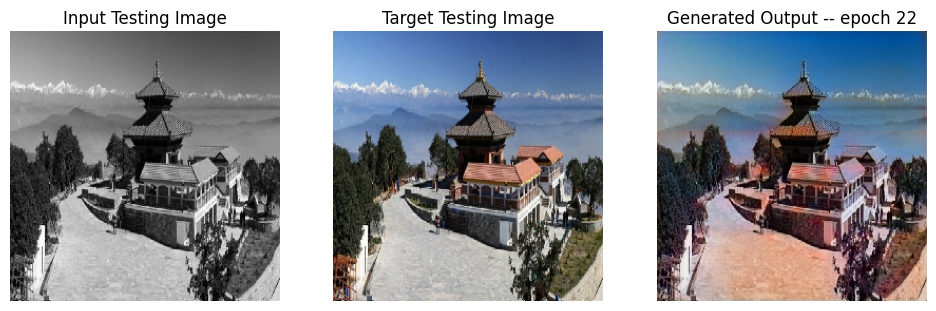

SSIM Score: [0.9293764]
PSNR Score: [22.093063]
Epoch 22
Training Details
Generator-- total_loss:19.84701 gan_loss:11.49105 l1_loss:0.04964 perceptual_loss:0.00607 Discriminator-- total_loss:0.00393 real_loss:0.00176 generated_loss:0.00217 --- SSIM 0.93376 PSNR 23.62919 LPIPS 0.00000
Time taken for epoch 23 is 421.13522458076477 sec
Number of iteration 525
Validation Details
Generator-- total_loss:9.96378 gan_loss:0.00720 l1_loss:0.05763  perceptual_loss:0.00875 Discriminator-- total_loss:6.84704 real_loss:6.83331 generated_loss:0.01372 --- SSIM 0.92834 PSNR 22.63702 LPIPS 0.00000
Time taken for epoch 23 is 465.53909182548523 sec
Number of iteration 70
Displaying one random test image...


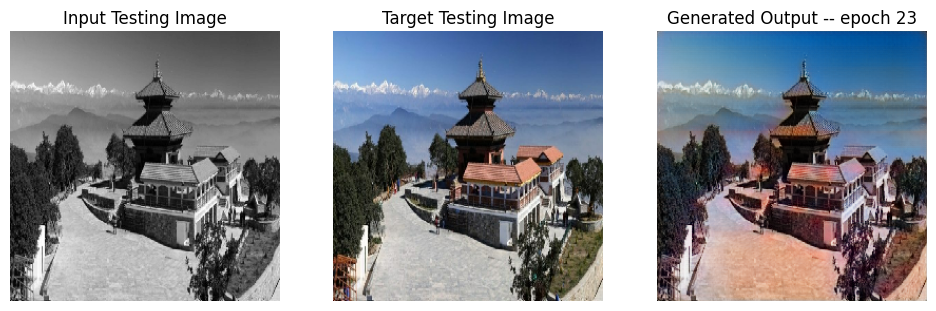

SSIM Score: [0.92986065]
PSNR Score: [22.115612]
Epoch 23
Training Details
Generator-- total_loss:20.96611 gan_loss:12.57518 l1_loss:0.04981 perceptual_loss:0.00613 Discriminator-- total_loss:0.01428 real_loss:0.00698 generated_loss:0.00729 --- SSIM 0.93290 PSNR 23.59329 LPIPS 0.00000
Time taken for epoch 24 is 421.5730996131897 sec
Number of iteration 525
Validation Details
Generator-- total_loss:10.33421 gan_loss:0.37711 l1_loss:0.05757  perceptual_loss:0.00881 Discriminator-- total_loss:5.54823 real_loss:5.49734 generated_loss:0.05089 --- SSIM 0.92775 PSNR 22.62782 LPIPS 0.00000
Time taken for epoch 24 is 466.4945752620697 sec
Number of iteration 70
Displaying one random test image...


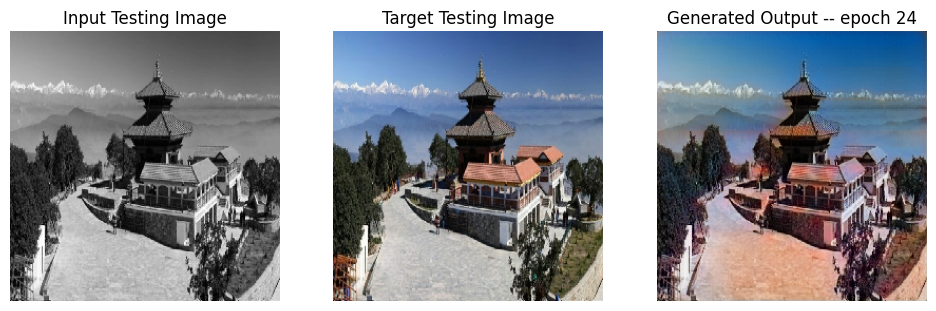

SSIM Score: [0.92930025]
PSNR Score: [22.094582]
Epoch 24
Training Details
Generator-- total_loss:20.25819 gan_loss:11.88373 l1_loss:0.04973 perceptual_loss:0.00610 Discriminator-- total_loss:0.71940 real_loss:0.32224 generated_loss:0.39716 --- SSIM 0.93325 PSNR 23.61666 LPIPS 0.00000
Time taken for epoch 25 is 420.06310415267944 sec
Number of iteration 525
Validation Details
Generator-- total_loss:9.93911 gan_loss:0.01060 l1_loss:0.05744  perceptual_loss:0.00875 Discriminator-- total_loss:6.60174 real_loss:6.58920 generated_loss:0.01255 --- SSIM 0.92834 PSNR 22.66543 LPIPS 0.00000
Time taken for epoch 25 is 464.8229093551636 sec
Number of iteration 70
Displaying one random test image...


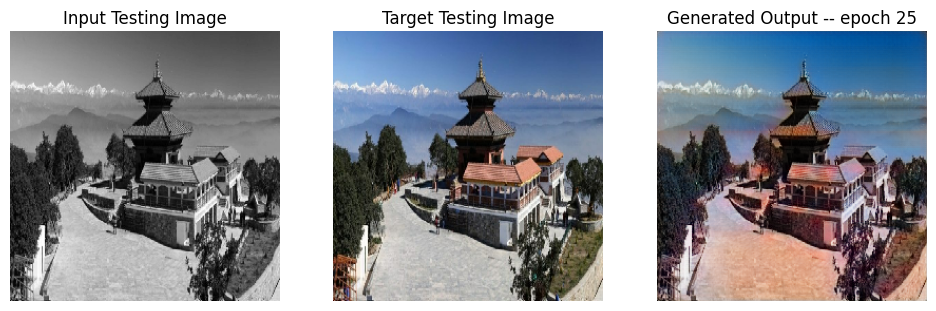

SSIM Score: [0.92985064]
PSNR Score: [22.094284]
Epoch 25
Training Details
Generator-- total_loss:20.62323 gan_loss:12.27627 l1_loss:0.04948 perceptual_loss:0.00616 Discriminator-- total_loss:0.02085 real_loss:0.00933 generated_loss:0.01152 --- SSIM 0.93326 PSNR 23.63569 LPIPS 0.00000
Time taken for epoch 26 is 427.6990406513214 sec
Number of iteration 525
Validation Details
Generator-- total_loss:10.00393 gan_loss:0.04838 l1_loss:0.05760  perceptual_loss:0.00877 Discriminator-- total_loss:6.83740 real_loss:6.82294 generated_loss:0.01446 --- SSIM 0.92796 PSNR 22.64411 LPIPS 0.00000
Time taken for epoch 26 is 473.84551978111267 sec
Number of iteration 70
Displaying one random test image...


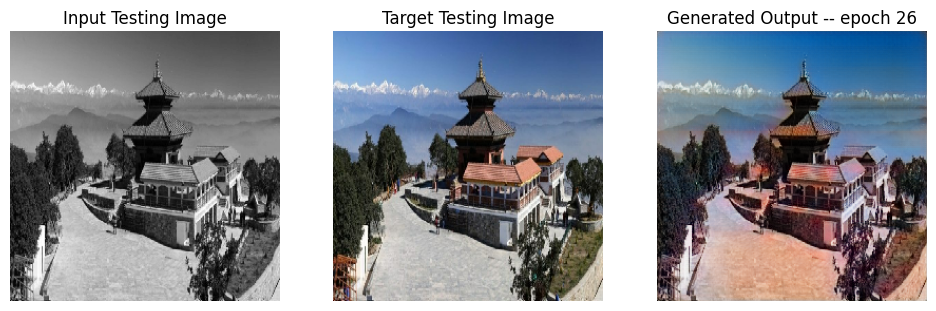

SSIM Score: [0.9298024]
PSNR Score: [22.141272]
Epoch 26
Training Details
Generator-- total_loss:20.44455 gan_loss:12.04594 l1_loss:0.04988 perceptual_loss:0.00611 Discriminator-- total_loss:0.05893 real_loss:0.03139 generated_loss:0.02755 --- SSIM 0.93325 PSNR 23.58787 LPIPS 0.00000
Time taken for epoch 27 is 427.42138743400574 sec
Number of iteration 525
Validation Details
Generator-- total_loss:9.95020 gan_loss:0.00618 l1_loss:0.05752  perceptual_loss:0.00878 Discriminator-- total_loss:10.56022 real_loss:10.54038 generated_loss:0.01985 --- SSIM 0.92802 PSNR 22.65287 LPIPS 0.00000
Time taken for epoch 27 is 472.1320815086365 sec
Number of iteration 70
Displaying one random test image...


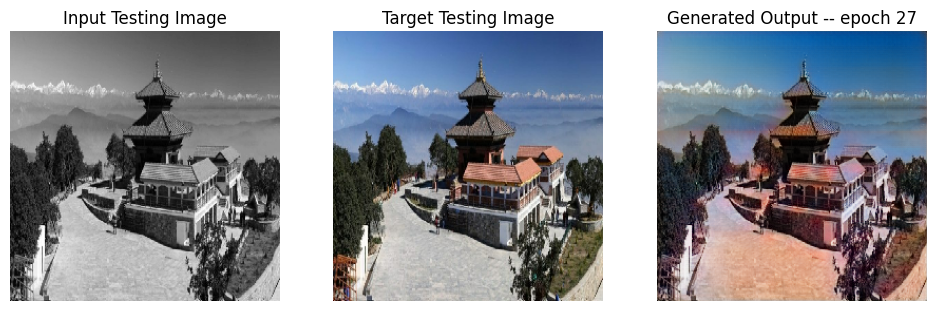

SSIM Score: [0.9302266]
PSNR Score: [22.088705]
Epoch 27
Training Details
Generator-- total_loss:22.04914 gan_loss:13.65473 l1_loss:0.04980 perceptual_loss:0.00616 Discriminator-- total_loss:0.00272 real_loss:0.00125 generated_loss:0.00147 --- SSIM 0.93310 PSNR 23.58524 LPIPS 0.00000
Time taken for epoch 28 is 419.60127878189087 sec
Number of iteration 525
Validation Details
Generator-- total_loss:9.97855 gan_loss:0.00462 l1_loss:0.05771  perceptual_loss:0.00878 Discriminator-- total_loss:7.10612 real_loss:7.09735 generated_loss:0.00877 --- SSIM 0.92787 PSNR 22.63534 LPIPS 0.00000
Time taken for epoch 28 is 463.729341506958 sec
Number of iteration 70
Displaying one random test image...


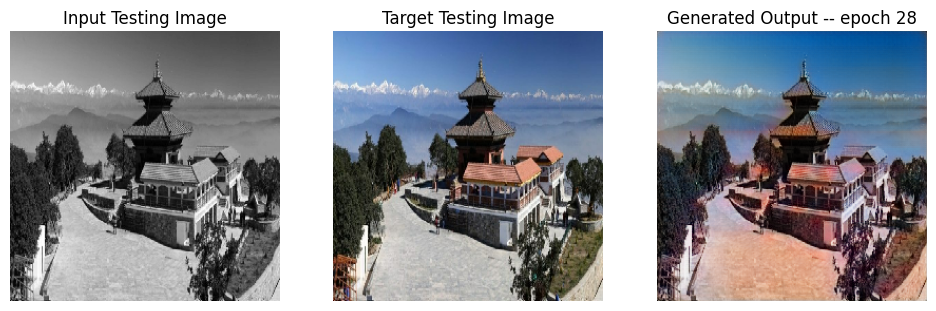

SSIM Score: [0.92977446]
PSNR Score: [22.066133]
Epoch 28
Training Details
Generator-- total_loss:22.23162 gan_loss:13.89196 l1_loss:0.04950 perceptual_loss:0.00610 Discriminator-- total_loss:0.00158 real_loss:0.00069 generated_loss:0.00089 --- SSIM 0.93341 PSNR 23.64087 LPIPS 0.00000
Time taken for epoch 29 is 418.492614030838 sec
Number of iteration 525
Validation Details
Generator-- total_loss:9.98143 gan_loss:0.00124 l1_loss:0.05770  perceptual_loss:0.00883 Discriminator-- total_loss:9.54641 real_loss:9.54237 generated_loss:0.00404 --- SSIM 0.92782 PSNR 22.62520 LPIPS 0.00000
Time taken for epoch 29 is 463.1673974990845 sec
Number of iteration 70
Displaying one random test image...


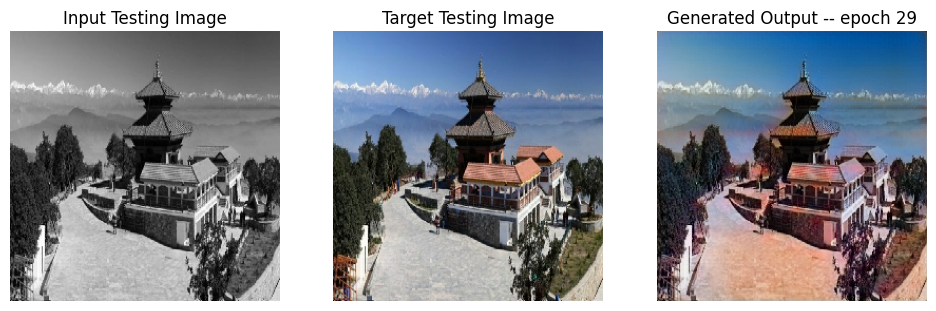

SSIM Score: [0.9299174]
PSNR Score: [22.09516]
Epoch 29
Training Details
Generator-- total_loss:23.84662 gan_loss:15.45748 l1_loss:0.04981 perceptual_loss:0.00612 Discriminator-- total_loss:0.34534 real_loss:0.19373 generated_loss:0.15161 --- SSIM 0.93309 PSNR 23.60520 LPIPS 0.00000
Time taken for epoch 30 is 420.7106373310089 sec
Number of iteration 525
Validation Details
Generator-- total_loss:10.51273 gan_loss:0.52265 l1_loss:0.05781  perceptual_loss:0.00879 Discriminator-- total_loss:10.02766 real_loss:9.91021 generated_loss:0.11745 --- SSIM 0.92767 PSNR 22.60254 LPIPS 0.00000
Time taken for epoch 30 is 465.4442296028137 sec
Number of iteration 70
Displaying one random test image...


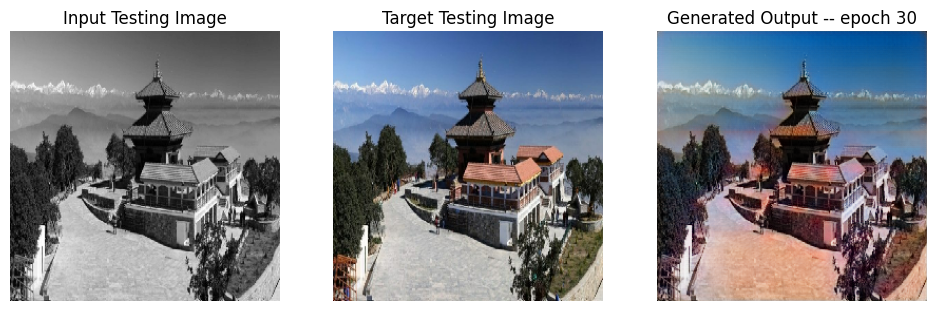

SSIM Score: [0.92870855]
PSNR Score: [22.016228]
Epoch 30
Training Details
Generator-- total_loss:24.42956 gan_loss:16.06993 l1_loss:0.04959 perceptual_loss:0.00614 Discriminator-- total_loss:0.00894 real_loss:0.00460 generated_loss:0.00434 --- SSIM 0.93368 PSNR 23.64167 LPIPS 0.00000
Time taken for epoch 31 is 420.90733456611633 sec
Number of iteration 525
Validation Details
Generator-- total_loss:9.99135 gan_loss:0.07905 l1_loss:0.05737  perceptual_loss:0.00872 Discriminator-- total_loss:9.06230 real_loss:9.03588 generated_loss:0.02642 --- SSIM 0.92783 PSNR 22.66599 LPIPS 0.00000
Time taken for epoch 31 is 465.5663630962372 sec
Number of iteration 70
Displaying one random test image...


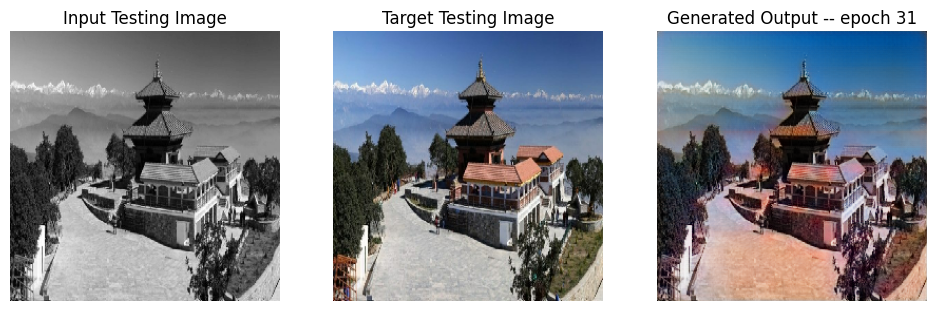

SSIM Score: [0.92939085]
PSNR Score: [22.094269]
Epoch 31
Training Details
Generator-- total_loss:25.62001 gan_loss:17.26026 l1_loss:0.04958 perceptual_loss:0.00615 Discriminator-- total_loss:0.00211 real_loss:0.00105 generated_loss:0.00106 --- SSIM 0.93370 PSNR 23.62704 LPIPS 0.00000
Time taken for epoch 32 is 425.77744150161743 sec
Number of iteration 525
Validation Details
Generator-- total_loss:10.00153 gan_loss:0.00389 l1_loss:0.05789  perceptual_loss:0.00876 Discriminator-- total_loss:8.72572 real_loss:8.71810 generated_loss:0.00763 --- SSIM 0.92789 PSNR 22.60033 LPIPS 0.00000
Time taken for epoch 32 is 470.6958017349243 sec
Number of iteration 70
Displaying one random test image...


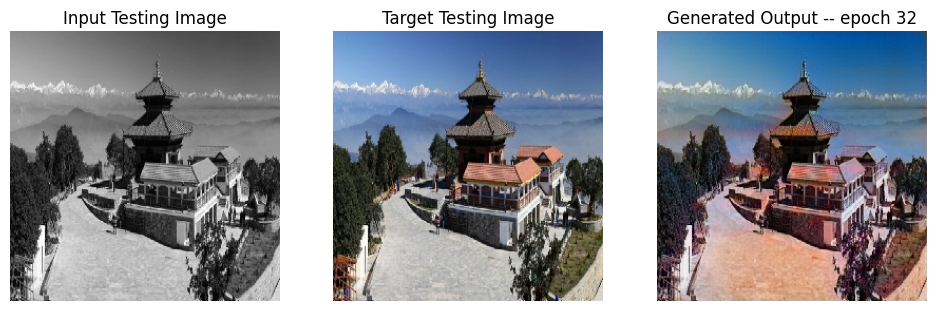

SSIM Score: [0.9291296]
PSNR Score: [22.00195]
Epoch 32
Training Details
Generator-- total_loss:25.84925 gan_loss:17.48772 l1_loss:0.04963 perceptual_loss:0.00611 Discriminator-- total_loss:0.16588 real_loss:0.07004 generated_loss:0.09584 --- SSIM 0.93302 PSNR 23.63010 LPIPS 0.00000
Time taken for epoch 33 is 423.6421740055084 sec
Number of iteration 525
Validation Details
Generator-- total_loss:9.96830 gan_loss:0.00775 l1_loss:0.05764  perceptual_loss:0.00876 Discriminator-- total_loss:8.76086 real_loss:8.74999 generated_loss:0.01088 --- SSIM 0.92728 PSNR 22.62407 LPIPS 0.00000
Time taken for epoch 33 is 468.4252824783325 sec
Number of iteration 70
Displaying one random test image...


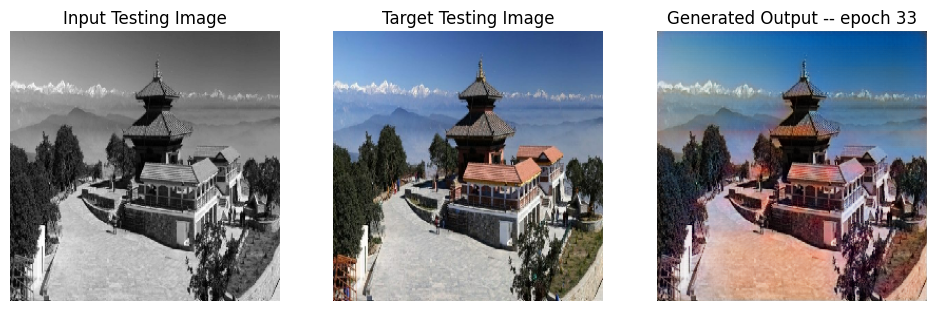

SSIM Score: [0.9284249]
PSNR Score: [22.028763]
Epoch 33
Training Details
Generator-- total_loss:26.50824 gan_loss:18.16230 l1_loss:0.04949 perceptual_loss:0.00615 Discriminator-- total_loss:0.00291 real_loss:0.00172 generated_loss:0.00119 --- SSIM 0.93360 PSNR 23.64697 LPIPS 0.00000
Time taken for epoch 34 is 424.97350811958313 sec
Number of iteration 525
Validation Details
Generator-- total_loss:9.94419 gan_loss:0.00121 l1_loss:0.05749  perceptual_loss:0.00880 Discriminator-- total_loss:10.66869 real_loss:10.66599 generated_loss:0.00270 --- SSIM 0.92815 PSNR 22.66429 LPIPS 0.00000
Time taken for epoch 34 is 469.8273015022278 sec
Number of iteration 70
Displaying one random test image...


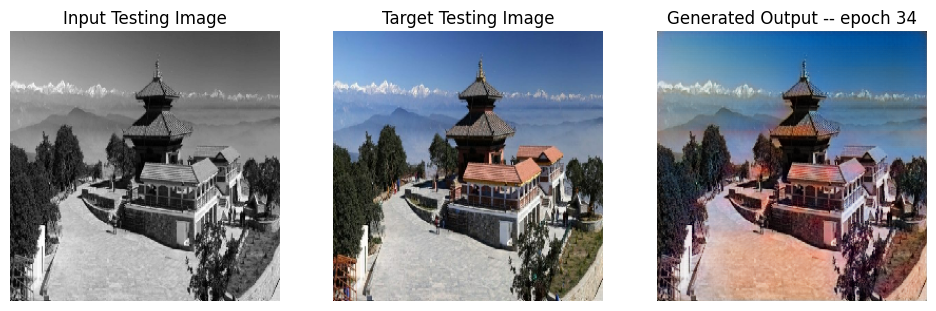

SSIM Score: [0.9296427]
PSNR Score: [22.111168]
Epoch 34
Training Details
Generator-- total_loss:27.49953 gan_loss:19.13674 l1_loss:0.04961 perceptual_loss:0.00614 Discriminator-- total_loss:0.06864 real_loss:0.03034 generated_loss:0.03829 --- SSIM 0.93352 PSNR 23.63369 LPIPS 0.00000
Time taken for epoch 35 is 427.83814239501953 sec
Number of iteration 525
Validation Details
Generator-- total_loss:9.88659 gan_loss:0.00812 l1_loss:0.05705  perceptual_loss:0.00880 Discriminator-- total_loss:10.74974 real_loss:10.73035 generated_loss:0.01939 --- SSIM 0.92839 PSNR 22.68793 LPIPS 0.00000
Time taken for epoch 35 is 472.5721595287323 sec
Number of iteration 70
Displaying one random test image...


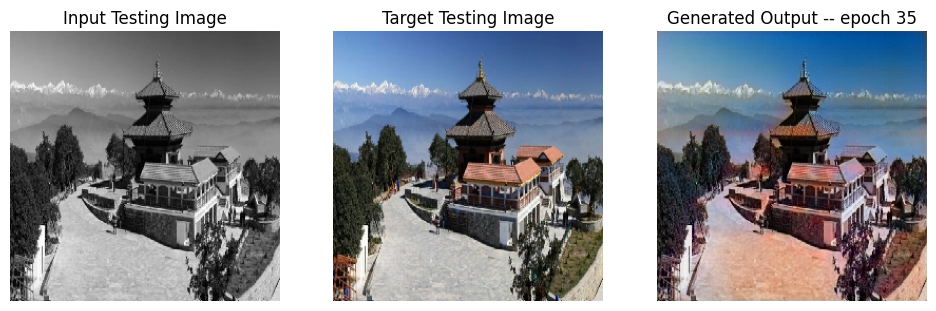

SSIM Score: [0.93083286]
PSNR Score: [22.251986]
Epoch 35
Training Details
Generator-- total_loss:27.37849 gan_loss:19.01380 l1_loss:0.04965 perceptual_loss:0.00611 Discriminator-- total_loss:0.00329 real_loss:0.00180 generated_loss:0.00149 --- SSIM 0.93329 PSNR 23.61852 LPIPS 0.00000
Time taken for epoch 36 is 427.8686451911926 sec
Number of iteration 525
Validation Details
Generator-- total_loss:9.92508 gan_loss:0.00148 l1_loss:0.05739  perceptual_loss:0.00877 Discriminator-- total_loss:11.11602 real_loss:11.11292 generated_loss:0.00310 --- SSIM 0.92777 PSNR 22.65828 LPIPS 0.00000
Time taken for epoch 36 is 472.81147480010986 sec
Number of iteration 70
Displaying one random test image...


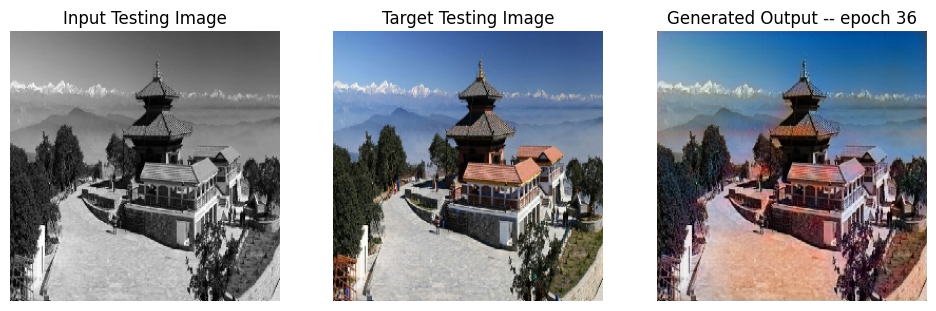

SSIM Score: [0.92962545]
PSNR Score: [22.128397]
Epoch 36
Training Details
Generator-- total_loss:27.89196 gan_loss:19.53075 l1_loss:0.04962 perceptual_loss:0.00613 Discriminator-- total_loss:0.00049 real_loss:0.00024 generated_loss:0.00025 --- SSIM 0.93342 PSNR 23.63676 LPIPS 0.00000
Time taken for epoch 37 is 425.42697286605835 sec
Number of iteration 525
Validation Details
Generator-- total_loss:9.94572 gan_loss:0.00056 l1_loss:0.05747  perceptual_loss:0.00883 Discriminator-- total_loss:12.41168 real_loss:12.40769 generated_loss:0.00399 --- SSIM 0.92823 PSNR 22.63679 LPIPS 0.00000
Time taken for epoch 37 is 470.56922125816345 sec
Number of iteration 70
Displaying one random test image...


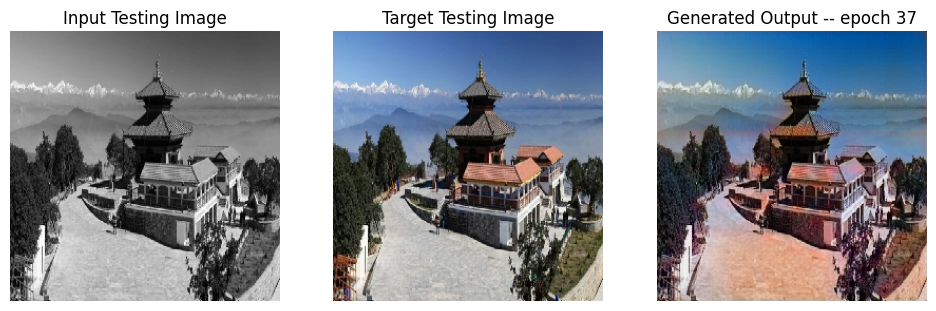

SSIM Score: [0.9297691]
PSNR Score: [22.115582]
Epoch 37
Training Details
Generator-- total_loss:26.72531 gan_loss:18.41013 l1_loss:0.04932 perceptual_loss:0.00611 Discriminator-- total_loss:0.00024 real_loss:0.00014 generated_loss:0.00009 --- SSIM 0.93320 PSNR 23.68407 LPIPS 0.00000
Time taken for epoch 38 is 421.9821996688843 sec
Number of iteration 525
Validation Details
Generator-- total_loss:9.95968 gan_loss:0.00061 l1_loss:0.05762  perceptual_loss:0.00878 Discriminator-- total_loss:12.23853 real_loss:12.23586 generated_loss:0.00267 --- SSIM 0.92789 PSNR 22.63016 LPIPS 0.00000
Time taken for epoch 38 is 466.16095876693726 sec
Number of iteration 70
Displaying one random test image...


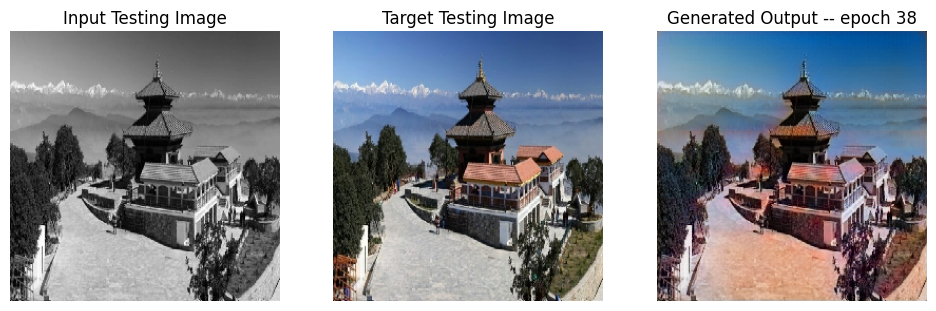

SSIM Score: [0.9292397]
PSNR Score: [22.05414]
Epoch 38
Training Details
Generator-- total_loss:31.72304 gan_loss:23.33397 l1_loss:0.04980 perceptual_loss:0.00613 Discriminator-- total_loss:0.21208 real_loss:0.12779 generated_loss:0.08430 --- SSIM 0.93325 PSNR 23.61423 LPIPS 0.00000
Time taken for epoch 39 is 420.3764879703522 sec
Number of iteration 525
Validation Details
Generator-- total_loss:9.92643 gan_loss:0.00508 l1_loss:0.05740  perceptual_loss:0.00875 Discriminator-- total_loss:8.94875 real_loss:8.93550 generated_loss:0.01325 --- SSIM 0.92782 PSNR 22.65260 LPIPS 0.00000
Time taken for epoch 39 is 465.02715730667114 sec
Number of iteration 70
Displaying one random test image...


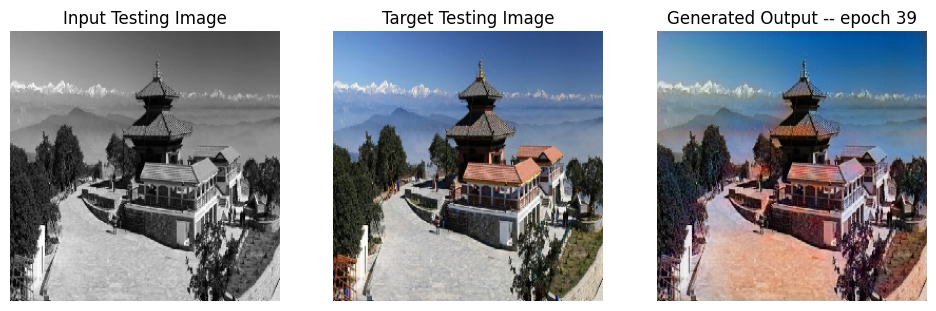

SSIM Score: [0.92904395]
PSNR Score: [22.078289]
Epoch 39
Training Details
Generator-- total_loss:30.59609 gan_loss:22.20438 l1_loss:0.04981 perceptual_loss:0.00613 Discriminator-- total_loss:0.00084 real_loss:0.00038 generated_loss:0.00046 --- SSIM 0.93313 PSNR 23.60086 LPIPS 0.00000
Time taken for epoch 40 is 421.36366271972656 sec
Number of iteration 525
Validation Details
Generator-- total_loss:9.96775 gan_loss:0.00377 l1_loss:0.05763  perceptual_loss:0.00879 Discriminator-- total_loss:10.31811 real_loss:10.31149 generated_loss:0.00663 --- SSIM 0.92791 PSNR 22.62932 LPIPS 0.00000
Time taken for epoch 40 is 465.7626008987427 sec
Number of iteration 70
Displaying one random test image...


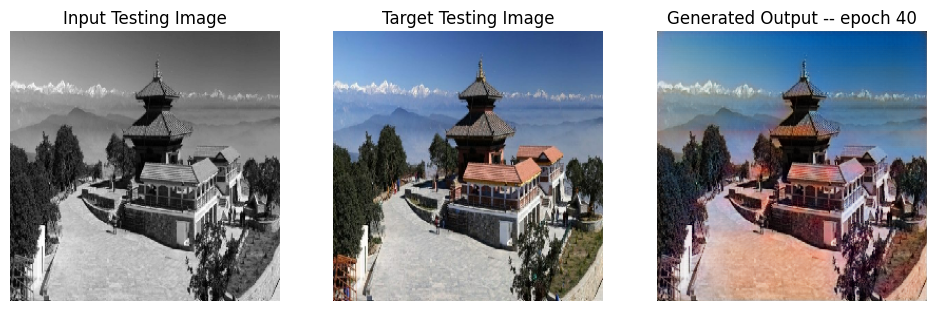

SSIM Score: [0.92893964]
PSNR Score: [22.064856]
Epoch 40
Training Details
Generator-- total_loss:34.30708 gan_loss:25.94292 l1_loss:0.04964 perceptual_loss:0.00612 Discriminator-- total_loss:0.14663 real_loss:0.06182 generated_loss:0.08482 --- SSIM 0.93357 PSNR 23.63292 LPIPS 0.00000
Time taken for epoch 41 is 420.8470604419708 sec
Number of iteration 525
Validation Details
Generator-- total_loss:10.02441 gan_loss:0.00514 l1_loss:0.05804  perceptual_loss:0.00875 Discriminator-- total_loss:11.74594 real_loss:11.74027 generated_loss:0.00567 --- SSIM 0.92781 PSNR 22.58354 LPIPS 0.00000
Time taken for epoch 41 is 465.1057484149933 sec
Number of iteration 70
Displaying one random test image...


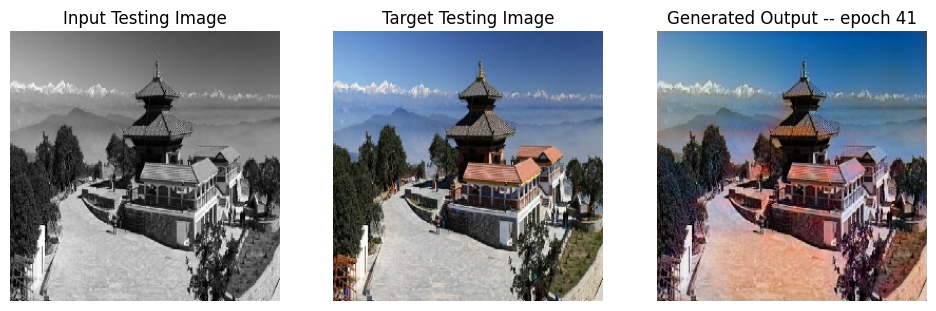

SSIM Score: [0.92907494]
PSNR Score: [21.988138]
Epoch 41
Training Details
Generator-- total_loss:33.78086 gan_loss:25.41921 l1_loss:0.04960 perceptual_loss:0.00615 Discriminator-- total_loss:0.00775 real_loss:0.00430 generated_loss:0.00345 --- SSIM 0.93371 PSNR 23.63117 LPIPS 0.00000
Time taken for epoch 42 is 421.9155418872833 sec
Number of iteration 525
Validation Details
Generator-- total_loss:9.93420 gan_loss:0.00090 l1_loss:0.05750  perceptual_loss:0.00873 Discriminator-- total_loss:14.50331 real_loss:14.50106 generated_loss:0.00225 --- SSIM 0.92777 PSNR 22.64450 LPIPS 0.00000
Time taken for epoch 42 is 467.09792828559875 sec
Number of iteration 70
Displaying one random test image...


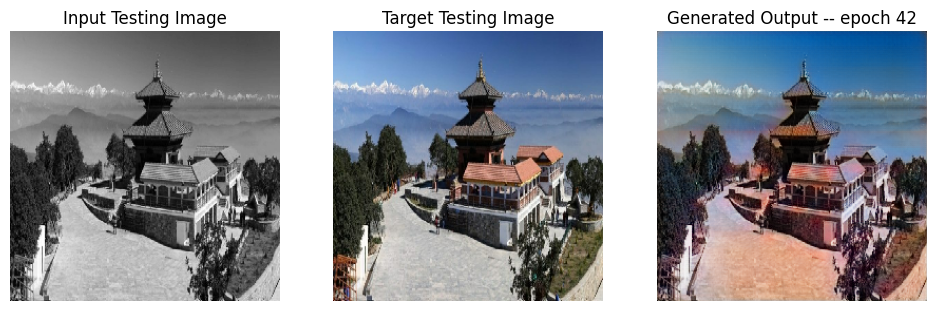

SSIM Score: [0.92889786]
PSNR Score: [22.041937]
Epoch 42
Training Details
Generator-- total_loss:35.48195 gan_loss:27.08605 l1_loss:0.04978 perceptual_loss:0.00619 Discriminator-- total_loss:0.00483 real_loss:0.00212 generated_loss:0.00271 --- SSIM 0.93296 PSNR 23.60448 LPIPS 0.00000
Time taken for epoch 43 is 424.2291338443756 sec
Number of iteration 525
Validation Details
Generator-- total_loss:10.00069 gan_loss:0.00378 l1_loss:0.05789  perceptual_loss:0.00876 Discriminator-- total_loss:15.05107 real_loss:15.04456 generated_loss:0.00651 --- SSIM 0.92755 PSNR 22.59837 LPIPS 0.00000
Time taken for epoch 43 is 468.76021003723145 sec
Number of iteration 70
Displaying one random test image...


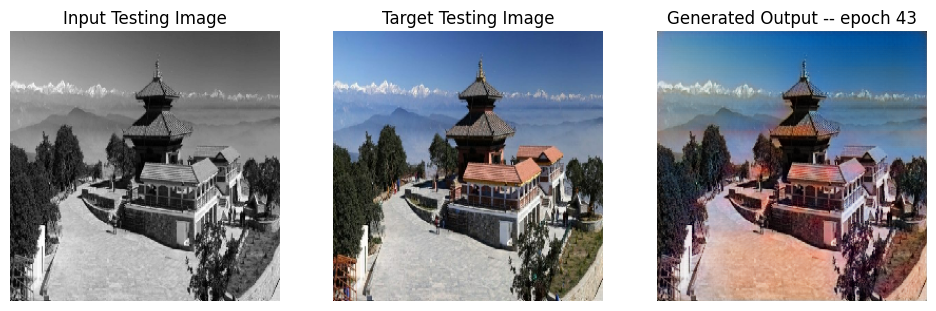

SSIM Score: [0.9295743]
PSNR Score: [22.068048]
Epoch 43
Training Details
Generator-- total_loss:35.44549 gan_loss:27.09038 l1_loss:0.04960 perceptual_loss:0.00610 Discriminator-- total_loss:0.10956 real_loss:0.06294 generated_loss:0.04662 --- SSIM 0.93338 PSNR 23.63210 LPIPS 0.00000
Time taken for epoch 44 is 423.6944646835327 sec
Number of iteration 525
Validation Details
Generator-- total_loss:10.04765 gan_loss:0.08796 l1_loss:0.05769  perceptual_loss:0.00871 Discriminator-- total_loss:10.93473 real_loss:10.81404 generated_loss:0.12069 --- SSIM 0.92772 PSNR 22.62041 LPIPS 0.00000
Time taken for epoch 44 is 468.0229377746582 sec
Number of iteration 70
Displaying one random test image...


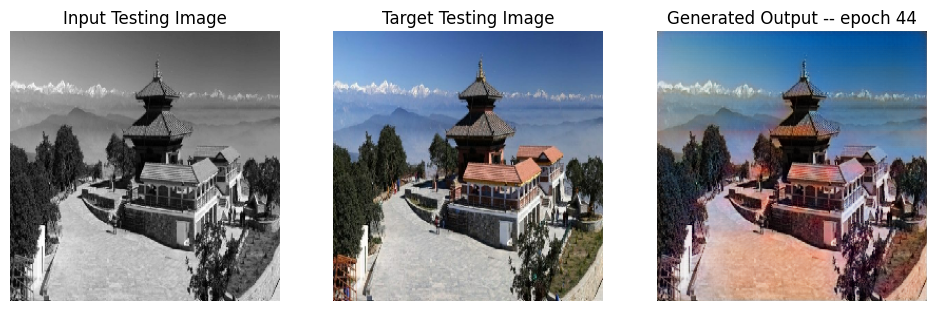

SSIM Score: [0.92859894]
PSNR Score: [22.022375]
Epoch 44
Training Details
Generator-- total_loss:33.41648 gan_loss:25.05314 l1_loss:0.04960 perceptual_loss:0.00616 Discriminator-- total_loss:0.10581 real_loss:0.07192 generated_loss:0.03388 --- SSIM 0.93316 PSNR 23.62068 LPIPS 0.00000
Time taken for epoch 45 is 423.47465538978577 sec
Number of iteration 525
Validation Details
Generator-- total_loss:9.97539 gan_loss:0.00115 l1_loss:0.05771  perceptual_loss:0.00879 Discriminator-- total_loss:13.67954 real_loss:13.67640 generated_loss:0.00314 --- SSIM 0.92785 PSNR 22.62213 LPIPS 0.00000
Time taken for epoch 45 is 468.03744101524353 sec
Number of iteration 70
Displaying one random test image...


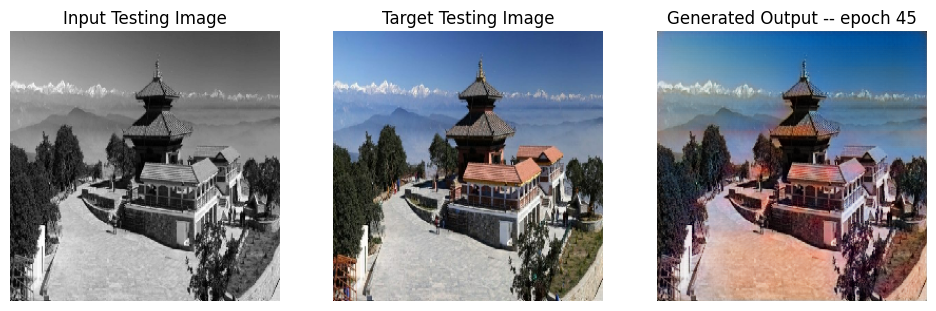

SSIM Score: [0.9295197]
PSNR Score: [22.072184]
Epoch 45
Training Details
Generator-- total_loss:33.21136 gan_loss:24.86045 l1_loss:0.04952 perceptual_loss:0.00616 Discriminator-- total_loss:0.01601 real_loss:0.01011 generated_loss:0.00590 --- SSIM 0.93363 PSNR 23.63745 LPIPS 0.00000
Time taken for epoch 46 is 423.20028924942017 sec
Number of iteration 525
Validation Details
Generator-- total_loss:9.90375 gan_loss:0.00131 l1_loss:0.05724  perceptual_loss:0.00878 Discriminator-- total_loss:14.54885 real_loss:14.54315 generated_loss:0.00570 --- SSIM 0.92776 PSNR 22.66457 LPIPS 0.00000
Time taken for epoch 46 is 467.6659278869629 sec
Number of iteration 70
Displaying one random test image...


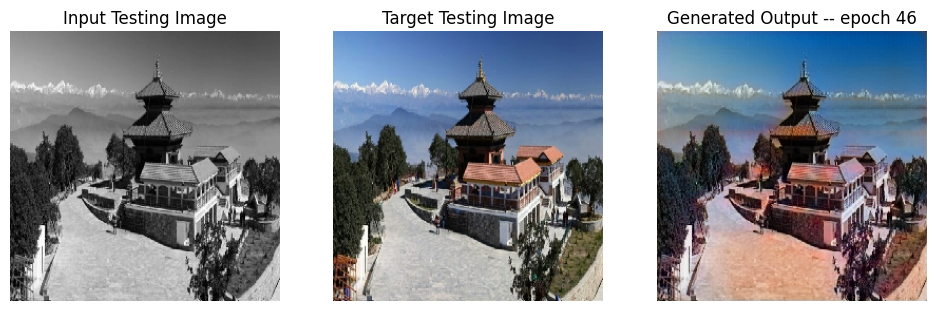

SSIM Score: [0.9291835]
PSNR Score: [22.128119]
Epoch 46
Training Details
Generator-- total_loss:36.16233 gan_loss:27.79859 l1_loss:0.04961 perceptual_loss:0.00615 Discriminator-- total_loss:0.00202 real_loss:0.00105 generated_loss:0.00096 --- SSIM 0.93324 PSNR 23.63257 LPIPS 0.00000
Time taken for epoch 47 is 421.70131850242615 sec
Number of iteration 525
Validation Details
Generator-- total_loss:9.92692 gan_loss:0.00337 l1_loss:0.05745  perceptual_loss:0.00871 Discriminator-- total_loss:10.89729 real_loss:10.88718 generated_loss:0.01012 --- SSIM 0.92737 PSNR 22.64176 LPIPS 0.00000
Time taken for epoch 47 is 466.19324254989624 sec
Number of iteration 70
Displaying one random test image...


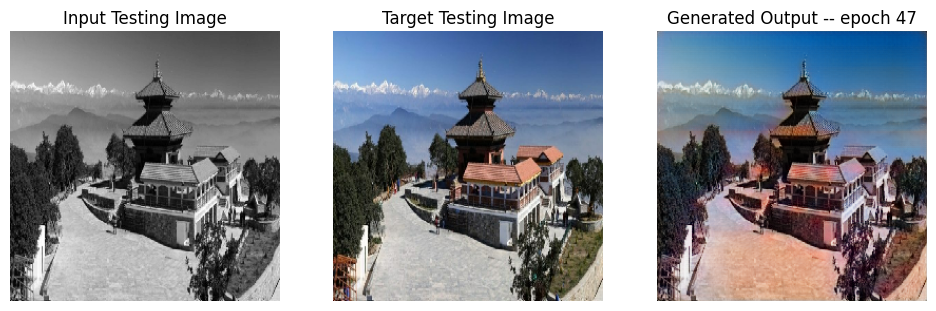

SSIM Score: [0.9289157]
PSNR Score: [22.09621]
Epoch 47
Training Details
Generator-- total_loss:37.21683 gan_loss:28.82383 l1_loss:0.04984 perceptual_loss:0.00612 Discriminator-- total_loss:0.00033 real_loss:0.00011 generated_loss:0.00022 --- SSIM 0.93308 PSNR 23.59507 LPIPS 0.00000
Time taken for epoch 48 is 420.1579284667969 sec
Number of iteration 525
Validation Details
Generator-- total_loss:9.96040 gan_loss:0.00034 l1_loss:0.05764  perceptual_loss:0.00876 Discriminator-- total_loss:14.67731 real_loss:14.67529 generated_loss:0.00202 --- SSIM 0.92752 PSNR 22.62815 LPIPS 0.00000
Time taken for epoch 48 is 464.83505272865295 sec
Number of iteration 70
Displaying one random test image...


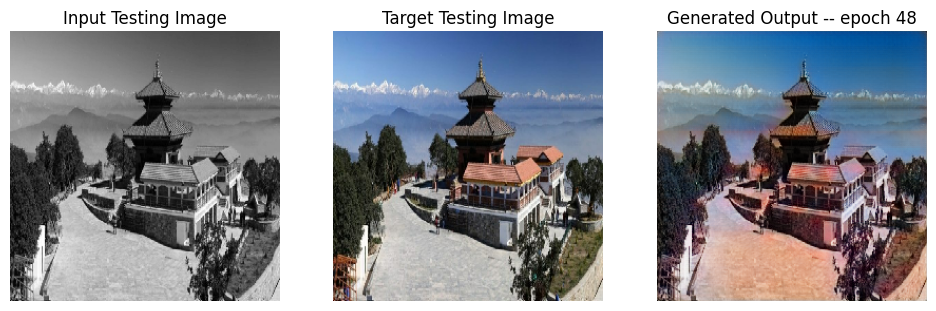

SSIM Score: [0.92912704]
PSNR Score: [22.027843]
Epoch 48
Training Details
Generator-- total_loss:36.64511 gan_loss:28.27949 l1_loss:0.04964 perceptual_loss:0.00613 Discriminator-- total_loss:0.38984 real_loss:0.23464 generated_loss:0.15521 --- SSIM 0.93366 PSNR 23.61963 LPIPS 0.00000
Time taken for epoch 49 is 422.2175283432007 sec
Number of iteration 525
Validation Details
Generator-- total_loss:9.92274 gan_loss:0.00101 l1_loss:0.05741  perceptual_loss:0.00874 Discriminator-- total_loss:14.37892 real_loss:14.37768 generated_loss:0.00124 --- SSIM 0.92795 PSNR 22.65009 LPIPS 0.00000
Time taken for epoch 49 is 466.85436820983887 sec
Number of iteration 70
Displaying one random test image...


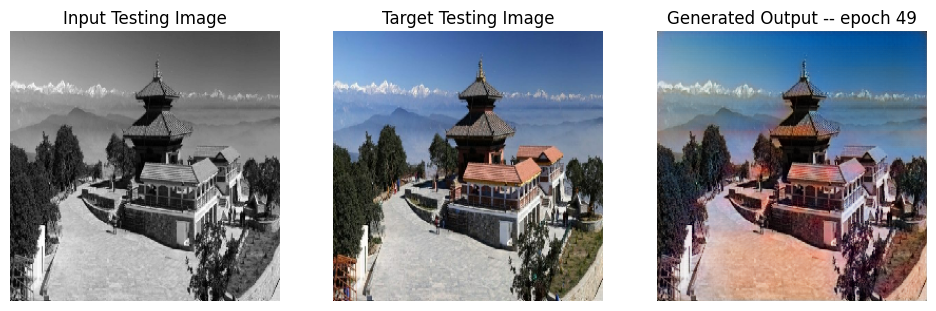

SSIM Score: [0.92933685]
PSNR Score: [22.088781]
Epoch 49
Training Details
Generator-- total_loss:35.88470 gan_loss:27.55466 l1_loss:0.04939 perceptual_loss:0.00614 Discriminator-- total_loss:0.02499 real_loss:0.00429 generated_loss:0.02070 --- SSIM 0.93339 PSNR 23.65709 LPIPS 0.00000
Time taken for epoch 50 is 424.06261706352234 sec
Number of iteration 525
Validation Details
Generator-- total_loss:10.02556 gan_loss:0.00545 l1_loss:0.05799  perceptual_loss:0.00881 Discriminator-- total_loss:11.17893 real_loss:11.17071 generated_loss:0.00822 --- SSIM 0.92752 PSNR 22.59087 LPIPS 0.00000
Time taken for epoch 50 is 469.11051297187805 sec
Number of iteration 70
Displaying one random test image...


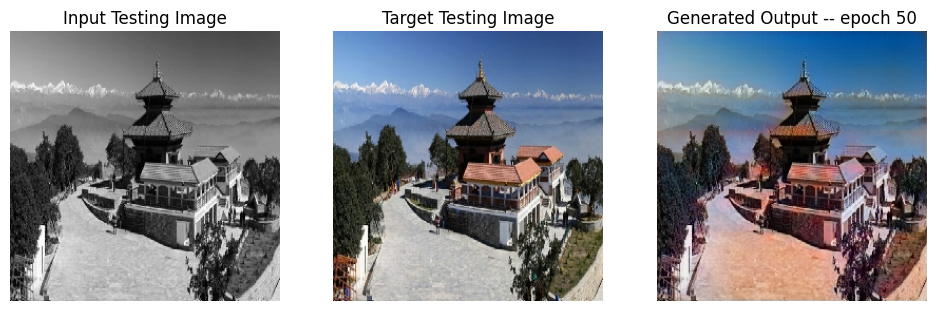

SSIM Score: [0.9286394]
PSNR Score: [21.97237]
Epoch 50
Training Details
Generator-- total_loss:36.82887 gan_loss:28.46681 l1_loss:0.04962 perceptual_loss:0.00612 Discriminator-- total_loss:0.00025 real_loss:0.00014 generated_loss:0.00011 --- SSIM 0.93358 PSNR 23.63711 LPIPS 0.00000
Time taken for epoch 51 is 422.8636338710785 sec
Number of iteration 525
Validation Details
Generator-- total_loss:9.98934 gan_loss:0.00427 l1_loss:0.05778  perceptual_loss:0.00878 Discriminator-- total_loss:11.05579 real_loss:11.05055 generated_loss:0.00523 --- SSIM 0.92737 PSNR 22.61283 LPIPS 0.00000
Time taken for epoch 51 is 467.36539244651794 sec
Number of iteration 70
Displaying one random test image...


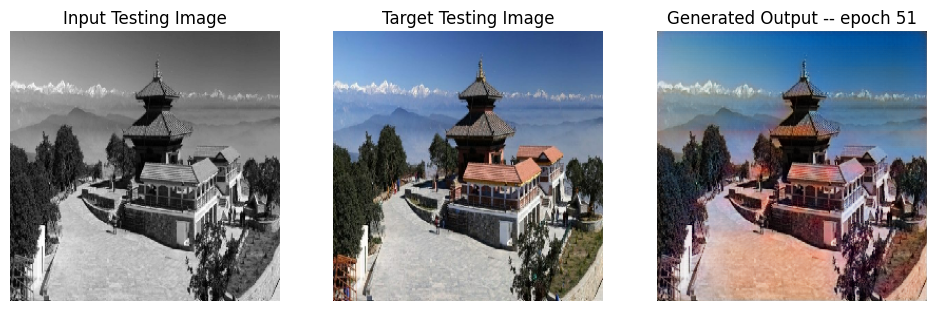

SSIM Score: [0.9289575]
PSNR Score: [22.076868]
Epoch 51
Training Details
Generator-- total_loss:37.37305 gan_loss:29.00686 l1_loss:0.04964 perceptual_loss:0.00614 Discriminator-- total_loss:0.00807 real_loss:0.00495 generated_loss:0.00312 --- SSIM 0.93367 PSNR 23.63490 LPIPS 0.00000
Time taken for epoch 52 is 421.9449734687805 sec
Number of iteration 525
Validation Details
Generator-- total_loss:10.01103 gan_loss:0.04251 l1_loss:0.05765  perceptual_loss:0.00880 Discriminator-- total_loss:10.38038 real_loss:10.35573 generated_loss:0.02465 --- SSIM 0.92803 PSNR 22.62672 LPIPS 0.00000
Time taken for epoch 52 is 466.2293996810913 sec
Number of iteration 70
Displaying one random test image...


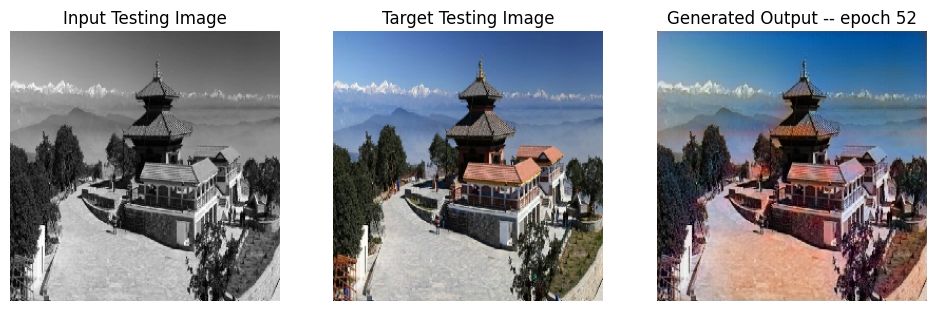

SSIM Score: [0.9297652]
PSNR Score: [22.135067]
Epoch 52
Training Details
Generator-- total_loss:40.63391 gan_loss:32.25478 l1_loss:0.04976 perceptual_loss:0.00610 Discriminator-- total_loss:0.06088 real_loss:0.04342 generated_loss:0.01746 --- SSIM 0.93328 PSNR 23.61096 LPIPS 0.00000
Time taken for epoch 53 is 421.04656648635864 sec
Number of iteration 525
Validation Details
Generator-- total_loss:10.85636 gan_loss:0.84069 l1_loss:0.05804  perceptual_loss:0.00874 Discriminator-- total_loss:8.80256 real_loss:8.68263 generated_loss:0.11993 --- SSIM 0.92777 PSNR 22.59142 LPIPS 0.00000
Time taken for epoch 53 is 465.82051396369934 sec
Number of iteration 70
Displaying one random test image...


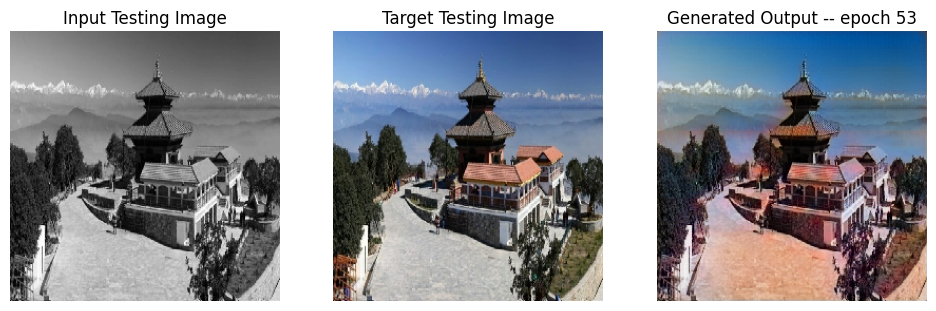

SSIM Score: [0.9287512]
PSNR Score: [21.938427]
Epoch 53
Training Details
Generator-- total_loss:37.52153 gan_loss:29.16123 l1_loss:0.04958 perceptual_loss:0.00615 Discriminator-- total_loss:0.00093 real_loss:0.00042 generated_loss:0.00051 --- SSIM 0.93349 PSNR 23.62340 LPIPS 0.00000
Time taken for epoch 54 is 419.8695607185364 sec
Number of iteration 525
Validation Details
Generator-- total_loss:9.98404 gan_loss:0.01496 l1_loss:0.05768  perceptual_loss:0.00878 Discriminator-- total_loss:10.10594 real_loss:10.10005 generated_loss:0.00589 --- SSIM 0.92811 PSNR 22.62415 LPIPS 0.00000
Time taken for epoch 54 is 464.8048052787781 sec
Number of iteration 70
Displaying one random test image...


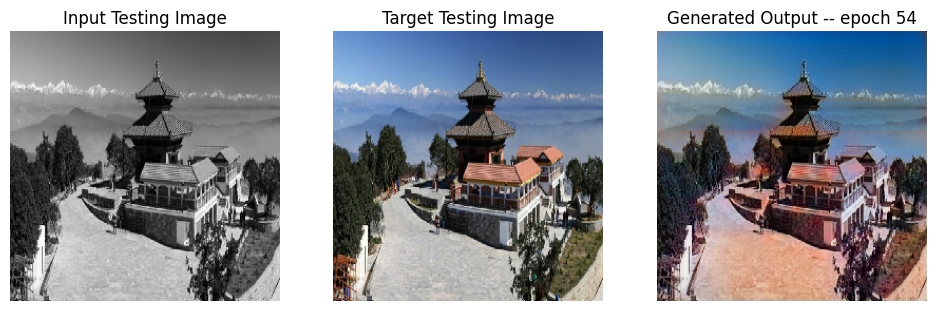

SSIM Score: [0.92903024]
PSNR Score: [22.030254]
Epoch 54
Training Details
Generator-- total_loss:39.01503 gan_loss:30.61139 l1_loss:0.04989 perceptual_loss:0.00613 Discriminator-- total_loss:0.00116 real_loss:0.00009 generated_loss:0.00107 --- SSIM 0.93328 PSNR 23.58184 LPIPS 0.00000
Time taken for epoch 55 is 436.63489270210266 sec
Number of iteration 525
Validation Details
Generator-- total_loss:10.00861 gan_loss:0.02916 l1_loss:0.05774  perceptual_loss:0.00879 Discriminator-- total_loss:19.78631 real_loss:19.78610 generated_loss:0.00021 --- SSIM 0.92765 PSNR 22.60970 LPIPS 0.00000
Time taken for epoch 55 is 484.0587775707245 sec
Number of iteration 70
Displaying one random test image...


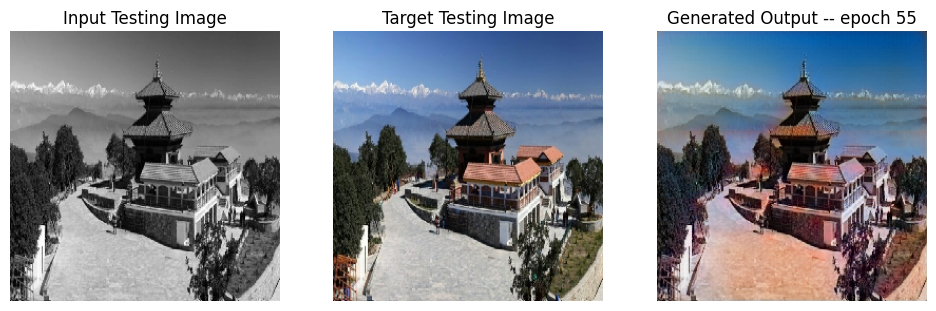

SSIM Score: [0.92903596]
PSNR Score: [22.053556]
Epoch 55
Training Details
Generator-- total_loss:35.71356 gan_loss:27.35838 l1_loss:0.04960 perceptual_loss:0.00610 Discriminator-- total_loss:0.22921 real_loss:0.13724 generated_loss:0.09197 --- SSIM 0.93328 PSNR 23.64235 LPIPS 0.00000
Time taken for epoch 56 is 428.768271446228 sec
Number of iteration 525
Validation Details
Generator-- total_loss:9.92293 gan_loss:0.00259 l1_loss:0.05737  perceptual_loss:0.00877 Discriminator-- total_loss:12.49274 real_loss:12.48810 generated_loss:0.00465 --- SSIM 0.92763 PSNR 22.66017 LPIPS 0.00000
Time taken for epoch 56 is 473.2714340686798 sec
Number of iteration 70
Displaying one random test image...


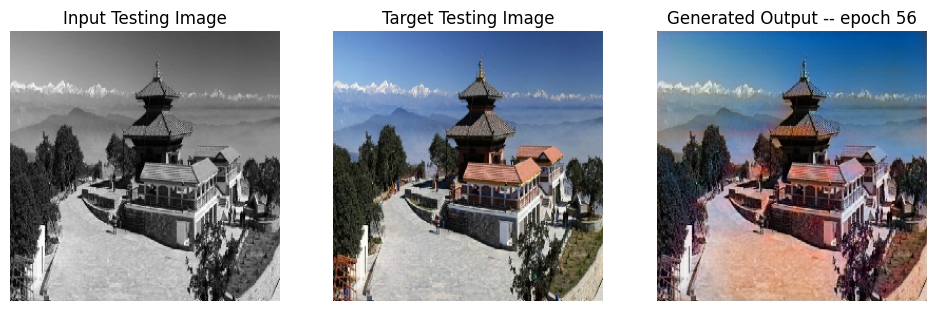

SSIM Score: [0.92951226]
PSNR Score: [22.121304]
Epoch 56
Training Details
Generator-- total_loss:36.83559 gan_loss:28.48038 l1_loss:0.04960 perceptual_loss:0.00610 Discriminator-- total_loss:0.00053 real_loss:0.00023 generated_loss:0.00030 --- SSIM 0.93354 PSNR 23.62021 LPIPS 0.00000
Time taken for epoch 57 is 419.98414731025696 sec
Number of iteration 525
Validation Details
Generator-- total_loss:9.94979 gan_loss:0.00526 l1_loss:0.05758  perceptual_loss:0.00872 Discriminator-- total_loss:13.98500 real_loss:13.97300 generated_loss:0.01200 --- SSIM 0.92831 PSNR 22.63488 LPIPS 0.00000
Time taken for epoch 57 is 501.9738960266113 sec
Number of iteration 70
Displaying one random test image...


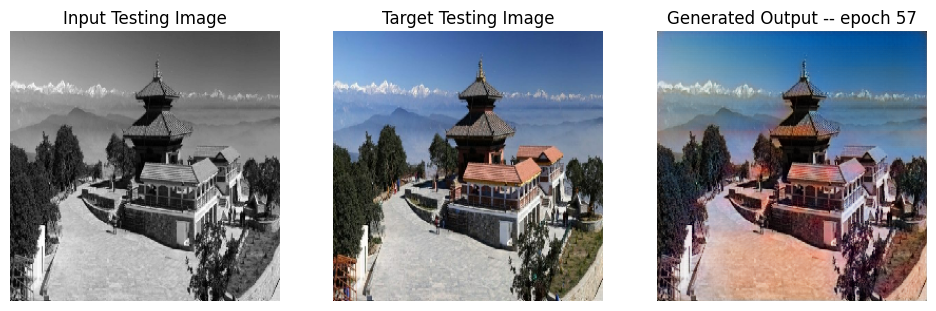

SSIM Score: [0.929712]
PSNR Score: [22.116049]
Epoch 57
Training Details
Generator-- total_loss:35.30312 gan_loss:26.93778 l1_loss:0.04962 perceptual_loss:0.00615 Discriminator-- total_loss:0.00057 real_loss:0.00032 generated_loss:0.00026 --- SSIM 0.93334 PSNR 23.62644 LPIPS 0.00000
Time taken for epoch 58 is 420.98748302459717 sec
Number of iteration 525
Validation Details
Generator-- total_loss:9.94716 gan_loss:0.00214 l1_loss:0.05753  perceptual_loss:0.00877 Discriminator-- total_loss:13.11624 real_loss:13.11289 generated_loss:0.00335 --- SSIM 0.92783 PSNR 22.63948 LPIPS 0.00000
Time taken for epoch 58 is 465.6071832180023 sec
Number of iteration 70
Displaying one random test image...


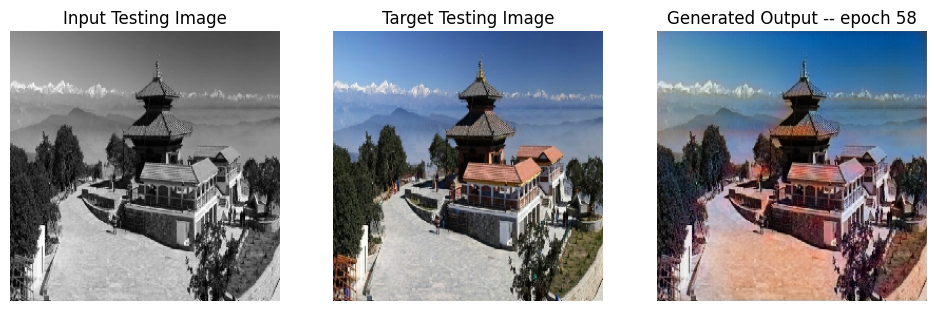

SSIM Score: [0.929082]
PSNR Score: [22.05488]
Epoch 58
Training Details
Generator-- total_loss:35.94938 gan_loss:27.60209 l1_loss:0.04954 perceptual_loss:0.00610 Discriminator-- total_loss:0.01066 real_loss:0.01054 generated_loss:0.00012 --- SSIM 0.93347 PSNR 23.63218 LPIPS 0.00000
Time taken for epoch 59 is 420.82092785835266 sec
Number of iteration 525
Validation Details
Generator-- total_loss:29.86725 gan_loss:19.92170 l1_loss:0.05754  perceptual_loss:0.00877 Discriminator-- total_loss:57.94072 real_loss:3.76410 generated_loss:54.17662 --- SSIM 0.92784 PSNR 22.63600 LPIPS 0.00000
Time taken for epoch 59 is 466.03826880455017 sec
Number of iteration 70
Displaying one random test image...


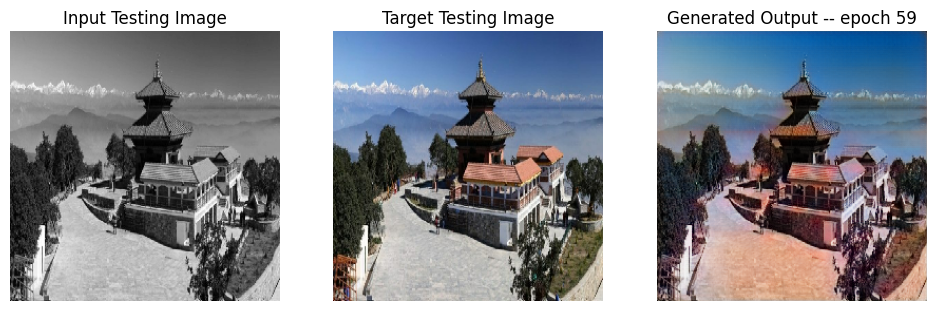

SSIM Score: [0.93009967]
PSNR Score: [22.107319]
Epoch 59
Training Details
Generator-- total_loss:37.76720 gan_loss:29.39105 l1_loss:0.04969 perceptual_loss:0.00615 Discriminator-- total_loss:0.22436 real_loss:0.06874 generated_loss:0.15563 --- SSIM 0.93285 PSNR 23.60674 LPIPS 0.00000
Time taken for epoch 60 is 420.71573305130005 sec
Number of iteration 525
Validation Details
Generator-- total_loss:9.91780 gan_loss:0.01096 l1_loss:0.05727  perceptual_loss:0.00878 Discriminator-- total_loss:11.57819 real_loss:11.56658 generated_loss:0.01161 --- SSIM 0.92761 PSNR 22.66910 LPIPS 0.00000
Time taken for epoch 60 is 465.5366268157959 sec
Number of iteration 70
Displaying one random test image...


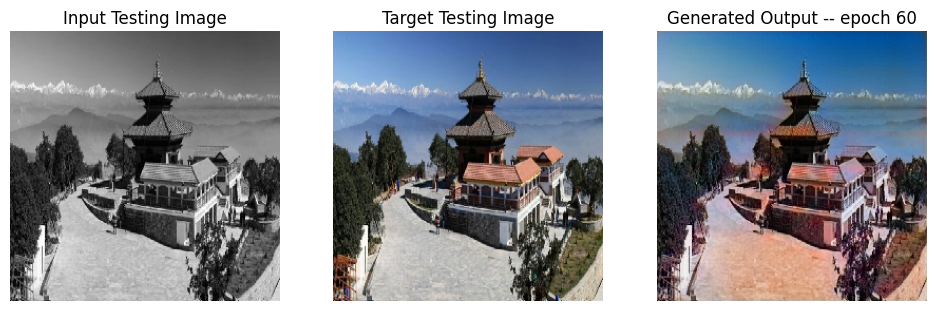

SSIM Score: [0.92973477]
PSNR Score: [22.156162]
Epoch 60
Training Details
Generator-- total_loss:37.05687 gan_loss:28.70595 l1_loss:0.04952 perceptual_loss:0.00615 Discriminator-- total_loss:0.00034 real_loss:0.00015 generated_loss:0.00019 --- SSIM 0.93351 PSNR 23.64528 LPIPS 0.00000
Time taken for epoch 61 is 420.20250606536865 sec
Number of iteration 525
Validation Details
Generator-- total_loss:9.92313 gan_loss:0.00329 l1_loss:0.05733  perceptual_loss:0.00880 Discriminator-- total_loss:12.10234 real_loss:12.08229 generated_loss:0.02005 --- SSIM 0.92806 PSNR 22.65182 LPIPS 0.00000
Time taken for epoch 61 is 464.86411023139954 sec
Number of iteration 70
Displaying one random test image...


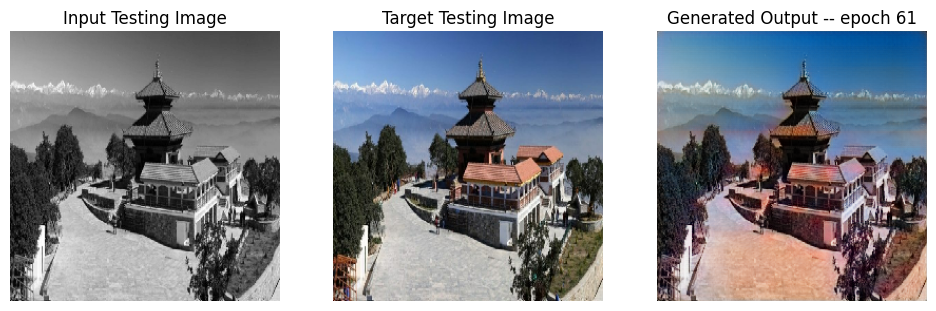

SSIM Score: [0.9297474]
PSNR Score: [22.119446]
Epoch 61
Training Details
Generator-- total_loss:38.51480 gan_loss:30.17574 l1_loss:0.04954 perceptual_loss:0.00606 Discriminator-- total_loss:0.04986 real_loss:0.03501 generated_loss:0.01485 --- SSIM 0.93395 PSNR 23.64737 LPIPS 0.00000
Time taken for epoch 62 is 418.3216757774353 sec
Number of iteration 525
Validation Details
Generator-- total_loss:10.16010 gan_loss:0.15895 l1_loss:0.05791  perceptual_loss:0.00876 Discriminator-- total_loss:7.46099 real_loss:7.35486 generated_loss:0.10613 --- SSIM 0.92800 PSNR 22.58720 LPIPS 0.00000
Time taken for epoch 62 is 463.02120184898376 sec
Number of iteration 70
Displaying one random test image...


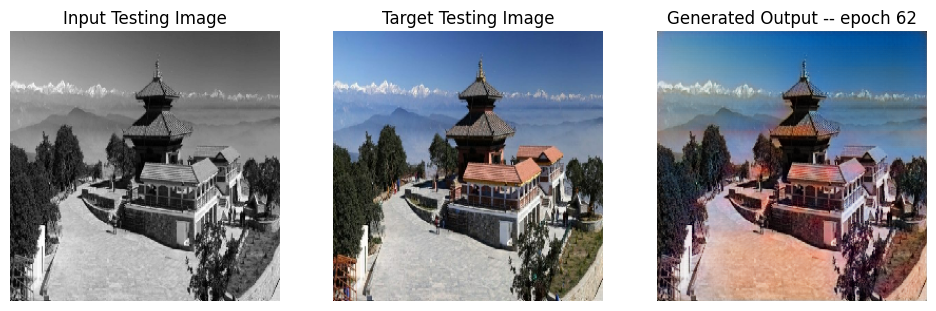

SSIM Score: [0.92881066]
PSNR Score: [21.994232]
Epoch 62
Training Details
Generator-- total_loss:38.14876 gan_loss:29.78183 l1_loss:0.04966 perceptual_loss:0.00612 Discriminator-- total_loss:0.04230 real_loss:0.01010 generated_loss:0.03220 --- SSIM 0.93343 PSNR 23.62815 LPIPS 0.00000
Time taken for epoch 63 is 421.1837339401245 sec
Number of iteration 525
Validation Details
Generator-- total_loss:9.97118 gan_loss:0.01355 l1_loss:0.05765  perceptual_loss:0.00873 Discriminator-- total_loss:9.43496 real_loss:9.42796 generated_loss:0.00700 --- SSIM 0.92815 PSNR 22.63577 LPIPS 0.00000
Time taken for epoch 63 is 465.8718066215515 sec
Number of iteration 70
Displaying one random test image...


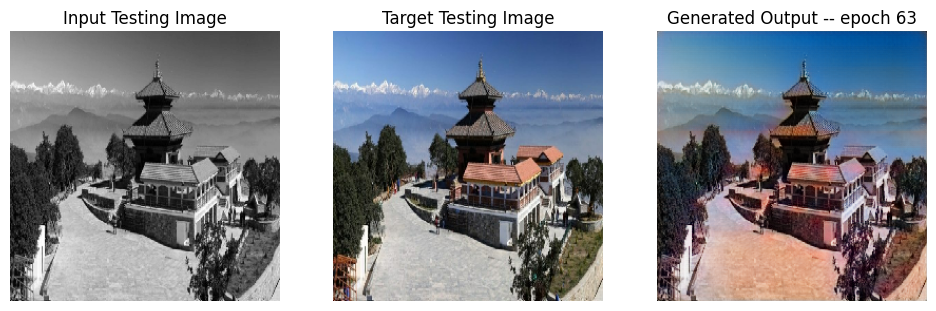

SSIM Score: [0.9291164]
PSNR Score: [22.046682]
Epoch 63
Training Details
Generator-- total_loss:37.12104 gan_loss:28.76284 l1_loss:0.04957 perceptual_loss:0.00615 Discriminator-- total_loss:0.00104 real_loss:0.00054 generated_loss:0.00050 --- SSIM 0.93341 PSNR 23.62715 LPIPS 0.00000
Time taken for epoch 64 is 420.2456908226013 sec
Number of iteration 525
Validation Details
Generator-- total_loss:9.99137 gan_loss:0.01249 l1_loss:0.05771  perceptual_loss:0.00881 Discriminator-- total_loss:13.68339 real_loss:13.67874 generated_loss:0.00465 --- SSIM 0.92799 PSNR 22.63206 LPIPS 0.00000
Time taken for epoch 64 is 465.09711241722107 sec
Number of iteration 70
Displaying one random test image...


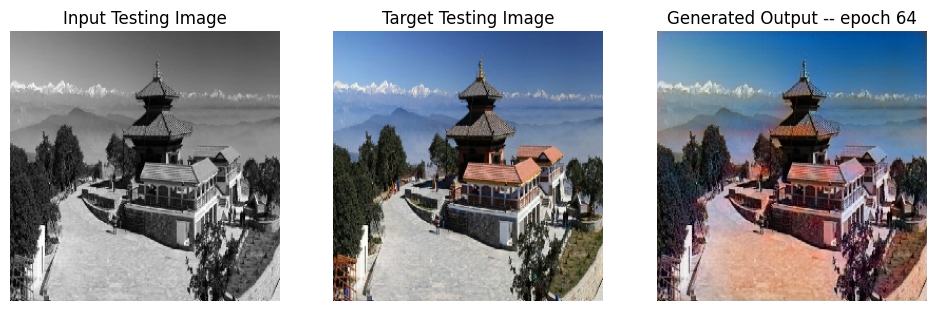

SSIM Score: [0.9289976]
PSNR Score: [22.015116]
Epoch 64
Training Details
Generator-- total_loss:39.56528 gan_loss:31.21068 l1_loss:0.04955 perceptual_loss:0.00615 Discriminator-- total_loss:0.00732 real_loss:0.00426 generated_loss:0.00305 --- SSIM 0.93342 PSNR 23.64447 LPIPS 0.00000
Time taken for epoch 65 is 419.91628241539 sec
Number of iteration 525
Validation Details
Generator-- total_loss:9.98238 gan_loss:0.08259 l1_loss:0.05731  perceptual_loss:0.00869 Discriminator-- total_loss:10.28060 real_loss:10.25022 generated_loss:0.03039 --- SSIM 0.92816 PSNR 22.67352 LPIPS 0.00000
Time taken for epoch 65 is 464.6239581108093 sec
Number of iteration 70
Displaying one random test image...


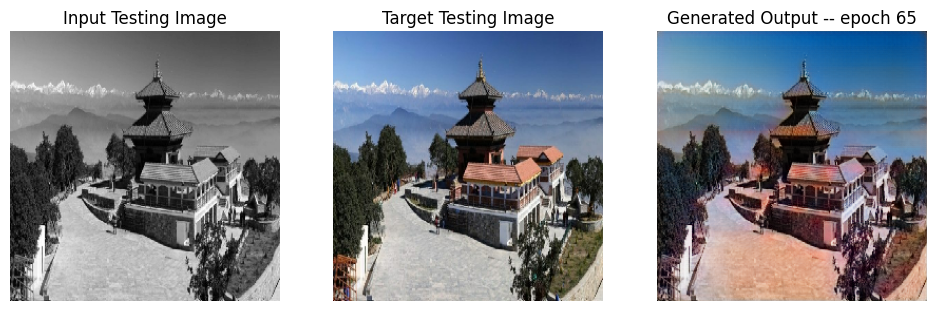

SSIM Score: [0.92981166]
PSNR Score: [22.144688]
Epoch 65
Training Details
Generator-- total_loss:42.17759 gan_loss:33.80281 l1_loss:0.04971 perceptual_loss:0.00612 Discriminator-- total_loss:0.00058 real_loss:0.00026 generated_loss:0.00032 --- SSIM 0.93355 PSNR 23.60863 LPIPS 0.00000
Time taken for epoch 66 is 419.6954610347748 sec
Number of iteration 525
Validation Details
Generator-- total_loss:9.97452 gan_loss:0.02728 l1_loss:0.05751  perceptual_loss:0.00881 Discriminator-- total_loss:13.14260 real_loss:13.13164 generated_loss:0.01095 --- SSIM 0.92846 PSNR 22.65445 LPIPS 0.00000
Time taken for epoch 66 is 464.36517095565796 sec
Number of iteration 70
Displaying one random test image...


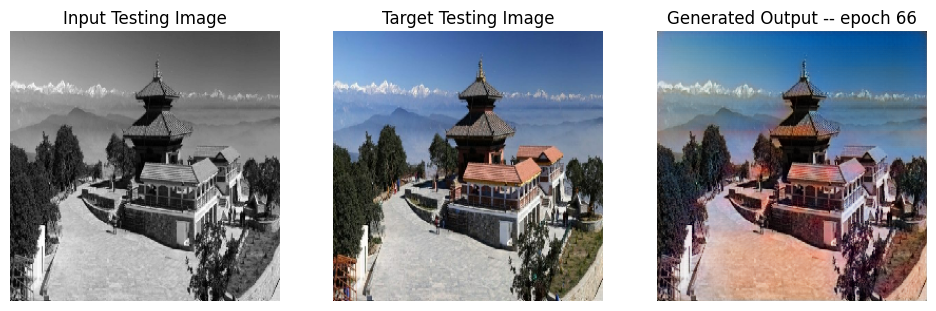

SSIM Score: [0.93003577]
PSNR Score: [22.115683]
Epoch 66
Training Details
Generator-- total_loss:41.93769 gan_loss:33.58356 l1_loss:0.04954 perceptual_loss:0.00616 Discriminator-- total_loss:0.00008 real_loss:0.00003 generated_loss:0.00005 --- SSIM 0.93292 PSNR 23.64607 LPIPS 0.00000
Time taken for epoch 67 is 419.84926772117615 sec
Number of iteration 525
Validation Details
Generator-- total_loss:9.99752 gan_loss:0.00191 l1_loss:0.05787  perceptual_loss:0.00876 Discriminator-- total_loss:14.40596 real_loss:14.40302 generated_loss:0.00294 --- SSIM 0.92778 PSNR 22.60514 LPIPS 0.00000
Time taken for epoch 67 is 464.06770372390747 sec
Number of iteration 70
Displaying one random test image...


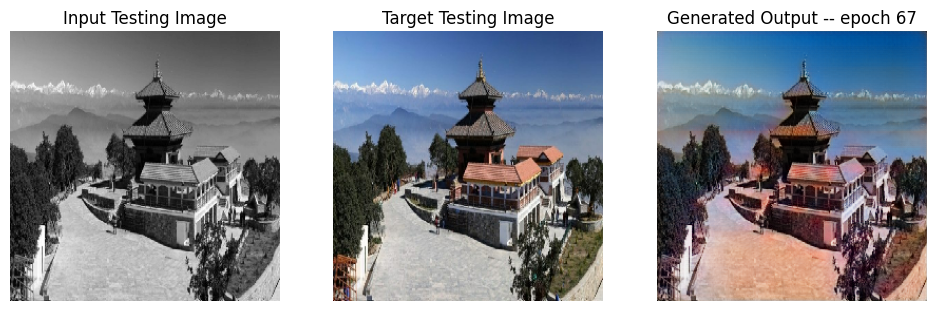

SSIM Score: [0.9287264]
PSNR Score: [21.990322]
Epoch 67
Training Details
Generator-- total_loss:42.40456 gan_loss:34.03062 l1_loss:0.04967 perceptual_loss:0.00615 Discriminator-- total_loss:0.00003 real_loss:0.00002 generated_loss:0.00002 --- SSIM 0.93320 PSNR 23.62176 LPIPS 0.00000
Time taken for epoch 68 is 419.11235094070435 sec
Number of iteration 525
Validation Details
Generator-- total_loss:9.94637 gan_loss:0.00214 l1_loss:0.05755  perceptual_loss:0.00874 Discriminator-- total_loss:14.31843 real_loss:14.31517 generated_loss:0.00326 --- SSIM 0.92763 PSNR 22.64706 LPIPS 0.00000
Time taken for epoch 68 is 463.38644456863403 sec
Number of iteration 70
Displaying one random test image...


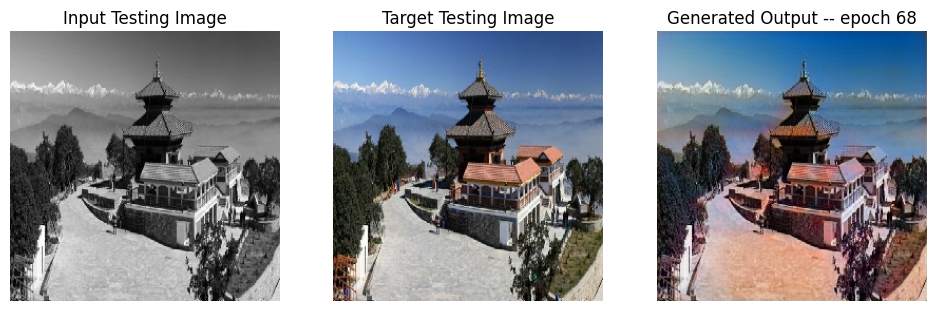

SSIM Score: [0.9299266]
PSNR Score: [22.124844]
Epoch 68
Training Details
Generator-- total_loss:41.58867 gan_loss:33.20995 l1_loss:0.04970 perceptual_loss:0.00616 Discriminator-- total_loss:0.00004 real_loss:0.00001 generated_loss:0.00003 --- SSIM 0.93330 PSNR 23.60756 LPIPS 0.00000
Time taken for epoch 69 is 420.5119876861572 sec
Number of iteration 525
Validation Details
Generator-- total_loss:9.96706 gan_loss:0.00056 l1_loss:0.05767  perceptual_loss:0.00878 Discriminator-- total_loss:15.66951 real_loss:15.66747 generated_loss:0.00204 --- SSIM 0.92777 PSNR 22.62425 LPIPS 0.00000
Time taken for epoch 69 is 465.26695370674133 sec
Number of iteration 70
Displaying one random test image...


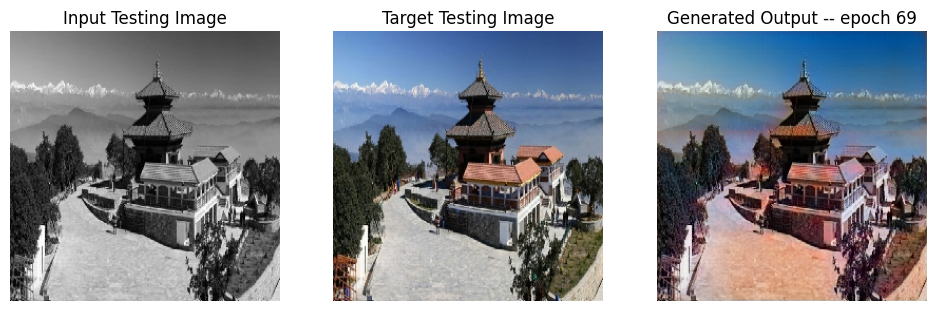

SSIM Score: [0.92939854]
PSNR Score: [22.021778]
Reduced generator learning rate to 0.0004500000213738531 at epoch 69
Epoch 69
Training Details
Generator-- total_loss:7.20181 gan_loss:0.07054 l1_loss:0.04154 perceptual_loss:0.00601 Discriminator-- total_loss:28.09247 real_loss:28.09237 generated_loss:0.00010 --- SSIM 0.94486 PSNR 25.03100 LPIPS 0.00000
Time taken for epoch 70 is 560.9027993679047 sec
Number of iteration 525
Validation Details
Generator-- total_loss:9.01284 gan_loss:0.00002 l1_loss:0.05094  perceptual_loss:0.00915 Discriminator-- total_loss:22.88283 real_loss:22.88282 generated_loss:0.00001 --- SSIM 0.94100 PSNR 23.47073 LPIPS 0.00000
Time taken for epoch 70 is 605.314234495163 sec
Number of iteration 70
Displaying one random test image...


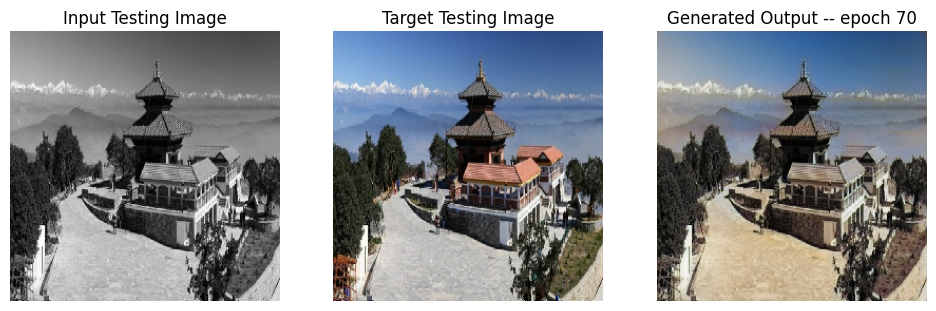

SSIM Score: [0.9608102]
PSNR Score: [24.183823]
Epoch 70
Training Details
Generator-- total_loss:6.87322 gan_loss:0.00225 l1_loss:0.04009 perceptual_loss:0.00572 Discriminator-- total_loss:27.72360 real_loss:27.72346 generated_loss:0.00014 --- SSIM 0.95035 PSNR 25.35013 LPIPS 0.00000
Time taken for epoch 71 is 558.64763712883 sec
Number of iteration 525
Validation Details
Generator-- total_loss:11.25674 gan_loss:0.00001 l1_loss:0.06497  perceptual_loss:0.01008 Discriminator-- total_loss:54.28384 real_loss:54.28383 generated_loss:0.00000 --- SSIM 0.92133 PSNR 21.34392 LPIPS 0.00000
Time taken for epoch 71 is 603.3556015491486 sec
Number of iteration 70
Displaying one random test image...


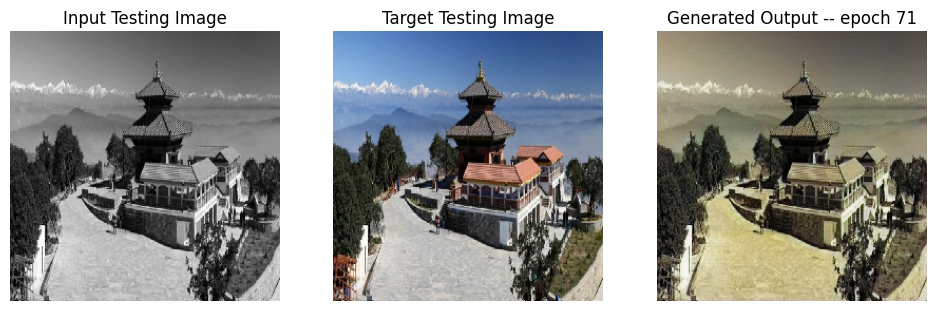

SSIM Score: [0.9367613]
PSNR Score: [18.51443]
Epoch 71
Training Details
Generator-- total_loss:6.89081 gan_loss:0.00244 l1_loss:0.04012 perceptual_loss:0.00580 Discriminator-- total_loss:29.22841 real_loss:29.22840 generated_loss:0.00002 --- SSIM 0.95057 PSNR 25.31256 LPIPS 0.00000
Time taken for epoch 72 is 557.8819682598114 sec
Number of iteration 525
Validation Details
Generator-- total_loss:10.90895 gan_loss:0.00001 l1_loss:0.06270  perceptual_loss:0.01002 Discriminator-- total_loss:31.31629 real_loss:31.31629 generated_loss:0.00001 --- SSIM 0.93184 PSNR 21.67702 LPIPS 0.00000
Time taken for epoch 72 is 602.3532586097717 sec
Number of iteration 70
Displaying one random test image...


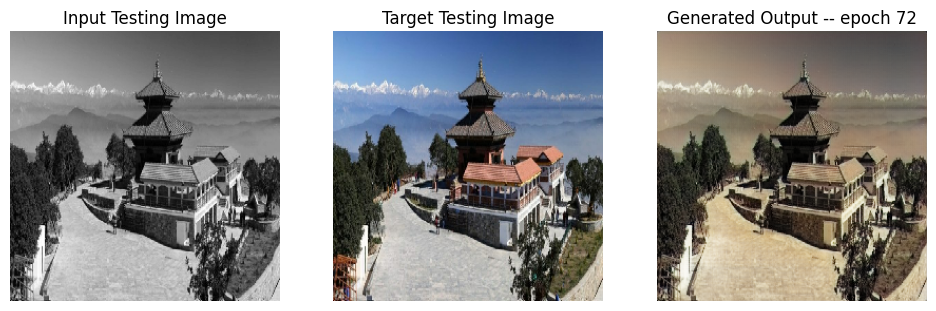

SSIM Score: [0.94406503]
PSNR Score: [18.625614]
Epoch 72
Training Details
Generator-- total_loss:6.84933 gan_loss:0.00078 l1_loss:0.03997 perceptual_loss:0.00569 Discriminator-- total_loss:25.50046 real_loss:25.50046 generated_loss:0.00000 --- SSIM 0.95146 PSNR 25.37260 LPIPS 0.00000
Time taken for epoch 73 is 560.0057401657104 sec
Number of iteration 525
Validation Details
Generator-- total_loss:8.80867 gan_loss:0.00001 l1_loss:0.04982  perceptual_loss:0.00890 Discriminator-- total_loss:28.19497 real_loss:28.19496 generated_loss:0.00001 --- SSIM 0.94391 PSNR 23.66816 LPIPS 0.00000
Time taken for epoch 73 is 604.9239156246185 sec
Number of iteration 70
Displaying one random test image...


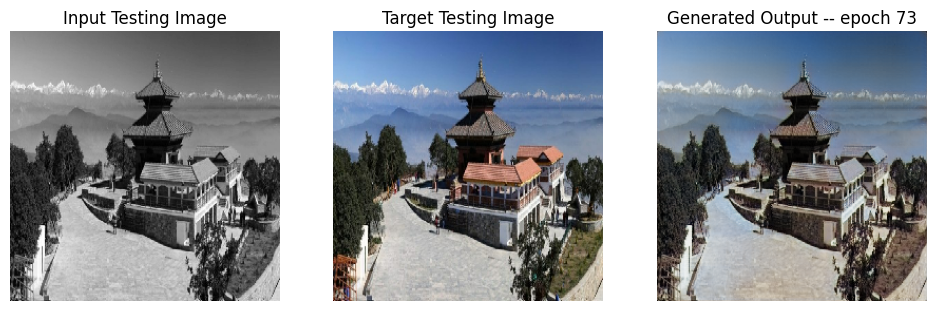

SSIM Score: [0.9658591]
PSNR Score: [25.860052]
Epoch 73
Training Details
Generator-- total_loss:6.76136 gan_loss:0.00133 l1_loss:0.03946 perceptual_loss:0.00560 Discriminator-- total_loss:25.88793 real_loss:25.88759 generated_loss:0.00033 --- SSIM 0.95196 PSNR 25.47073 LPIPS 0.00000
Time taken for epoch 74 is 560.6409966945648 sec
Number of iteration 525
Validation Details
Generator-- total_loss:10.47513 gan_loss:0.00001 l1_loss:0.05895  perceptual_loss:0.01088 Discriminator-- total_loss:56.94094 real_loss:56.94094 generated_loss:0.00001 --- SSIM 0.91849 PSNR 21.83192 LPIPS 0.00000
Time taken for epoch 74 is 605.072662115097 sec
Number of iteration 70
Displaying one random test image...


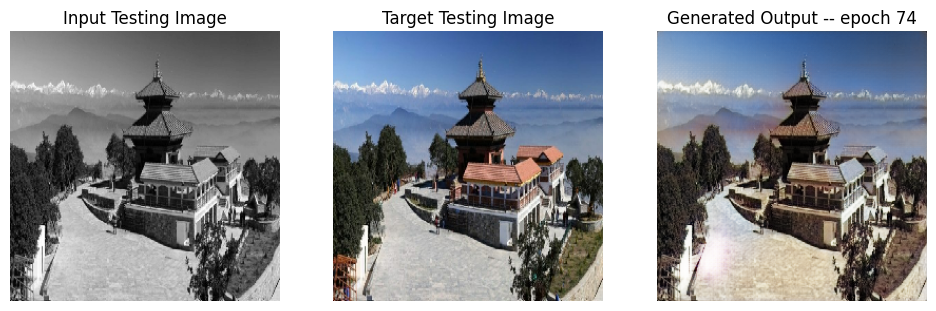

SSIM Score: [0.95167017]
PSNR Score: [24.664738]
Epoch 74
Training Details
Generator-- total_loss:6.73489 gan_loss:0.00114 l1_loss:0.03933 perceptual_loss:0.00556 Discriminator-- total_loss:26.07225 real_loss:26.07224 generated_loss:0.00001 --- SSIM 0.95267 PSNR 25.47841 LPIPS 0.00000
Time taken for epoch 75 is 561.2931244373322 sec
Number of iteration 525
Validation Details
Generator-- total_loss:8.68822 gan_loss:0.00000 l1_loss:0.04947  perceptual_loss:0.00845 Discriminator-- total_loss:32.66916 real_loss:32.66915 generated_loss:0.00001 --- SSIM 0.94473 PSNR 23.71222 LPIPS 0.00000
Time taken for epoch 75 is 605.8613541126251 sec
Number of iteration 70
Displaying one random test image...


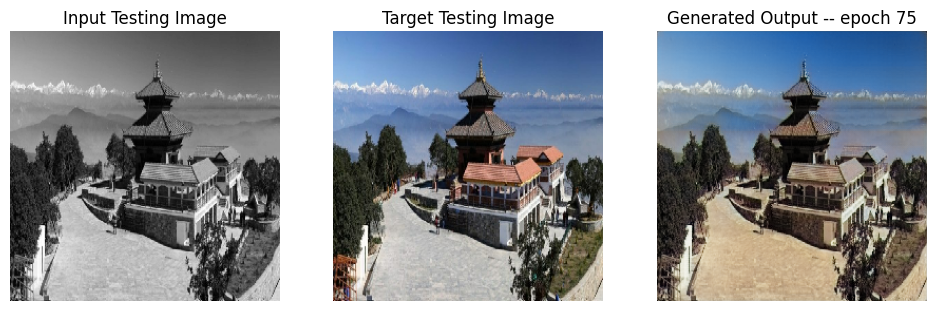

SSIM Score: [0.96156406]
PSNR Score: [24.573]
Epoch 75
Training Details
Generator-- total_loss:6.78455 gan_loss:0.00268 l1_loss:0.03960 perceptual_loss:0.00561 Discriminator-- total_loss:27.93539 real_loss:27.93537 generated_loss:0.00002 --- SSIM 0.95159 PSNR 25.42370 LPIPS 0.00000
Time taken for epoch 76 is 562.0144243240356 sec
Number of iteration 525
Validation Details
Generator-- total_loss:10.71734 gan_loss:0.00001 l1_loss:0.06178  perceptual_loss:0.00967 Discriminator-- total_loss:31.21620 real_loss:31.21619 generated_loss:0.00001 --- SSIM 0.93431 PSNR 21.86482 LPIPS 0.00000
Time taken for epoch 76 is 606.6315078735352 sec
Number of iteration 70
Displaying one random test image...


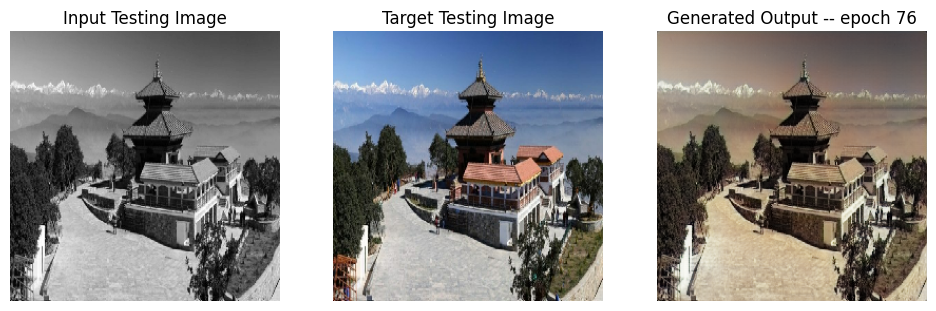

SSIM Score: [0.9448324]
PSNR Score: [18.626919]
Epoch 76
Training Details
Generator-- total_loss:6.70632 gan_loss:0.00116 l1_loss:0.03914 perceptual_loss:0.00556 Discriminator-- total_loss:25.74378 real_loss:25.74378 generated_loss:0.00001 --- SSIM 0.95321 PSNR 25.52488 LPIPS 0.00000
Time taken for epoch 77 is 561.6856367588043 sec
Number of iteration 525
Validation Details
Generator-- total_loss:9.28953 gan_loss:0.00001 l1_loss:0.05333  perceptual_loss:0.00860 Discriminator-- total_loss:25.49685 real_loss:25.49684 generated_loss:0.00001 --- SSIM 0.94139 PSNR 23.05186 LPIPS 0.00000
Time taken for epoch 77 is 606.4371058940887 sec
Number of iteration 70
Displaying one random test image...


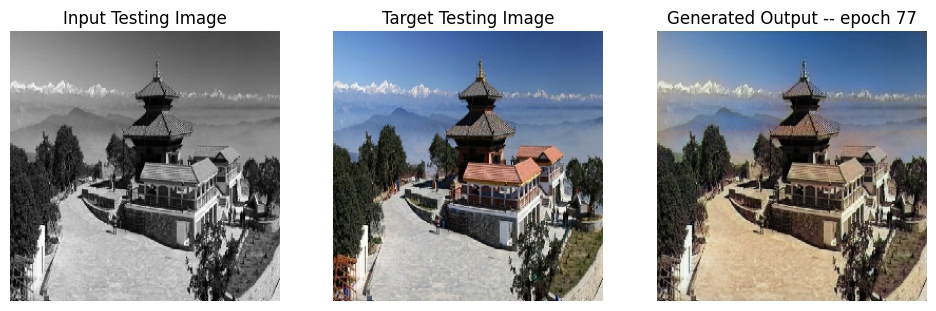

SSIM Score: [0.9635003]
PSNR Score: [24.704056]
Epoch 77
Training Details
Generator-- total_loss:6.70469 gan_loss:0.00074 l1_loss:0.03918 perceptual_loss:0.00552 Discriminator-- total_loss:24.91175 real_loss:24.91172 generated_loss:0.00003 --- SSIM 0.95283 PSNR 25.54392 LPIPS 0.00000
Time taken for epoch 78 is 561.8332850933075 sec
Number of iteration 525
Validation Details
Generator-- total_loss:8.19321 gan_loss:0.00001 l1_loss:0.04642  perceptual_loss:0.00820 Discriminator-- total_loss:28.13073 real_loss:28.13072 generated_loss:0.00001 --- SSIM 0.93940 PSNR 24.15700 LPIPS 0.00000
Time taken for epoch 78 is 606.7382011413574 sec
Number of iteration 70
Displaying one random test image...


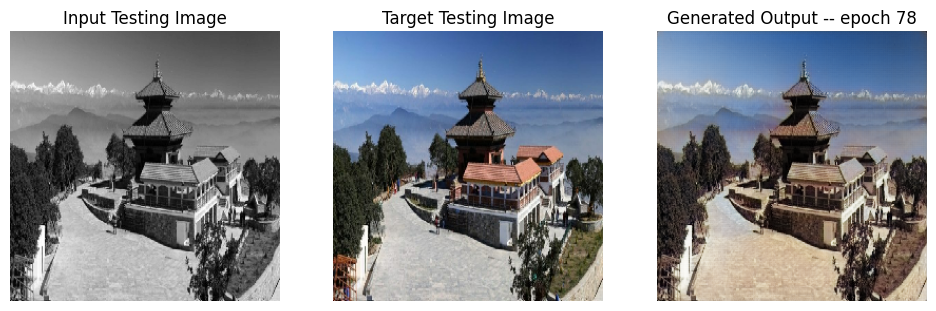

SSIM Score: [0.95813423]
PSNR Score: [26.25132]
Epoch 78
Training Details
Generator-- total_loss:6.74156 gan_loss:0.00170 l1_loss:0.03940 perceptual_loss:0.00553 Discriminator-- total_loss:27.73653 real_loss:27.73653 generated_loss:0.00001 --- SSIM 0.95274 PSNR 25.50523 LPIPS 0.00000
Time taken for epoch 79 is 561.7976071834564 sec
Number of iteration 525
Validation Details
Generator-- total_loss:9.01097 gan_loss:0.00000 l1_loss:0.05141  perceptual_loss:0.00867 Discriminator-- total_loss:31.46643 real_loss:31.46642 generated_loss:0.00001 --- SSIM 0.94065 PSNR 23.27562 LPIPS 0.00000
Time taken for epoch 79 is 606.5133278369904 sec
Number of iteration 70
Displaying one random test image...


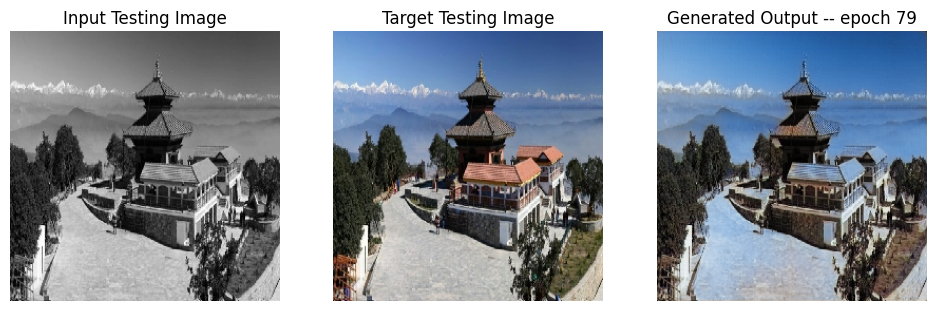

SSIM Score: [0.95882106]
PSNR Score: [24.420368]
Epoch 79
Training Details
Generator-- total_loss:6.63277 gan_loss:0.00087 l1_loss:0.03874 perceptual_loss:0.00547 Discriminator-- total_loss:25.52013 real_loss:25.52008 generated_loss:0.00005 --- SSIM 0.95325 PSNR 25.61935 LPIPS 0.00000
Time taken for epoch 80 is 561.4766337871552 sec
Number of iteration 525
Validation Details
Generator-- total_loss:8.07598 gan_loss:0.00002 l1_loss:0.04572  perceptual_loss:0.00812 Discriminator-- total_loss:27.48484 real_loss:27.48483 generated_loss:0.00001 --- SSIM 0.94296 PSNR 24.22144 LPIPS 0.00000
Time taken for epoch 80 is 606.2931716442108 sec
Number of iteration 70
Displaying one random test image...


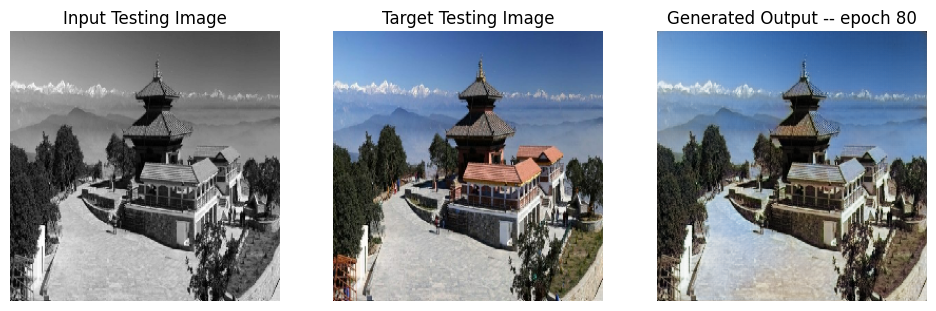

SSIM Score: [0.9660098]
PSNR Score: [27.093147]


In [50]:
fit(train_dataset, epochs, validation_dataset, gen)

/tmp/ipykernel_26/1385076028.py:4: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-or" (-> color='r'). The keyword argument will take precedence.
  plt.plot(epochs, train_discriminator_losses, '-or', color='orange', label='Discriminator Loss')


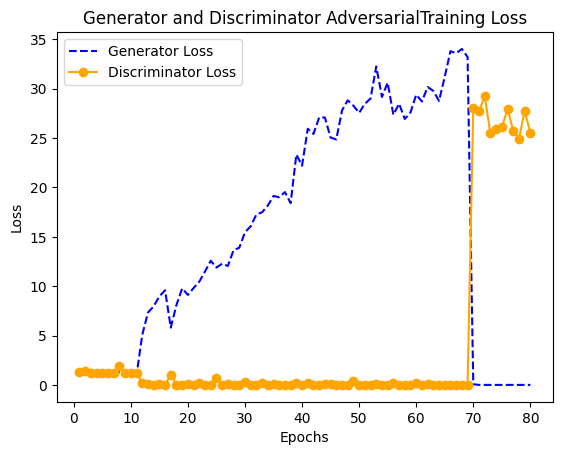

In [51]:
epochs = range(1, len(train_generator_losses) + 1)

plt.plot(epochs, train_generator_gan_losses, '--b', label='Generator Loss')
plt.plot(epochs, train_discriminator_losses, '-or', color='orange', label='Discriminator Loss')
plt.title('Generator and Discriminator AdversarialTraining Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.savefig('/kaggle/working/train_loss_plot_1.png')
plt.show()

/tmp/ipykernel_26/4010479747.py:4: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-or" (-> color='r'). The keyword argument will take precedence.
  plt.plot(epochs, test_discriminator_losses, '-or', color='orange', label='Discriminator Loss')


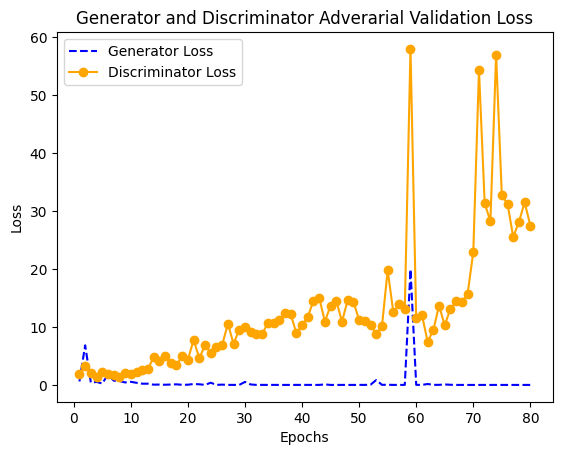

In [52]:
epochs = range(1, len(test_generator_losses) + 1)

plt.plot(epochs, test_generator_gan_losses, '--b', label='Generator Loss')
plt.plot(epochs, test_discriminator_losses, '-or', color='orange', label='Discriminator Loss')
plt.title('Generator and Discriminator Adverarial Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.savefig('/kaggle/working/test_loss_plot_1.png')
plt.show()

/tmp/ipykernel_26/825315398.py:4: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-or" (-> color='r'). The keyword argument will take precedence.
  plt.plot(epochs, testing_ssim, '-or', color='orange', label='Validation SSIM')


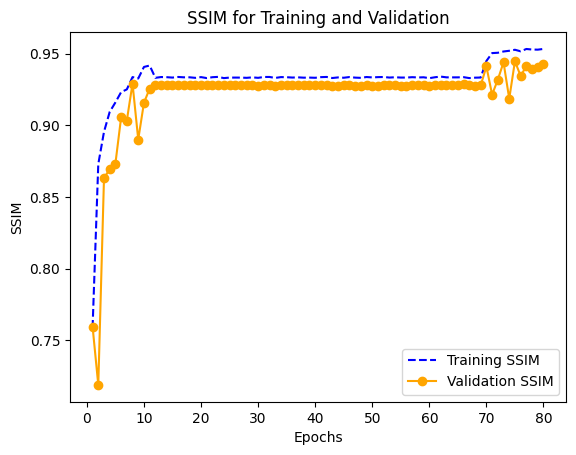

In [53]:
epochs = range(1, len(train_generator_losses) + 1)

plt.plot(epochs, training_ssim, '--b', label='Training SSIM')
plt.plot(epochs, testing_ssim, '-or', color='orange', label='Validation SSIM')
plt.title('SSIM for Training and Validation')
plt.xlabel('Epochs')
plt.ylabel('SSIM')
plt.legend()
plt.savefig('/kaggle/working/SSIM_plot_1.png')
plt.show()

/tmp/ipykernel_26/1818322218.py:4: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-or" (-> color='r'). The keyword argument will take precedence.
  plt.plot(epochs, testing_psnr, '-or', color='orange', label='Validation PSNR')


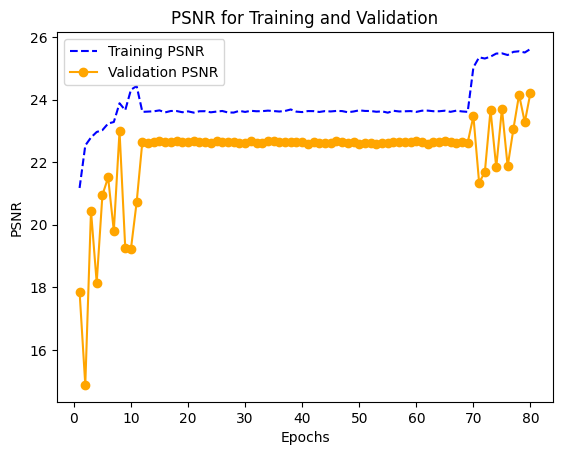

In [54]:
epochs = range(1, len(train_generator_losses) + 1)

plt.plot(epochs, training_psnr, '--b', label='Training PSNR')
plt.plot(epochs, testing_psnr, '-or', color='orange', label='Validation PSNR')
plt.title('PSNR for Training and Validation')
plt.xlabel('Epochs')
plt.ylabel('PSNR')
plt.legend()
plt.savefig('/kaggle/working/PSNR_plot_1.png')
plt.show()

/tmp/ipykernel_26/136468053.py:4: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-or" (-> color='r'). The keyword argument will take precedence.
  plt.plot(epochs, testing_lpips, '-or', color='orange', label='Validation LPIPS')


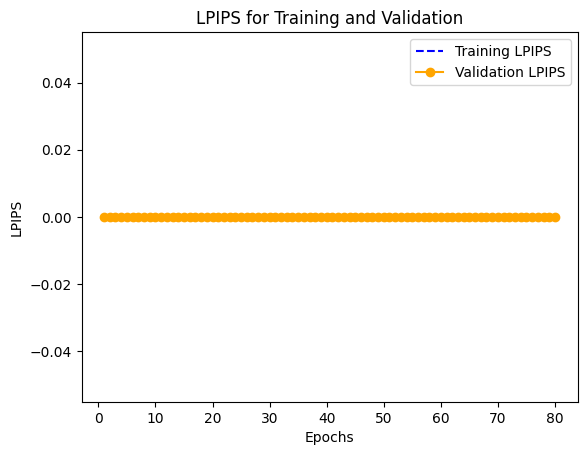

In [55]:
epochs = range(1, len(train_generator_losses) + 1)

plt.plot(epochs, training_lpips, '--b', label='Training LPIPS')
plt.plot(epochs, testing_lpips, '-or', color='orange', label='Validation LPIPS')
plt.title('LPIPS for Training and Validation')
plt.xlabel('Epochs')
plt.ylabel('LPIPS')
plt.legend()
plt.savefig('/kaggle/working/LPIPS_plot_1.png')
plt.show()

/tmp/ipykernel_26/3235268261.py:4: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-or" (-> color='r'). The keyword argument will take precedence.
  plt.plot(epochs, test_generator_gan_losses,'-or', color='orange', label='Validation_Generator_GAN_Loss')


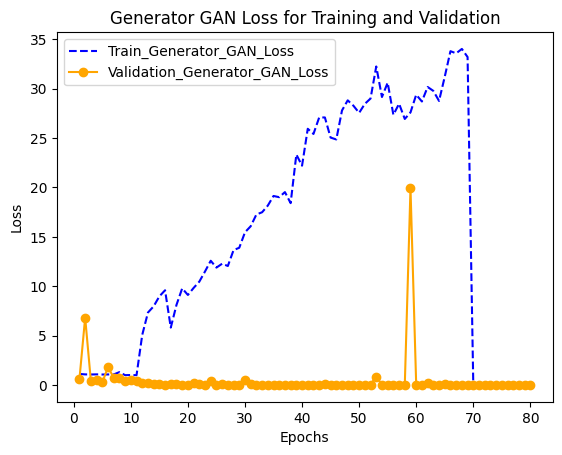

In [56]:
epochs = range(1, len(train_generator_losses) + 1)

plt.plot(epochs, train_generator_gan_losses, '--b', label='Train_Generator_GAN_Loss')
plt.plot(epochs, test_generator_gan_losses,'-or', color='orange', label='Validation_Generator_GAN_Loss')
plt.title('Generator GAN Loss for Training and Validation')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.savefig('/kaggle/working/Gen_GAN_plot_1.png')
plt.show()

/tmp/ipykernel_26/271018654.py:4: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-or" (-> color='r'). The keyword argument will take precedence.
  plt.plot(epochs, test_generator_l1_losses, '-or', color='orange', label='Validation_Generator_L1_Loss')


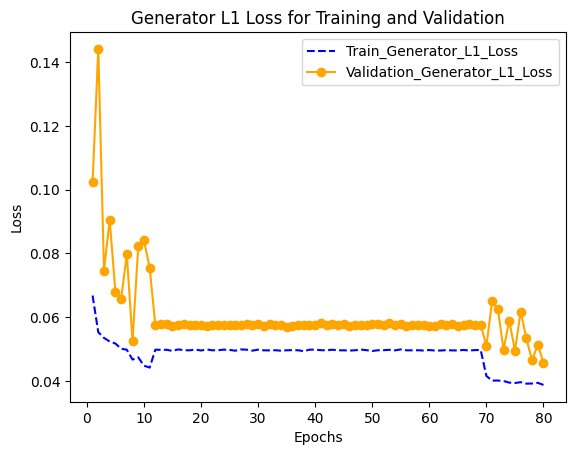

In [57]:
epochs = range(1, len(train_generator_losses) + 1)

plt.plot(epochs, train_generator_l1_losses, '--b', label='Train_Generator_L1_Loss')
plt.plot(epochs, test_generator_l1_losses, '-or', color='orange', label='Validation_Generator_L1_Loss')
plt.title('Generator L1 Loss for Training and Validation')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.savefig('/kaggle/working/Gen_L1_plot_1.png')
plt.show()

/tmp/ipykernel_26/1114805691.py:4: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-or" (-> color='r'). The keyword argument will take precedence.
  plt.plot(epochs, test_generator_perceptual_losses, '-or', color='orange', label='Validation_Generator_Perceptual_Loss')


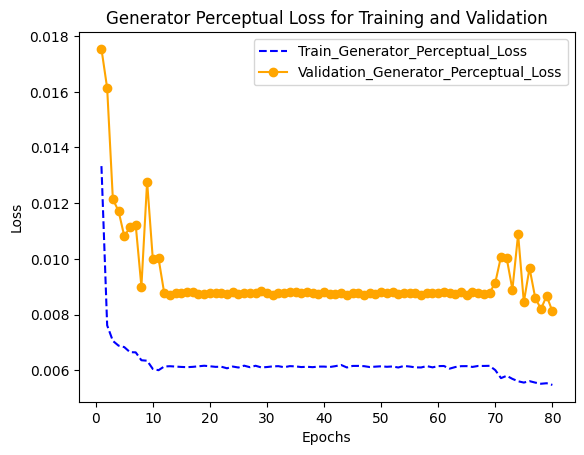

In [58]:
epochs = range(1, len(train_generator_losses) + 1)

plt.plot(epochs, train_generator_perceptual_losses, '--b', label='Train_Generator_Perceptual_Loss')
plt.plot(epochs, test_generator_perceptual_losses, '-or', color='orange', label='Validation_Generator_Perceptual_Loss')
plt.title('Generator Perceptual Loss for Training and Validation')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.savefig('/kaggle/working/Gen_Perceptual_plot_1.png')
plt.show()

/tmp/ipykernel_26/1582919640.py:4: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-or" (-> color='r'). The keyword argument will take precedence.
  plt.plot(epochs, test_generator_losses, '-or', color='orange', label='Validation_Generator_Loss')


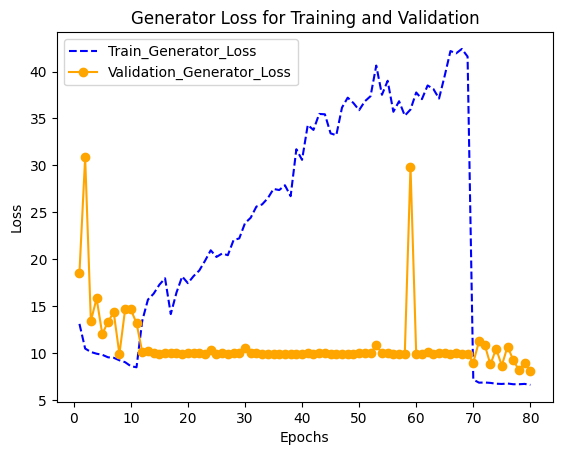

In [59]:
epochs = range(1, len(train_generator_losses) + 1)

plt.plot(epochs, train_generator_losses, '--b', label='Train_Generator_Loss')
plt.plot(epochs, test_generator_losses, '-or', color='orange', label='Validation_Generator_Loss')
plt.title('Generator Loss for Training and Validation')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.savefig('/kaggle/working/Gen_plot_1.png')
plt.show()

/tmp/ipykernel_26/1374437368.py:4: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-or" (-> color='r'). The keyword argument will take precedence.
  plt.plot(epochs, test_discriminator_losses, '-or', color='orange', label='Validation_Discriminator_Loss')


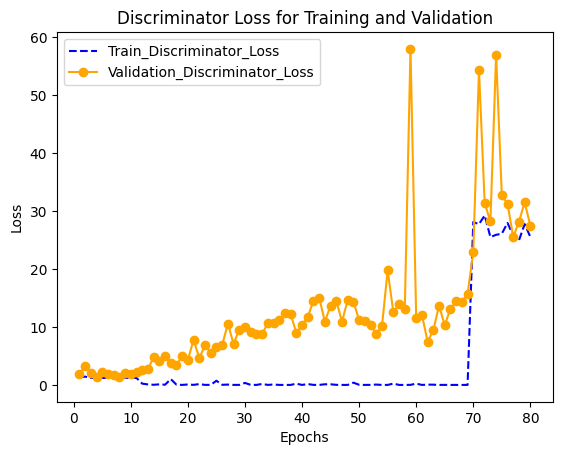

In [60]:
epochs = range(1, len(train_generator_losses) + 1)

plt.plot(epochs, train_discriminator_losses, '--b', label='Train_Discriminator_Loss')
plt.plot(epochs, test_discriminator_losses, '-or', color='orange', label='Validation_Discriminator_Loss')
plt.title('Discriminator Loss for Training and Validation')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.savefig('/kaggle/working/Disc_plot_1.png')
plt.show()

/tmp/ipykernel_26/1497767744.py:4: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-or" (-> color='r'). The keyword argument will take precedence.
  plt.plot(epochs, test_discriminator_real_losses, '-or', color='orange', label='Validation_Discriminator_Real_Loss')


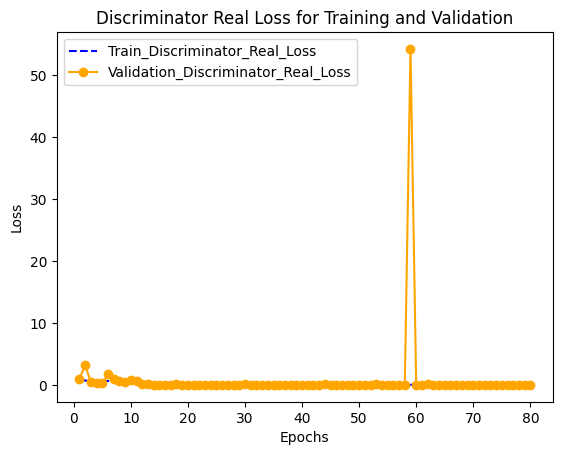

In [61]:
epochs = range(1, len(train_generator_losses) + 1)

plt.plot(epochs, train_discriminator_real_losses, '--b', label='Train_Discriminator_Real_Loss')
plt.plot(epochs, test_discriminator_real_losses, '-or', color='orange', label='Validation_Discriminator_Real_Loss')
plt.title('Discriminator Real Loss for Training and Validation')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.savefig('/kaggle/working/Disc_Real_plot_1.png')
plt.show()

/tmp/ipykernel_26/1197813443.py:4: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-or" (-> color='r'). The keyword argument will take precedence.
  plt.plot(epochs, test_discriminator_generated_losses,'-or', color='orange', label='Validation_Discriminator_Generated_Loss')


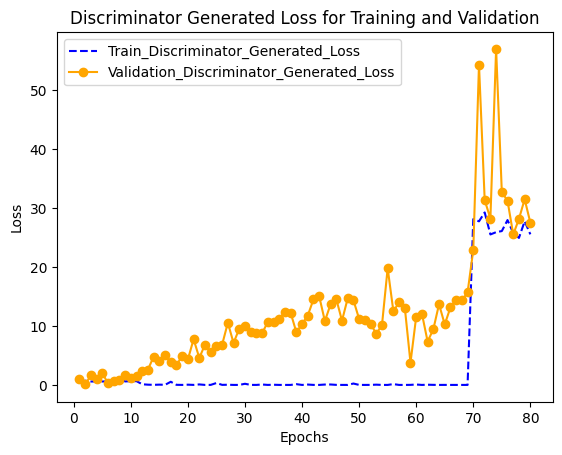

In [62]:
epochs = range(1, len(train_generator_losses) + 1)

plt.plot(epochs, train_discriminator_generated_losses, '--b', label='Train_Discriminator_Generated_Loss')
plt.plot(epochs, test_discriminator_generated_losses,'-or', color='orange', label='Validation_Discriminator_Generated_Loss')
plt.title('Discriminator Generated Loss for Training and Validation')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.savefig('/kaggle/working/Disc_Generated_plot_1.png')
plt.show()

In [63]:
import csv
with open('/kaggle/working/dataJan20.csv','w', newline='') as file:
    writer = csv.writer(file)
    writer.writerows(all_records)

In [64]:
# # Evaluation on testing data


# each_epoch_test_lpips = []
# each_epoch_test_psnr = []
# each_epoch_test_ssim = []
# each_epoch_test_fid = []
# each_epoch_test_generator_losses = []
# each_epoch_test_generator_gan_losses = []
# each_epoch_test_generator_l1_losses = []
# each_epoch_test_generator_l2_losses = []
# each_epoch_test_generator_perceptual_losses = []
# each_epoch_test_discriminator_losses = []
# each_epoch_test_discriminator_real_losses = []
# each_epoch_test_discriminator_generated_losses = []

# for n, (input_, target) in test_dataset.enumerate():
#     test_gen_loss, test_gen_gan_loss, test_gen_l1_loss, test_gen_perceptual_loss, test_disc_loss, test_disc_real_loss, test_disc_generated_loss, test_ssim, test_psnr, test_lpips, test_fid = test_step(input_, target)

#     each_epoch_test_generator_losses.append(test_gen_loss)
#     each_epoch_test_generator_gan_losses.append(test_gen_gan_loss)
#     each_epoch_test_generator_l1_losses.append(test_gen_l1_loss)
# #             each_epoch_test_generator_l2_losses.append(test_gen_l2_loss)
#     each_epoch_test_generator_perceptual_losses.append(test_gen_perceptual_loss)
#     each_epoch_test_discriminator_losses.append(test_disc_loss)
#     each_epoch_test_discriminator_real_losses.append(test_disc_real_loss)
#     each_epoch_test_discriminator_generated_losses.append(test_disc_generated_loss)
#     each_epoch_test_ssim.append(tf.reduce_mean(test_ssim.numpy()))
#     each_epoch_test_psnr.append(tf.reduce_mean(test_psnr.numpy()))
#     each_epoch_test_lpips.append(tf.reduce_mean(test_lpips.numpy()))
#     each_epoch_test_fid.append(test_fid)
#     print(test_fid)

# print("Testing Details")
# print("Generator-- total_loss:{:.5f} gan_loss:{:.5f} l1_loss:{:.5f}  perceptual_loss:{:.5f} \nDiscriminator-- total_loss:{:.5f} real_loss:{:.5f} generated_loss:{:.5f} --- \nSSIM {:.5f} \nPSNR {:.5f} \nLPIPS {:.5f} \nFID Score: {:.5f}".format(np.mean(each_epoch_test_generator_losses),np.mean(each_epoch_test_generator_gan_losses), np.mean(each_epoch_test_generator_l1_losses), np.mean(each_epoch_test_generator_perceptual_losses),np.mean(each_epoch_test_discriminator_losses), np.mean(each_epoch_test_discriminator_generated_losses), np.mean(each_epoch_test_discriminator_real_losses), np.mean(each_epoch_test_ssim), np.mean(each_epoch_test_psnr), np.mean(each_epoch_test_lpips), np.mean(each_epoch_test_fid)))

In [65]:
os.mkdir('/kaggle/working/modelsFeb7')

In [66]:
gen.save('/kaggle/working/modelsFeb7/gen.h5')
gen.save_weights('/kaggle/working/modelsFeb7/gen_weight.keras')
disc.save('/kaggle/working/modelsFeb7/disc.h5')
disc.save_weights('/kaggle/working/modelsFeb7/disc_wweight.keras')

/opt/conda/lib/python3.10/site-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [67]:
def download_file(path, download_file_name):
    os.chdir('/kaggle/working/')
    zip_name = f"/kaggle/working/{download_file_name}.zip"
    command = f"zip {zip_name} {path} -r"
    result = subprocess.run(command, shell=True, capture_output=True, text=True)
    if result.returncode !=0:
        print("Unable to run zip command")
        print(result.stderr)
        return
    display(FileLink(f'{download_file_name}.zip'))

In [68]:
import subprocess
from IPython.display import FileLink, display

In [69]:
download_file('/kaggle/working', 'outputFeb10')

/kaggle/working/outputFeb10.zip